# Wasserstein GAN with Gradient Penalty (WGAN-GP)

### Goals
In this notebook, you're going to build a Wasserstein GAN with Gradient Penalty (WGAN-GP) that solves some of the stability issues with the GANs that you have been using up until this point. Specifically, you'll use a special kind of loss function known as the W-loss, where W stands for Wasserstein, and gradient penalties to prevent mode collapse.

*Fun Fact: Wasserstein is named after a mathematician at Penn State, Leonid Vaseršteĭn. You'll see it abbreviated to W (e.g. WGAN, W-loss, W-distance).*

### Learning Objectives
1.   Get hands-on experience building a more stable GAN: Wasserstein GAN with Gradient Penalty (WGAN-GP).
2.   Train the more advanced WGAN-GP model.



## Generator and Critic

You will begin by importing some useful packages, defining visualization functions, building the generator, and building the critic. Since the changes for WGAN-GP are done to the loss function during training, you can simply reuse your previous GAN code for the generator and critic class. Remember that in WGAN-GP, you no longer use a discriminator that classifies fake and real as 0 and 1 but rather a critic that scores images with real numbers.

#### Packages and Visualizations

In [42]:
import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import transforms
from torchvision.datasets import MNIST
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
torch.manual_seed(0) # Set for testing purposes, please do not change!

def show_tensor_images(image_tensor, num_images=25, size=(1, 28, 28)):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in an uniform grid.
    '''
    image_tensor = (image_tensor + 1) / 2
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrow=5)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    plt.show()

def make_grad_hook():
    '''
    Function to keep track of gradients for visualization purposes, 
    which fills the grads list when using model.apply(grad_hook).
    '''
    grads = []
    def grad_hook(m):
        if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
            grads.append(m.weight.grad)
    return grads, grad_hook

#### Generator and Noise

In [43]:
class Generator(nn.Module):
    '''
    Generator Class
    Values:
        z_dim: the dimension of the noise vector, a scalar
        im_chan: the number of channels in the images, fitted for the dataset used, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, z_dim=10, im_chan=1, hidden_dim=64):
        super(Generator, self).__init__()
        self.z_dim = z_dim
        # Build the neural network
        self.gen = nn.Sequential(
            self.make_gen_block(z_dim, hidden_dim * 4),
            self.make_gen_block(hidden_dim * 4, hidden_dim * 2, kernel_size=4, stride=1),
            self.make_gen_block(hidden_dim * 2, hidden_dim),
            self.make_gen_block(hidden_dim, im_chan, kernel_size=4, final_layer=True),
        )

    def make_gen_block(self, input_channels, output_channels, kernel_size=3, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a generator block of DCGAN;
        a transposed convolution, a batchnorm (except in the final layer), and an activation.
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.ReLU(inplace=True),
            )
        else:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.Tanh(),
            )

    def forward(self, noise):
        '''
        Function for completing a forward pass of the generator: Given a noise tensor,
        returns generated images.
        Parameters:
            noise: a noise tensor with dimensions (n_samples, z_dim)
        '''
        x = noise.view(len(noise), self.z_dim, 1, 1)
        return self.gen(x)

def get_noise(n_samples, z_dim, device='cpu'):
    '''
    Function for creating noise vectors: Given the dimensions (n_samples, z_dim)
    creates a tensor of that shape filled with random numbers from the normal distribution.
    Parameters:
      n_samples: the number of samples to generate, a scalar
      z_dim: the dimension of the noise vector, a scalar
      device: the device type
    '''
    return torch.randn(n_samples, z_dim, device=device)

#### Critic

In [44]:
class Critic(nn.Module):
    '''
    Critic Class
    Values:
        im_chan: the number of channels in the images, fitted for the dataset used, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, im_chan=1, hidden_dim=64):
        super(Critic, self).__init__()
        self.crit = nn.Sequential(
            self.make_crit_block(im_chan, hidden_dim),
            self.make_crit_block(hidden_dim, hidden_dim * 2),
            self.make_crit_block(hidden_dim * 2, 1, final_layer=True),
        )

    def make_crit_block(self, input_channels, output_channels, kernel_size=4, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a critic block of DCGAN;
        a convolution, a batchnorm (except in the final layer), and an activation (except in the final layer).
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.LeakyReLU(0.2, inplace=True),
            )
        else:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
            )

    def forward(self, image):
        '''
        Function for completing a forward pass of the critic: Given an image tensor, 
        returns a 1-dimension tensor representing fake/real.
        Parameters:
            image: a flattened image tensor with dimension (im_chan)
        '''
        crit_pred = self.crit(image)
        return crit_pred.view(len(crit_pred), -1)

## Training Initializations
Now you can start putting it all together.
As usual, you will start by setting the parameters:
  *   n_epochs: the number of times you iterate through the entire dataset when training
  *   z_dim: the dimension of the noise vector
  *   display_step: how often to display/visualize the images
  *   batch_size: the number of images per forward/backward pass
  *   lr: the learning rate
  *   beta_1, beta_2: the momentum terms
  *   c_lambda: weight of the gradient penalty
  *   crit_repeats: number of times to update the critic per generator update - there are more details about this in the *Putting It All Together* section
  *   device: the device type

You will also load and transform the MNIST dataset to tensors.




In [45]:
n_epochs = 100
z_dim = 64
display_step = 50
batch_size = 128
lr = 0.0002
beta_1 = 0.5
beta_2 = 0.999
c_lambda = 10
crit_repeats = 5
device = 'cuda'

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,)),
])

dataloader = DataLoader(
    MNIST('.', download=False, transform=transform),
    batch_size=batch_size,
    shuffle=True)

Then, you can initialize your generator, critic, and optimizers.

In [46]:
gen = Generator(z_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr, betas=(beta_1, beta_2))
crit = Critic().to(device) 
crit_opt = torch.optim.Adam(crit.parameters(), lr=lr, betas=(beta_1, beta_2))

def weights_init(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)
gen = gen.apply(weights_init)
crit = crit.apply(weights_init)


## Gradient Penalty
Calculating the gradient penalty can be broken into two functions: (1) compute the gradient with respect to the images and (2) compute the gradient penalty given the gradient.

You can start by getting the gradient. The gradient is computed by first creating a mixed image. This is done by weighing the fake and real image using epsilon and then adding them together. Once you have the intermediate image, you can get the critic's output on the image. Finally, you compute the gradient of the critic score's on the mixed images (output) with respect to the pixels of the mixed images (input). You will need to fill in the code to get the gradient wherever you see *None*. There is a test function in the next block for you to test your solution.

In [47]:
# UNQ_C1 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_gradient
def get_gradient(crit, real, fake, epsilon):
    '''
    Return the gradient of the critic's scores with respect to mixes of real and fake images.
    Parameters:
        crit: the critic model
        real: a batch of real images
        fake: a batch of fake images
        epsilon: a vector of the uniformly random proportions of real/fake per mixed image
    Returns:
        gradient: the gradient of the critic's scores, with respect to the mixed image
    '''
    # Mix the images together
    mixed_images = real * epsilon + fake * (1 - epsilon)

    # Calculate the critic's scores on the mixed images
    mixed_scores = crit(mixed_images)
    
    # Take the gradient of the scores with respect to the images
    gradient = torch.autograd.grad(
        # Note: You need to take the gradient of outputs with respect to inputs.
        # This documentation may be useful, but it should not be necessary:
        # https://pytorch.org/docs/stable/autograd.html#torch.autograd.grad
        #### START CODE HERE ####
        inputs=mixed_images,
        outputs=mixed_scores,
        #### END CODE HERE ####
        # These other parameters have to do with the pytorch autograd engine works
        grad_outputs=torch.ones_like(mixed_scores), 
        create_graph=True,
        retain_graph=True,
    )[0]
    return gradient


In [48]:
# UNIT TEST
# DO NOT MODIFY THIS
def test_get_gradient(image_shape):
    real = torch.randn(*image_shape, device=device) + 1
    fake = torch.randn(*image_shape, device=device) - 1
    epsilon_shape = [1 for _ in image_shape]
    epsilon_shape[0] = image_shape[0]
    epsilon = torch.rand(epsilon_shape, device=device).requires_grad_()
    gradient = get_gradient(crit, real, fake, epsilon)
    assert tuple(gradient.shape) == image_shape
    assert gradient.max() > 0
    assert gradient.min() < 0
    return gradient

gradient = test_get_gradient((256, 1, 28, 28))
print("Success!")

Success!


The second function you need to complete is to compute the gradient penalty given the gradient. First, you calculate the magnitude of each image's gradient. The magnitude of a gradient is also called the norm. Then, you calculate the penalty by squaring the distance between each magnitude and the ideal norm of 1 and taking the mean of all the squared distances.

Again, you will need to fill in the code wherever you see *None*. There are hints below that you can view if you need help and there is a test function in the next block for you to test your solution.

<details>

<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">gradient_penalty</font></code></b>
</font>
</summary>


1.   Make sure you take the mean at the end.
2.   Note that the magnitude of each gradient has already been calculated for you.

</details>


In [51]:
# UNQ_C2 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: gradient_penalty
def gradient_penalty(gradient):
    '''
    Return the gradient penalty, given a gradient.
    Given a batch of image gradients, you calculate the magnitude of each image's gradient
    and penalize the mean quadratic distance of each magnitude to 1.
    Parameters:
        gradient: the gradient of the critic's scores, with respect to the mixed image
    Returns:
        penalty: the gradient penalty
    '''
    # Flatten the gradients so that each row captures one image
    gradient = gradient.view(len(gradient), -1)

    # Calculate the magnitude of every row
    gradient_norm = gradient.norm(2, dim=1)
    
    # Penalize the mean squared distance of the gradient norms from 1
    #### START CODE HERE ####
    penalty = (1 - gradient_norm)**2
    #### END CODE HERE ####
    return penalty.mean()

In [52]:
# UNIT TEST
def test_gradient_penalty(image_shape):
    bad_gradient = torch.zeros(*image_shape)
    bad_gradient_penalty = gradient_penalty(bad_gradient)
    assert torch.isclose(bad_gradient_penalty, torch.tensor(1.))

    image_size = torch.prod(torch.Tensor(image_shape[1:]))
    good_gradient = torch.ones(*image_shape) / torch.sqrt(image_size)
    good_gradient_penalty = gradient_penalty(good_gradient)
    assert torch.isclose(good_gradient_penalty, torch.tensor(0.))

    random_gradient = test_get_gradient(image_shape)
    random_gradient_penalty = gradient_penalty(random_gradient)
    assert torch.abs(random_gradient_penalty - 1) < 0.1

test_gradient_penalty((256, 1, 28, 28))
print("Success!")

Success!


## Losses
Next, you need to calculate the loss for the generator and the critic.

For the generator, the loss is calculated by maximizing the critic's prediction on the generator's fake images. The argument has the scores for all fake images in the batch, but you will use the mean of them.

There are optional hints below and a test function in the next block for you to test your solution.

<details><summary><font size="3" color="green"><b>Optional hints for <code><font size="4">get_gen_loss</font></code></b></font></summary>

1. This can be written in one line.
2. This is the negative of the mean of the critic's scores.

</details>

In [57]:
# UNQ_C3 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_gen_loss
def get_gen_loss(crit_fake_pred):
    '''
    Return the loss of a generator given the critic's scores of the generator's fake images.
    Parameters:
        crit_fake_pred: the critic's scores of the fake images
    Returns:
        gen_loss: a scalar loss value for the current batch of the generator
    '''
    #### START CODE HERE ####
    gen_loss = torch.zeros_like(crit_fake_pred) - crit_fake_pred
    #### END CODE HERE ####
    return gen_loss.mean()

In [58]:
# UNIT TEST
assert torch.isclose(
    get_gen_loss(torch.tensor(1.)), torch.tensor(-1.0)
)

assert torch.isclose(
    get_gen_loss(torch.rand(10000)), torch.tensor(-0.5), 0.05
)

print("Success!")

Success!


For the critic, the loss is calculated by maximizing the distance between the critic's predictions on the real images and the predictions on the fake images while also adding a gradient penalty. The gradient penalty is weighed according to lambda. The arguments are the scores for all the images in the batch, and you will use the mean of them.

There are hints below if you get stuck and a test function in the next block for you to test your solution.

<details><summary><font size="3" color="green"><b>Optional hints for <code><font size="4">get_crit_loss</font></code></b></font></summary>

1. The higher the mean fake score, the higher the critic's loss is.
2. What does this suggest about the mean real score?
3. The higher the gradient penalty, the higher the critic's loss is, proportional to lambda.


</details>


In [59]:
# UNQ_C4 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_crit_loss
def get_crit_loss(crit_fake_pred, crit_real_pred, gp, c_lambda):
    '''
    Return the loss of a critic given the critic's scores for fake and real images,
    the gradient penalty, and gradient penalty weight.
    Parameters:
        crit_fake_pred: the critic's scores of the fake images
        crit_real_pred: the critic's scores of the real images
        gp: the unweighted gradient penalty
        c_lambda: the current weight of the gradient penalty 
    Returns:
        crit_loss: a scalar for the critic's loss, accounting for the relevant factors
    '''
    #### START CODE HERE ####
    crit_loss = crit_fake_pred.mean() - crit_real_pred.mean() + c_lambda * gp
    #### END CODE HERE ####
    return crit_loss

In [60]:
# UNIT TEST
assert torch.isclose(
    get_crit_loss(torch.tensor(1.), torch.tensor(2.), torch.tensor(3.), 0.1),
    torch.tensor(-0.7)
)
assert torch.isclose(
    get_crit_loss(torch.tensor(20.), torch.tensor(-20.), torch.tensor(2.), 10),
    torch.tensor(60.)
)

print("Success!")

Success!


## Putting It All Together
Before you put everything together, there are a few things to note.
1.   Even on GPU, the **training will run more slowly** than previous labs because the gradient penalty requires you to compute the gradient of a gradient -- this means potentially a few minutes per epoch! For best results, run this for as long as you can while on GPU.
2.   One important difference from earlier versions is that you will **update the critic multiple times** every time you update the generator This helps prevent the generator from overpowering the critic. Sometimes, you might see the reverse, with the generator updated more times than the critic. This depends on architectural (e.g. the depth and width of the network) and algorithmic choices (e.g. which loss you're using). 
3.   WGAN-GP isn't necessarily meant to improve overall performance of a GAN, but just **increases stability** and avoids mode collapse. In general, a WGAN will be able to train in a much more stable way than the vanilla DCGAN from last assignment, though it will generally run a bit slower. You should also be able to train your model for more epochs without it collapsing.


<!-- Once again, be warned that this runs very slowly on a CPU. One way to run this more quickly is to download the .ipynb and upload it to Google Drive, then open it with Google Colab and make the runtime type GPU and replace
`device = "cpu"`
with
`device = "cuda"`
and make sure that your `get_noise` function uses the right device.  -->

Here is a snapshot of what your WGAN-GP outputs should resemble:
![MNIST Digits Progression](MNIST_WGAN_Progression.png)

Step 50: Generator loss: -0.08893688733223826, critic loss: 1.8955500285327433


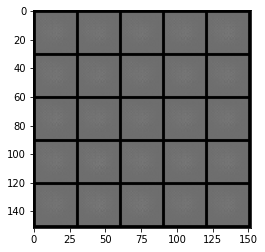

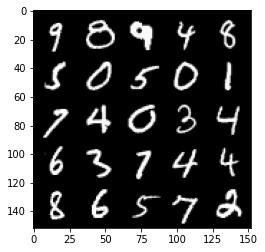

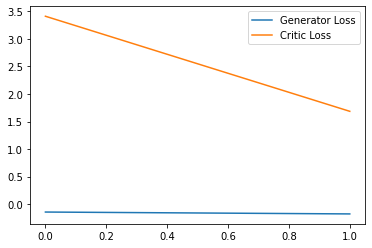

Step 100: Generator loss: 0.9465994654595852, critic loss: -1.8902738585174086


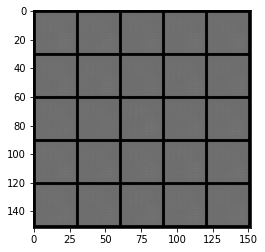

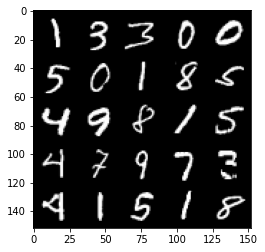

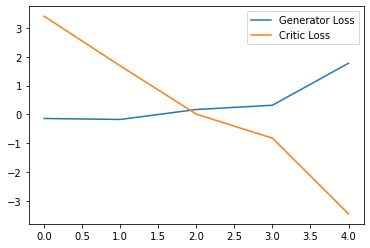

Step 150: Generator loss: 2.377107930183411, critic loss: -10.287616992950438


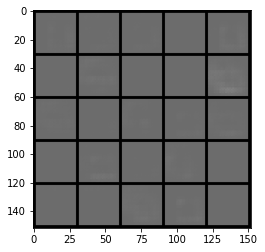

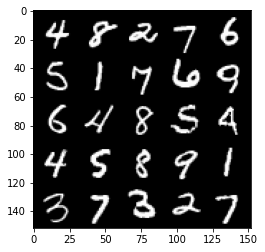

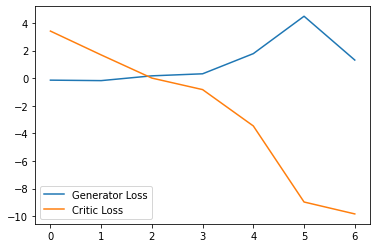

Step 200: Generator loss: -0.14059191361069678, critic loss: -27.360050727844236


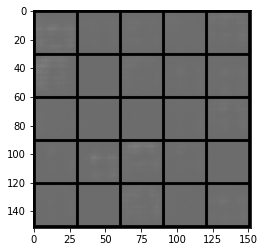

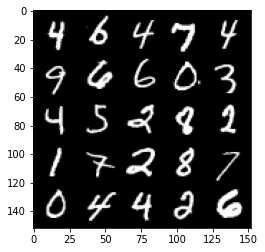

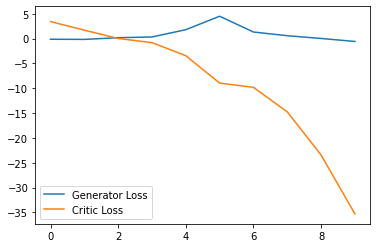

Step 250: Generator loss: -1.7855049577355384, critic loss: -60.565507476806644


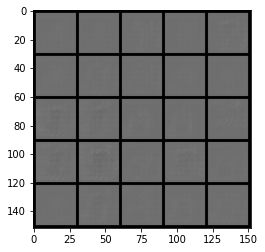

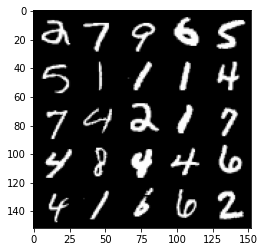

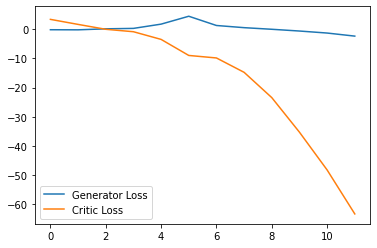

Step 300: Generator loss: -0.064089839681983, critic loss: -105.60208450317381


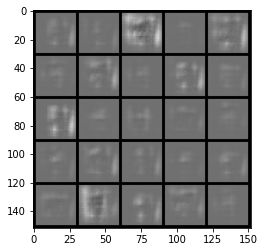

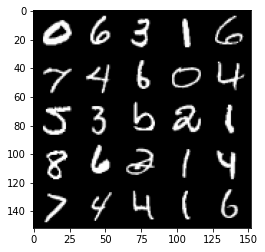

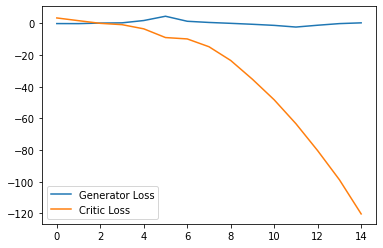

Step 350: Generator loss: -0.08545664548873902, critic loss: -144.80866894531246


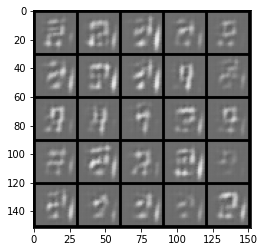

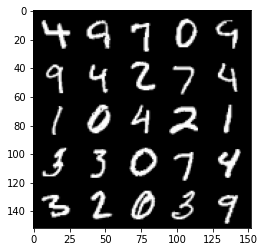

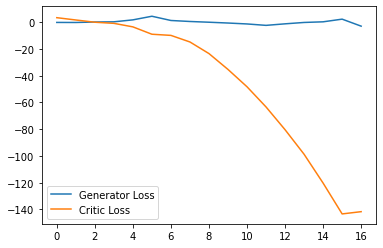

Step 400: Generator loss: -6.059450694322586, critic loss: -149.34763420104983


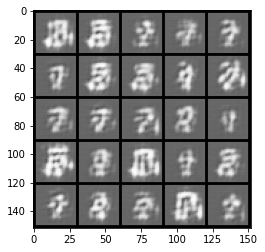

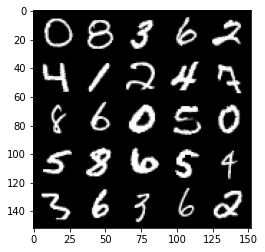

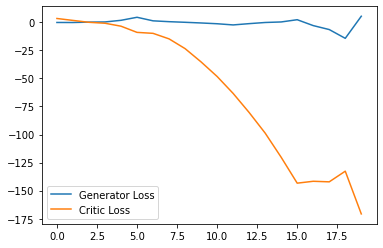

Step 450: Generator loss: 0.0430752170085907, critic loss: -224.46147506713868


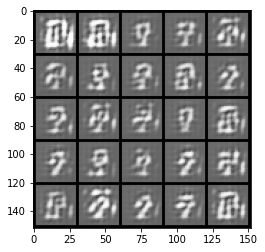

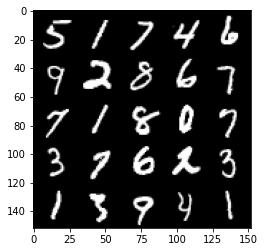

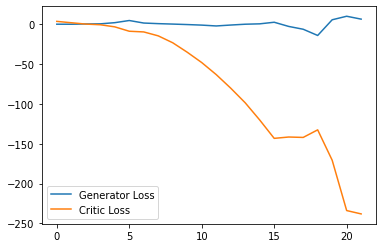

Step 500: Generator loss: -3.750560147166252, critic loss: -192.61523133850093


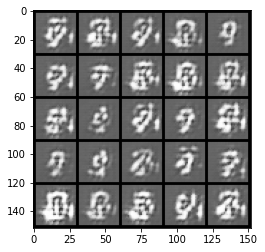

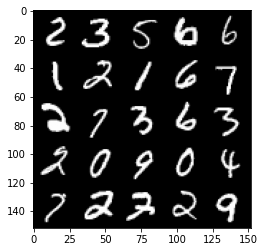

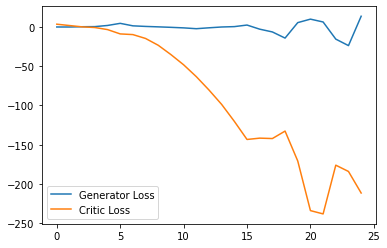

Step 550: Generator loss: 14.222893138527871, critic loss: -245.21519998168952


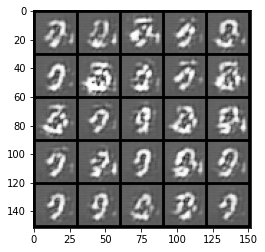

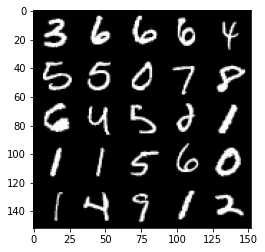

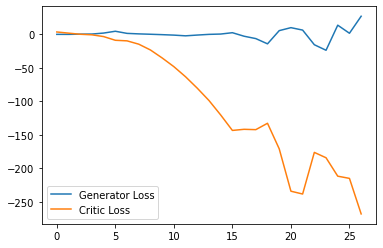

Step 600: Generator loss: 16.225463523864747, critic loss: -267.92932983398435


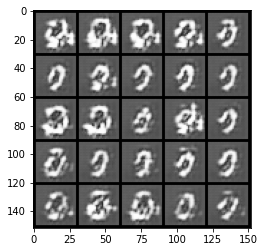

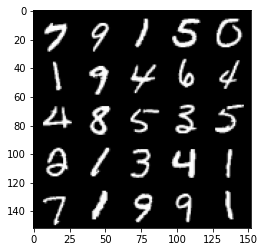

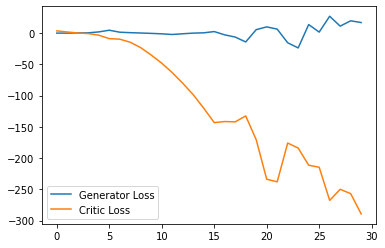

Step 650: Generator loss: 8.902361402511596, critic loss: -287.5795536193848


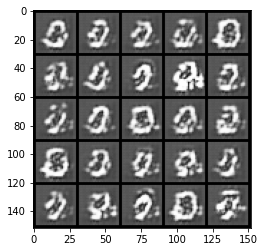

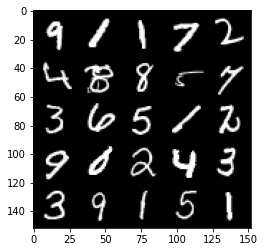

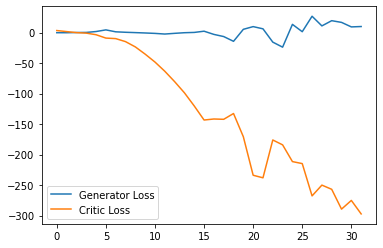

Step 700: Generator loss: -4.507273598909378, critic loss: -250.67123794555664


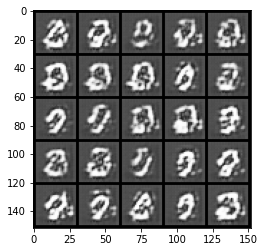

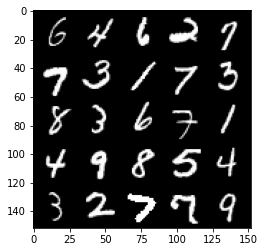

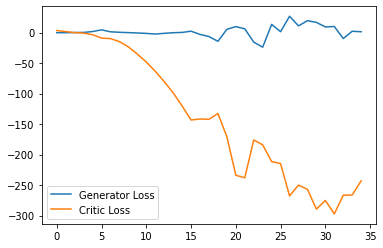

Step 750: Generator loss: -8.284951395988465, critic loss: -220.55215547180174


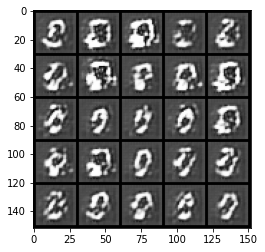

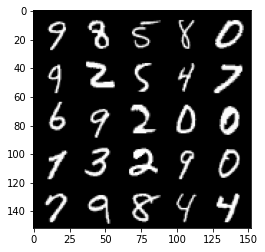

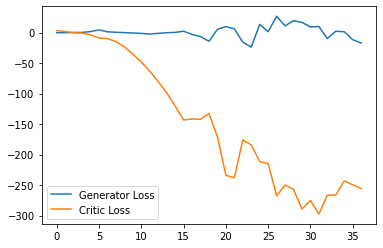

Step 800: Generator loss: -29.22455353319645, critic loss: -214.32651907348622


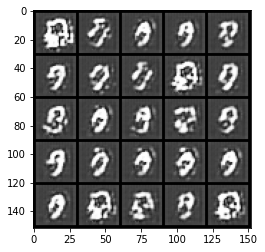

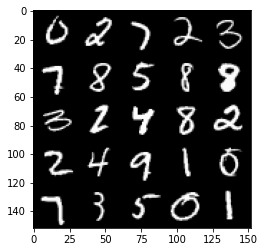

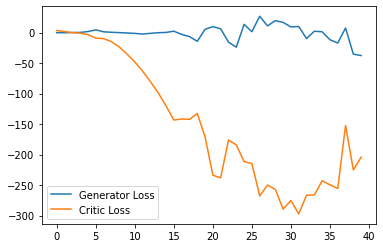

Step 850: Generator loss: -14.247719974517823, critic loss: -158.20097374725344


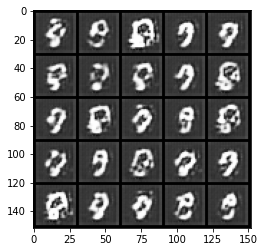

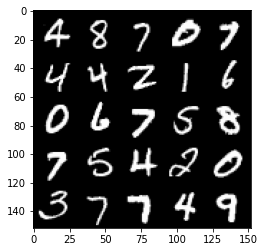

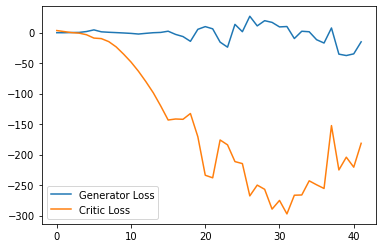

Step 900: Generator loss: -23.484074152112008, critic loss: -123.16799821472166


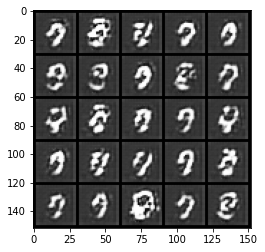

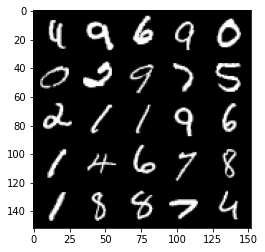

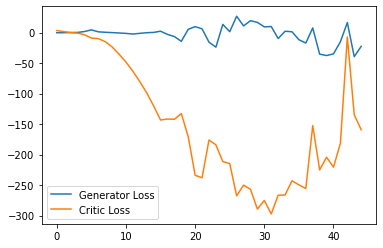

Step 950: Generator loss: -8.899337093234061, critic loss: -67.7207572250366


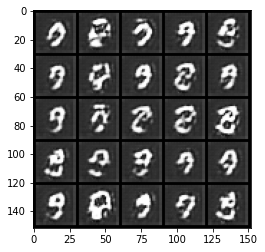

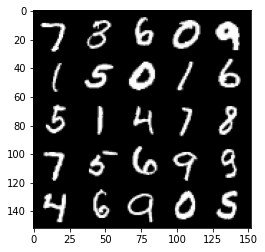

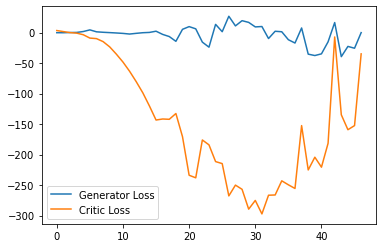

Step 1000: Generator loss: -3.4006980669498446, critic loss: -49.03422999572753


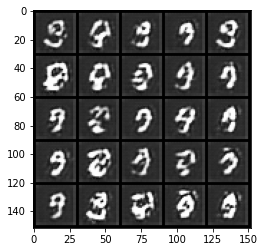

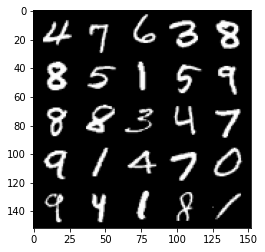

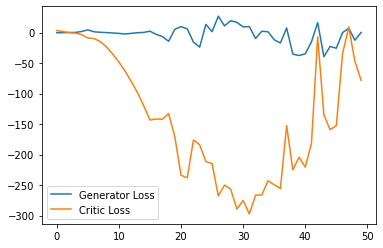

Step 1050: Generator loss: -26.546214470863344, critic loss: -63.69431628799437


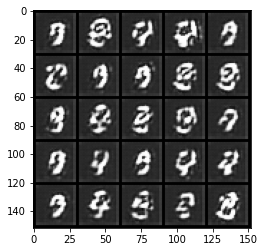

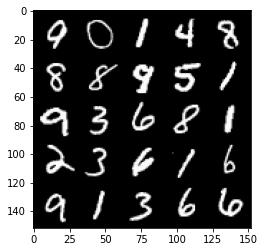

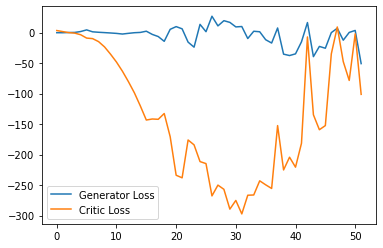

Step 1100: Generator loss: -9.625681247711181, critic loss: 0.4639015979766796


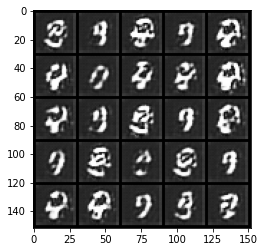

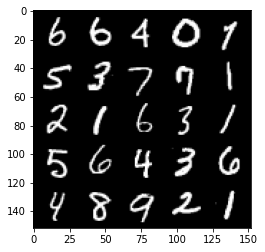

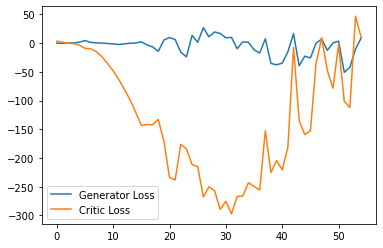

Step 1150: Generator loss: 9.081620216369629, critic loss: 9.481630651474001


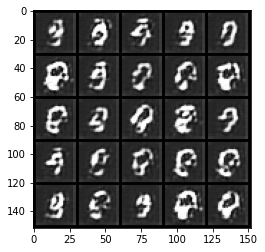

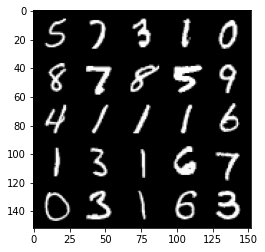

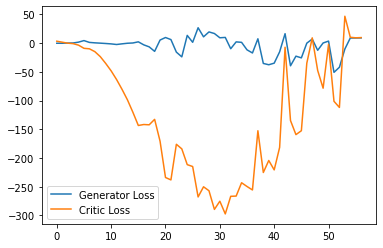

Step 1200: Generator loss: 8.733851051330566, critic loss: 6.4960768699646


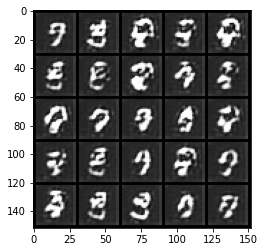

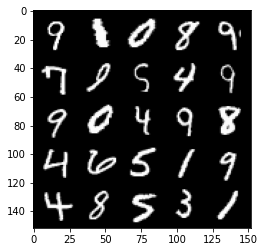

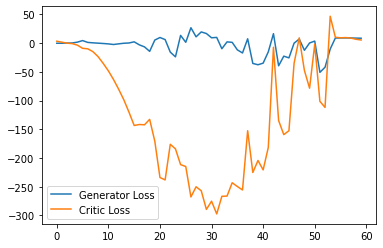

Step 1250: Generator loss: 8.138893222808838, critic loss: 3.581536802291871


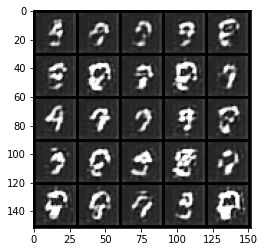

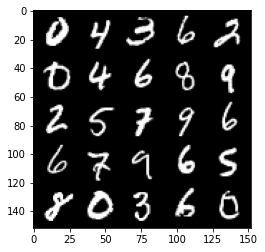

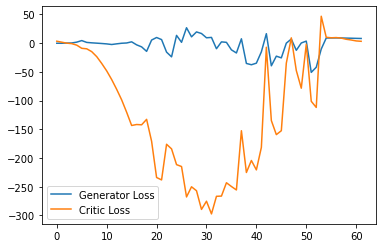

Step 1300: Generator loss: 6.541080265045166, critic loss: 5.307735754966735


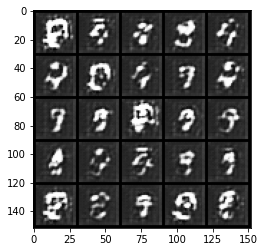

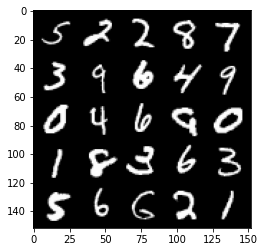

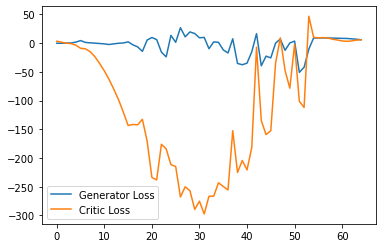

Step 1350: Generator loss: 4.3167686986923215, critic loss: 5.034013032913209


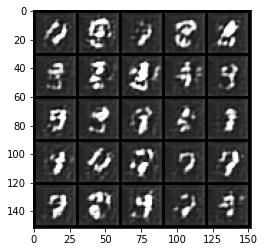

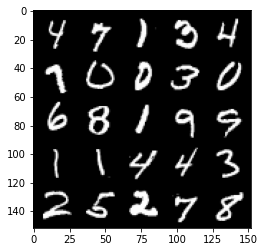

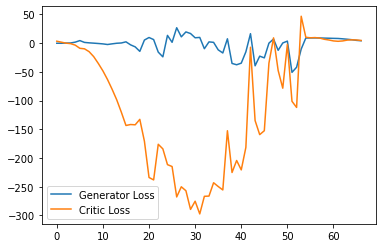

Step 1400: Generator loss: 2.4141014504432676, critic loss: 5.373960404396058


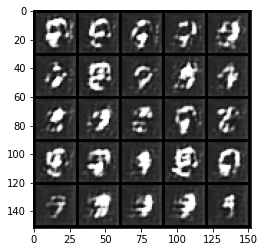

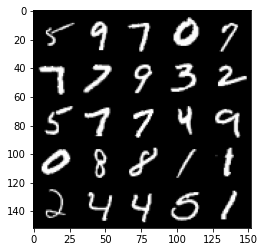

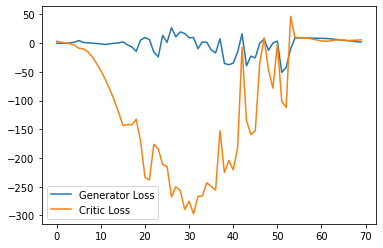

Step 1450: Generator loss: 0.4689255803078413, critic loss: 8.251861899375914


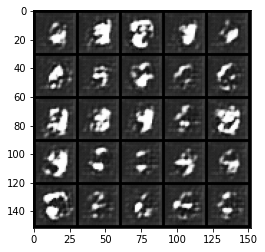

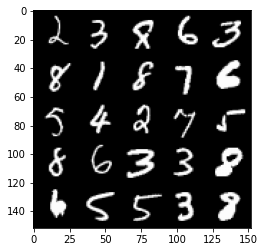

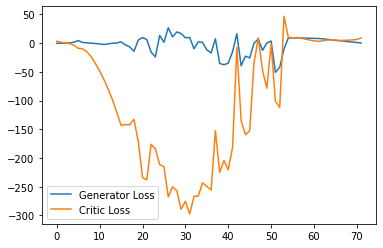

Step 1500: Generator loss: -2.7752510118484497, critic loss: 15.878715440750122


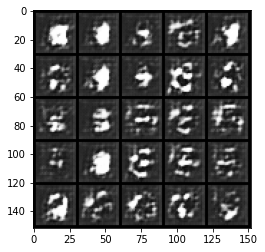

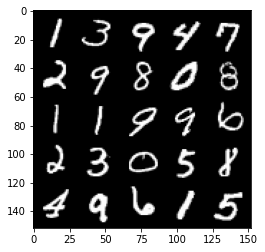

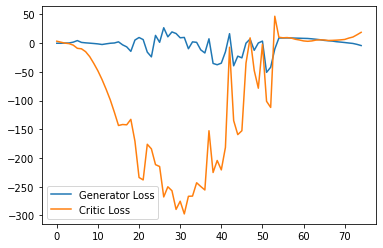

Step 1550: Generator loss: -7.903834981918335, critic loss: 19.285640735626224


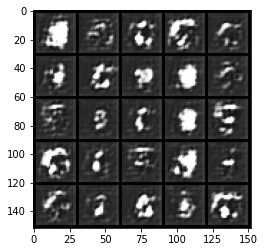

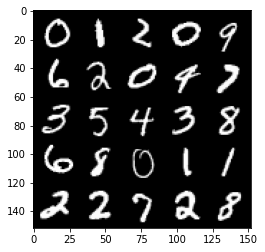

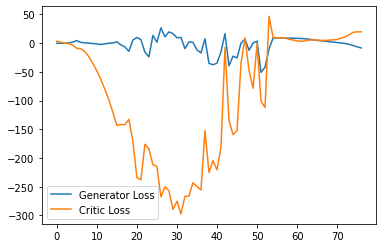

Step 1600: Generator loss: -12.099733200073242, critic loss: 14.795350051879888


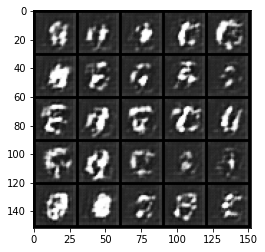

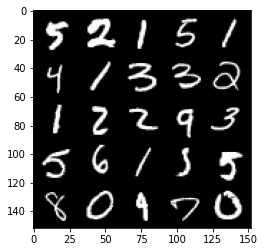

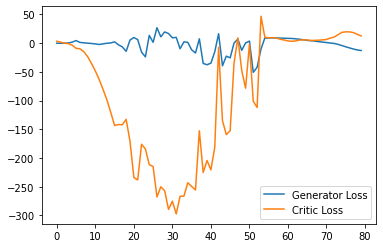

Step 1650: Generator loss: -13.781626071929931, critic loss: 8.605553342819215


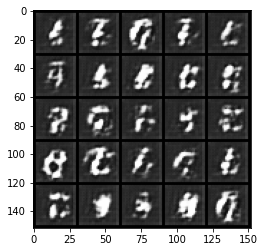

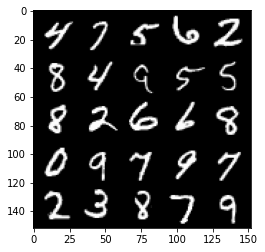

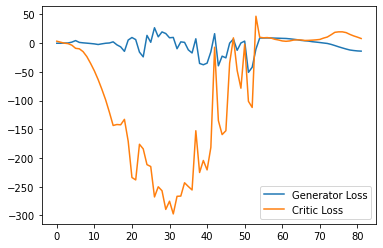

Step 1700: Generator loss: -14.220029926300048, critic loss: 4.050540374755858


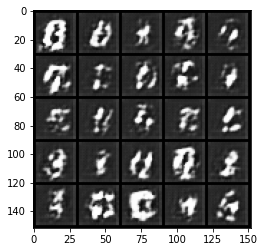

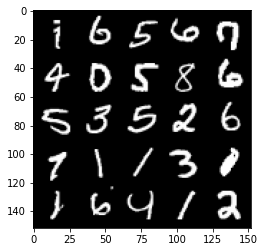

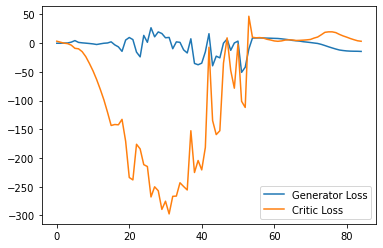

Step 1750: Generator loss: -14.714607620239258, critic loss: 1.0885376811027525


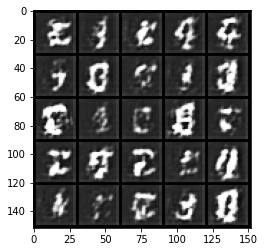

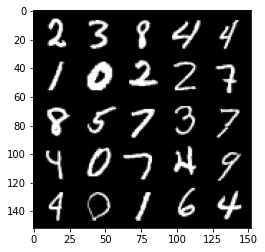

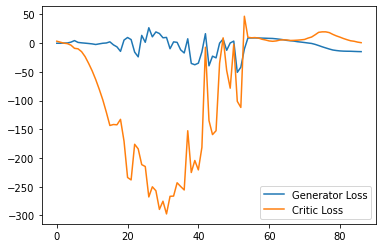

Step 1800: Generator loss: -14.4392364692688, critic loss: -0.315804374217987


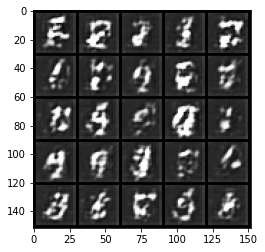

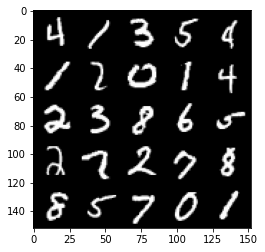

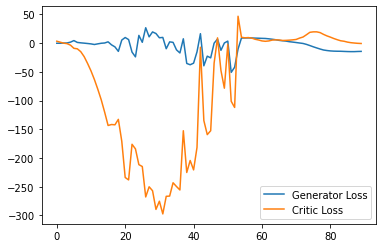

Step 1850: Generator loss: -13.981854152679443, critic loss: -1.0151948242187503


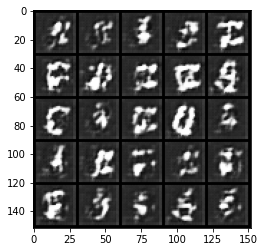

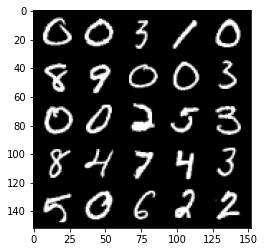

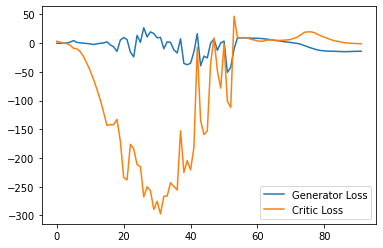

Step 1900: Generator loss: -13.522406349182129, critic loss: -1.5046026005744935


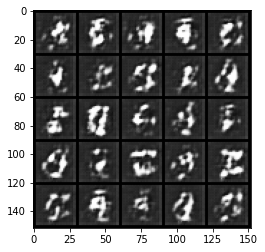

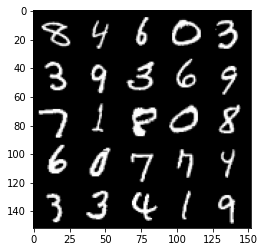

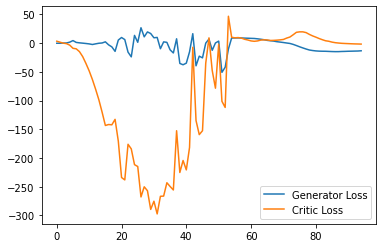

Step 1950: Generator loss: -12.614105434417725, critic loss: -1.813816213607788


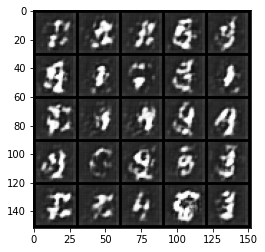

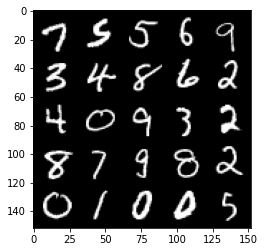

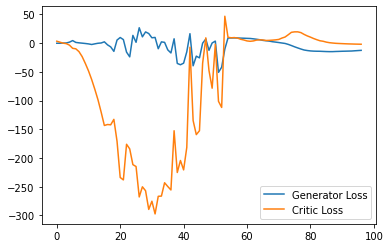

Step 2000: Generator loss: -11.717243995666504, critic loss: -1.7180446176528932


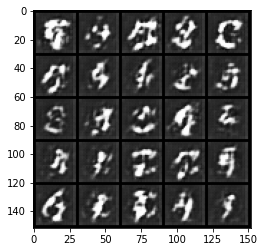

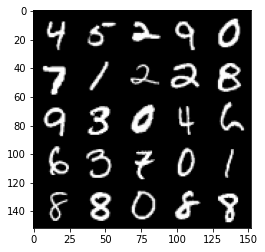

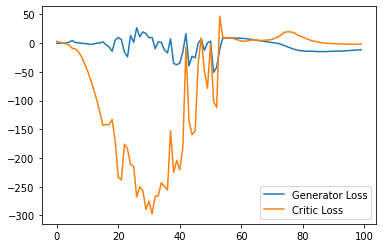

Step 2050: Generator loss: -10.698225269317627, critic loss: -1.4694270372390748


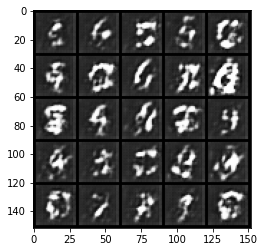

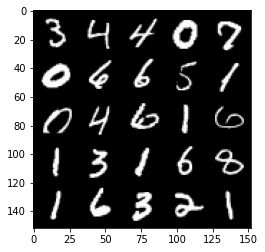

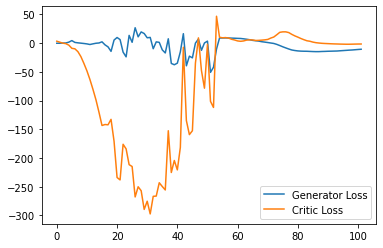

Step 2100: Generator loss: -9.526954917907714, critic loss: -1.6564000124931337


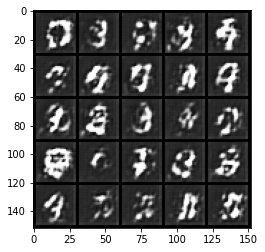

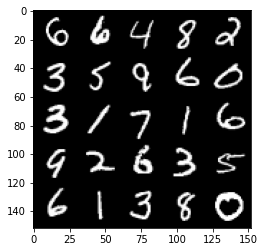

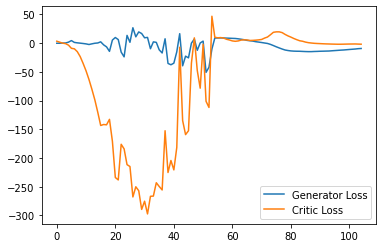

Step 2150: Generator loss: -8.881880407333375, critic loss: -2.2853032770156863


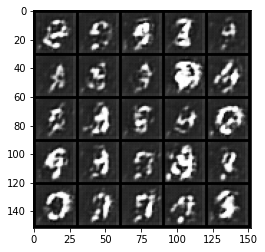

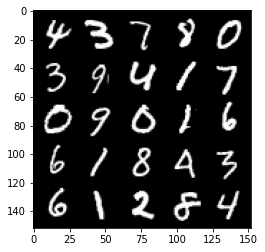

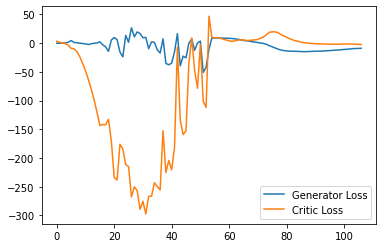

Step 2200: Generator loss: -8.029872207641601, critic loss: -3.043154582977295


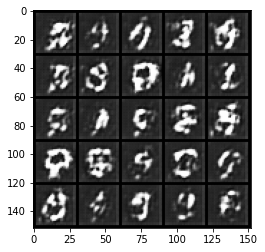

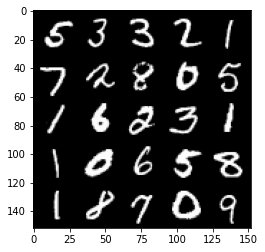

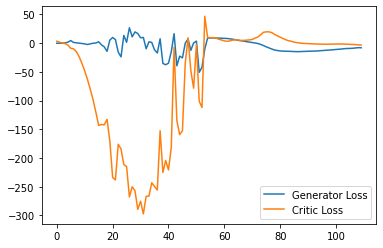

Step 2250: Generator loss: -8.130655164718627, critic loss: -4.845826491355897


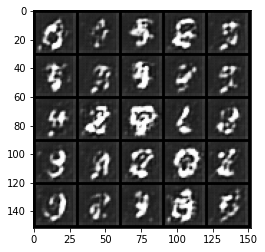

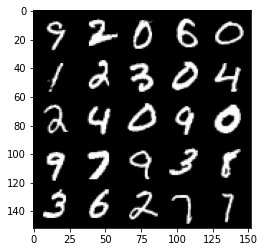

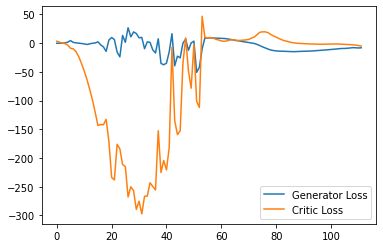

Step 2300: Generator loss: -8.215746936798096, critic loss: -6.9533929786682105


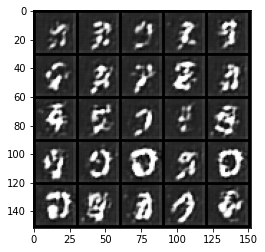

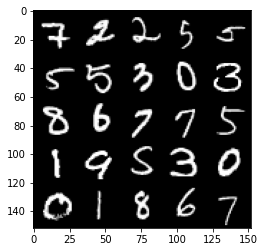

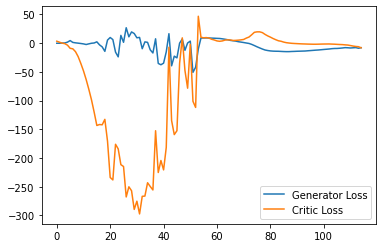

Step 2350: Generator loss: -6.687497692108154, critic loss: -9.815821081161502


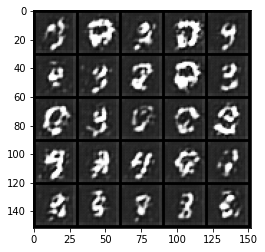

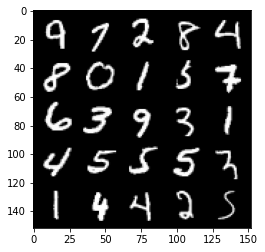

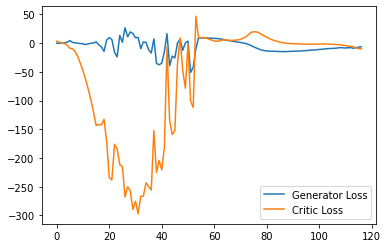

Step 2400: Generator loss: -7.16110506221652, critic loss: -13.242937133789065


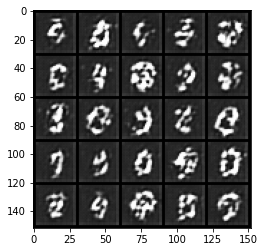

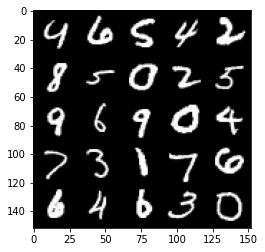

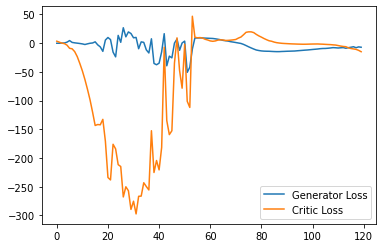

Step 2450: Generator loss: -5.455399453938007, critic loss: -15.05909129142761


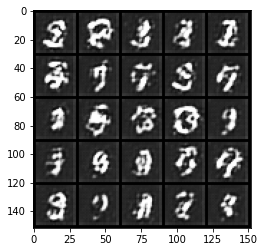

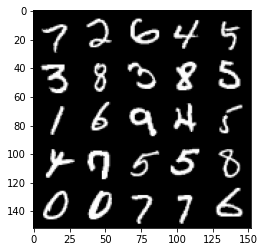

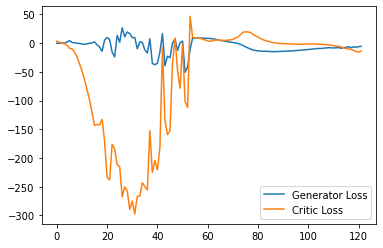

Step 2500: Generator loss: -4.4170502972602845, critic loss: -16.28460510253906


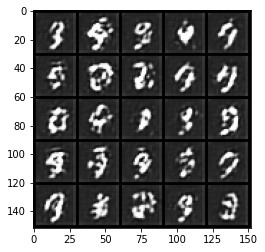

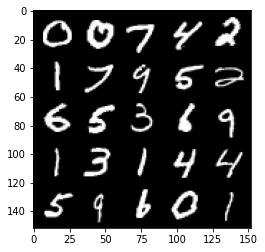

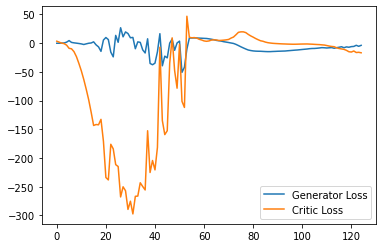

Step 2550: Generator loss: -5.727769767045975, critic loss: -16.90078029060364


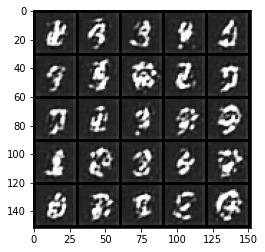

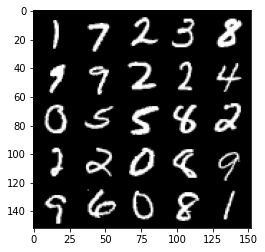

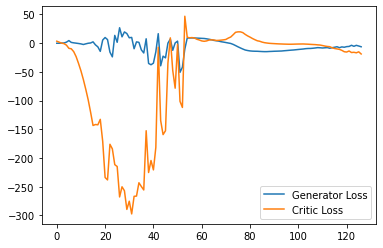

Step 2600: Generator loss: -5.289181781411171, critic loss: -20.738959623336786


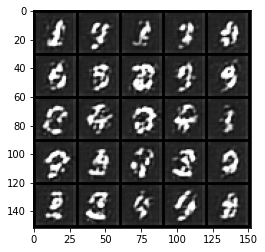

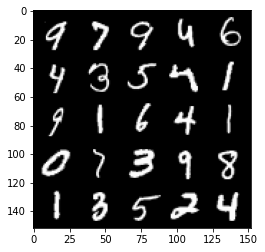

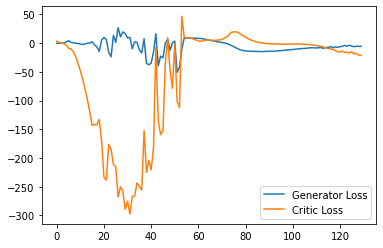

Step 2650: Generator loss: -5.270369925498962, critic loss: -19.90767381668091


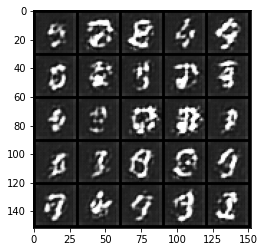

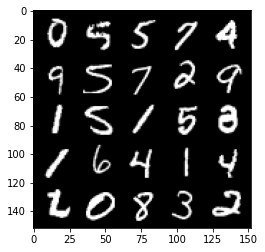

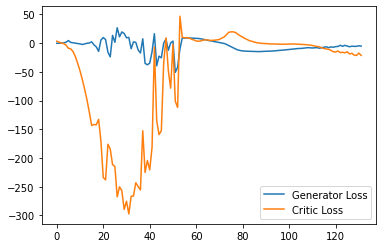

Step 2700: Generator loss: -5.3601244604587555, critic loss: -23.364858207702635


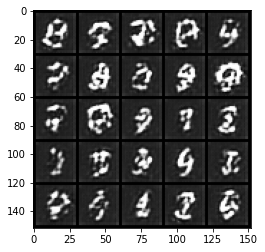

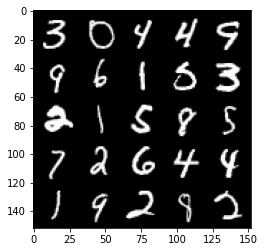

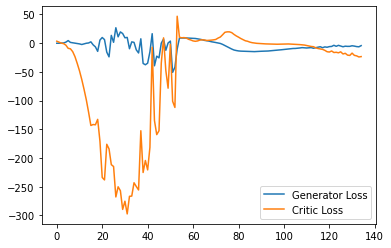

Step 2750: Generator loss: -2.6501855221390724, critic loss: -23.643347946167


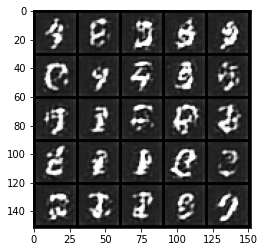

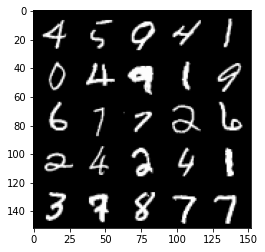

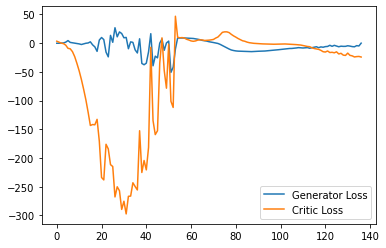

Step 2800: Generator loss: -2.216014356315136, critic loss: -23.126128479003906


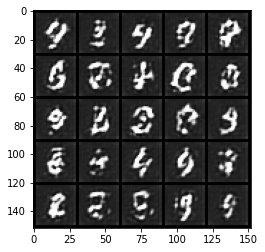

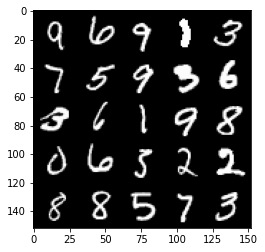

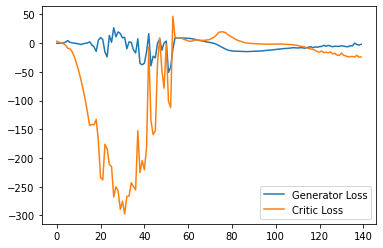

Step 2850: Generator loss: -1.2620844984054564, critic loss: -23.908394908905034


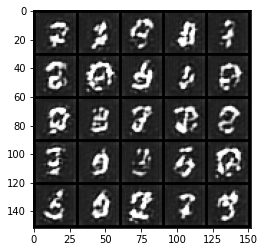

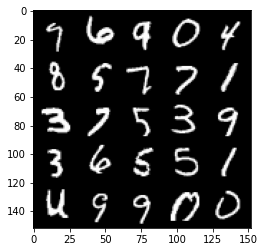

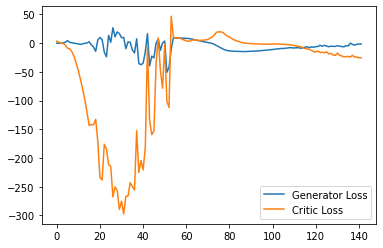

Step 2900: Generator loss: -2.4200864493846894, critic loss: -26.183760961532588


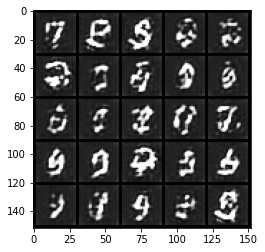

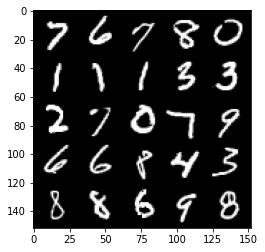

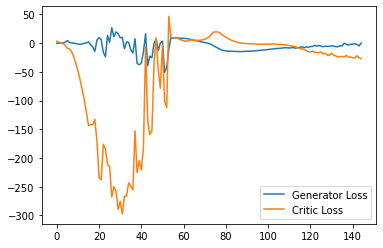

Step 2950: Generator loss: 2.8149057956039907, critic loss: -13.370613638877867


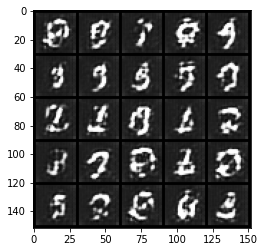

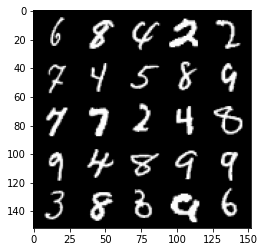

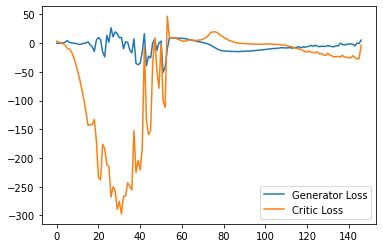

Step 3000: Generator loss: -2.2819896829128266, critic loss: -24.3748738899231


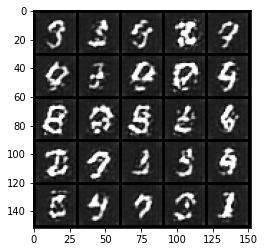

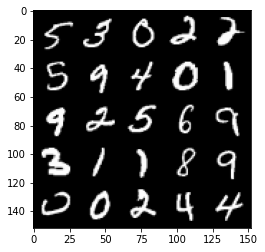

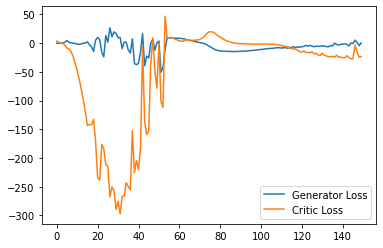

Step 3050: Generator loss: -1.5909792274236678, critic loss: -25.9891697845459


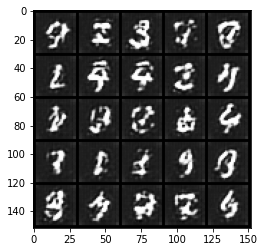

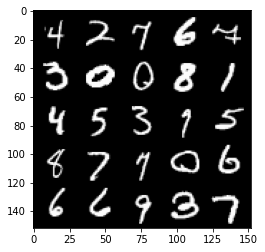

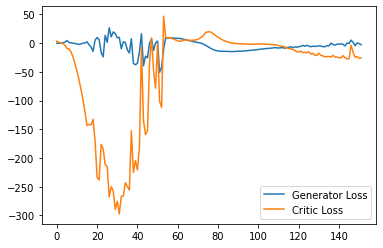

Step 3100: Generator loss: -0.30695110619068144, critic loss: -27.218526641845703


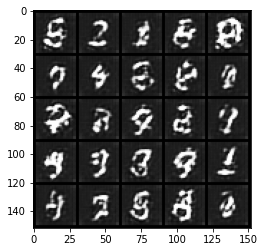

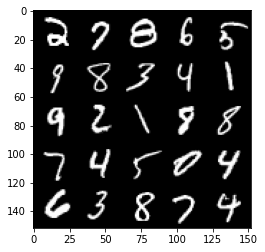

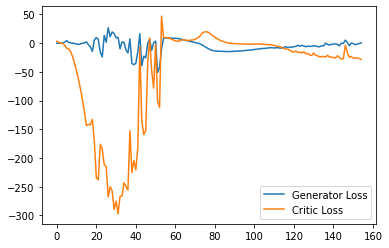

Step 3150: Generator loss: 0.024423485994338988, critic loss: -26.243155853271475


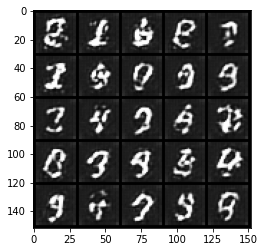

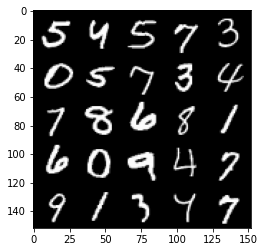

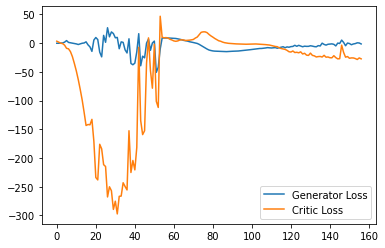

Step 3200: Generator loss: 0.959381846189499, critic loss: -20.19671101093292


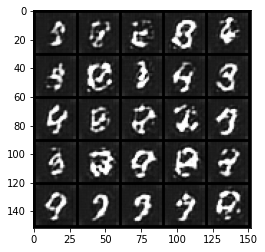

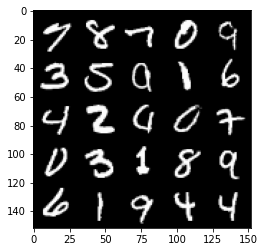

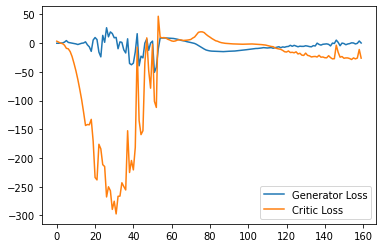

Step 3250: Generator loss: 2.3029061076045036, critic loss: -21.855232564926144


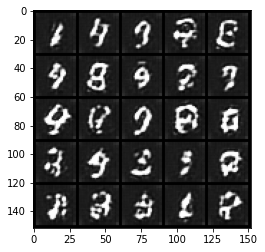

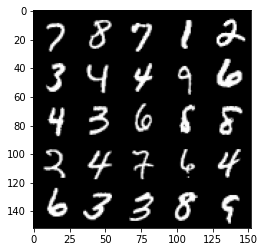

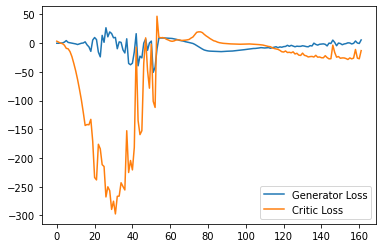

Step 3300: Generator loss: 8.102077379226685, critic loss: -1.0169957890510561


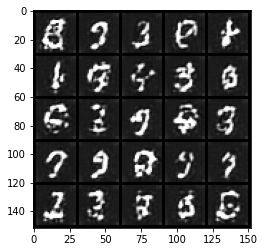

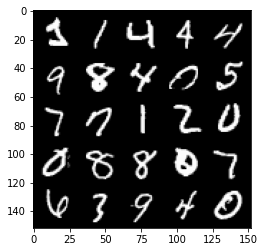

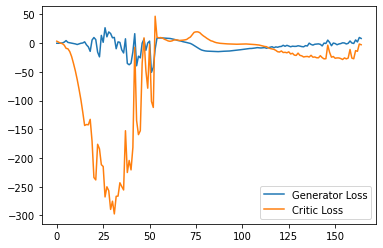

Step 3350: Generator loss: 5.811031923294068, critic loss: -2.6782981767654417


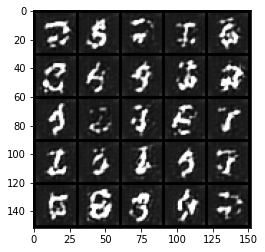

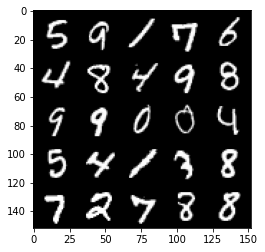

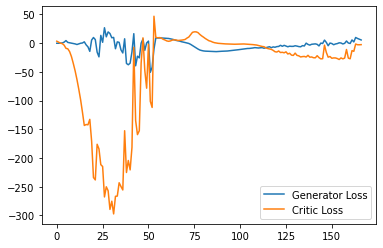

Step 3400: Generator loss: 0.42978150248527525, critic loss: -11.266142523765563


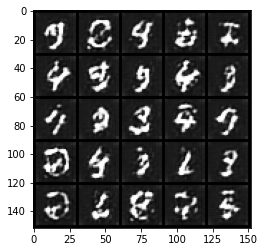

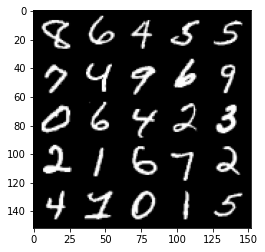

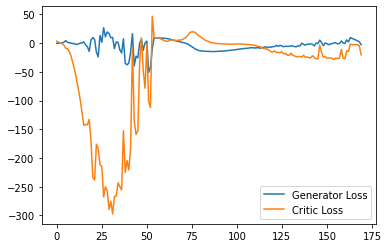

Step 3450: Generator loss: -3.3017415809631347, critic loss: -23.359738077163694


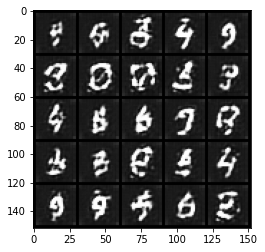

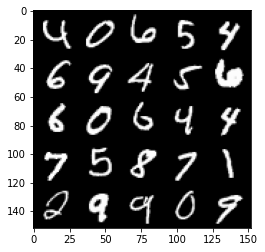

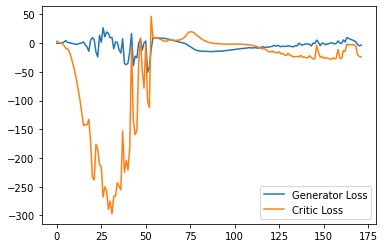

Step 3500: Generator loss: -0.7277688494324684, critic loss: -22.431581953048703


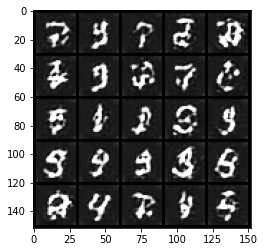

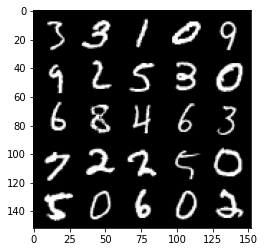

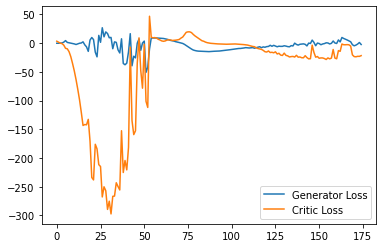

Step 3550: Generator loss: 3.8587214612960814, critic loss: -20.08959943389892


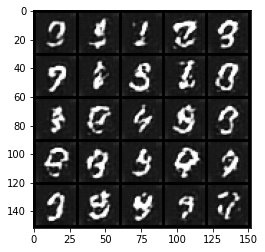

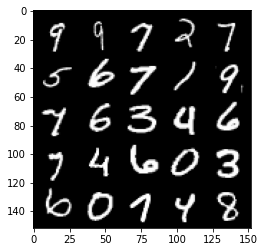

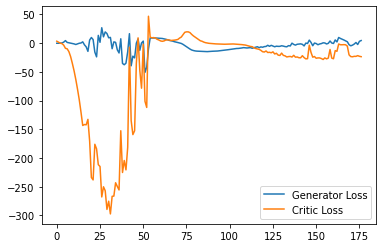

Step 3600: Generator loss: 0.9315708100795745, critic loss: -22.39295010185242


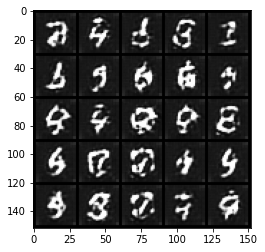

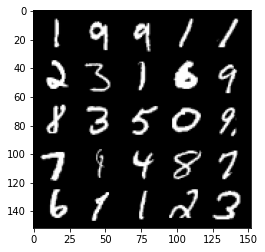

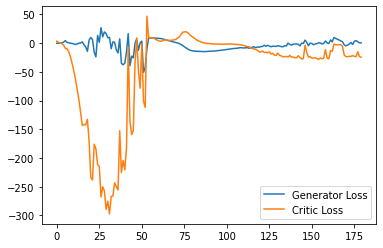

Step 3650: Generator loss: 7.063968121409416, critic loss: -17.048961671829222


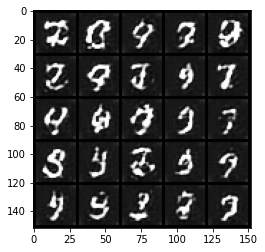

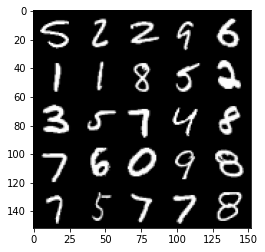

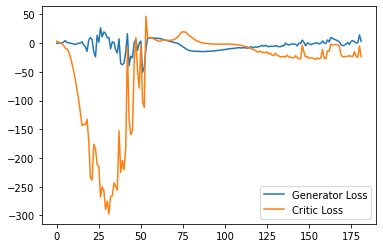

Step 3700: Generator loss: 2.6294131368398665, critic loss: -22.8994266357422


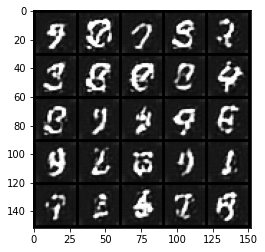

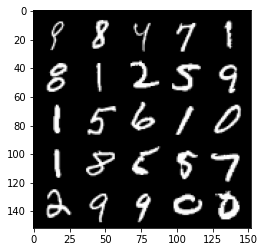

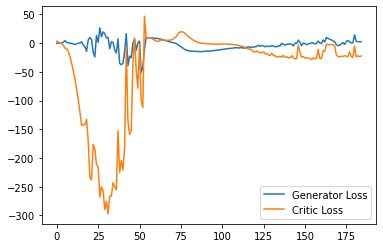

Step 3750: Generator loss: 6.355713458061218, critic loss: -17.712320871353153


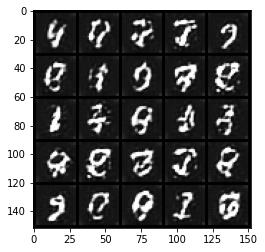

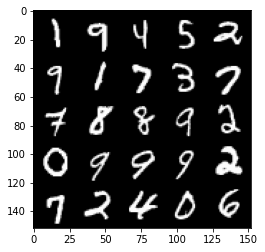

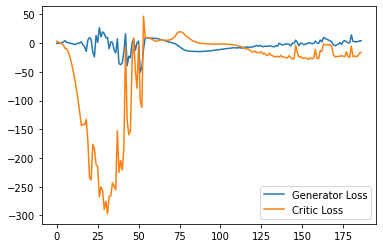

Step 3800: Generator loss: 5.0508625355362895, critic loss: -20.469258577346803


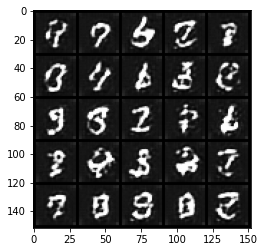

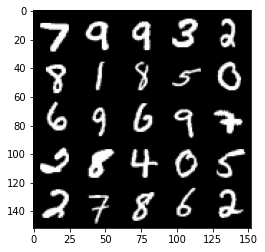

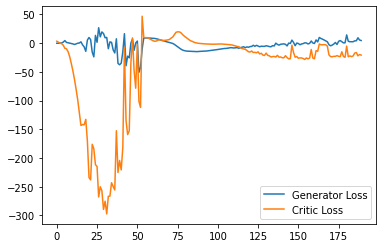

Step 3850: Generator loss: 4.060808254778385, critic loss: -19.832671636581424


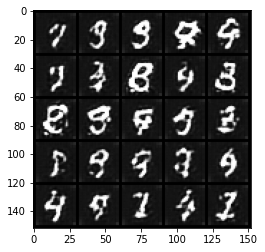

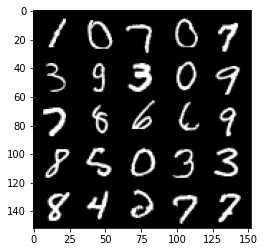

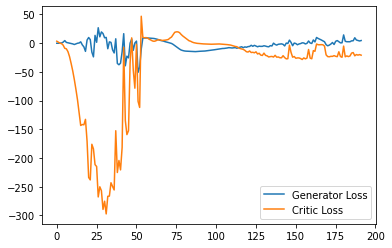

Step 3900: Generator loss: 5.1474404606223105, critic loss: -21.592779136657718


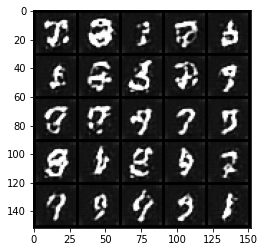

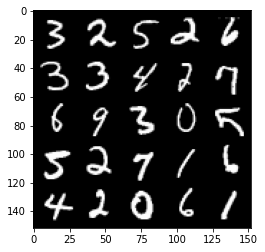

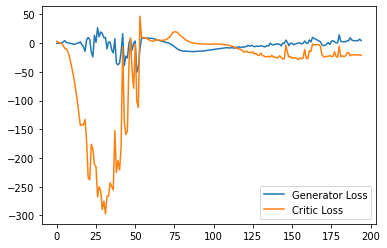

Step 3950: Generator loss: 6.160116326659918, critic loss: -19.32563369560242


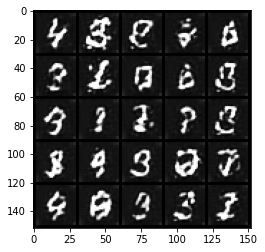

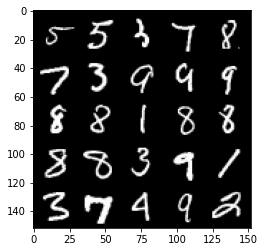

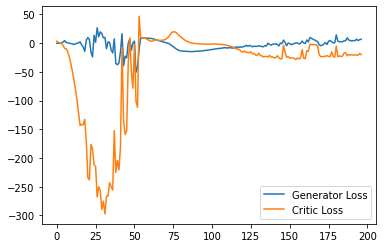

Step 4000: Generator loss: 7.486769617795944, critic loss: -19.81872154808044


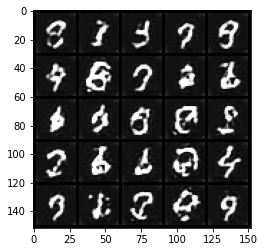

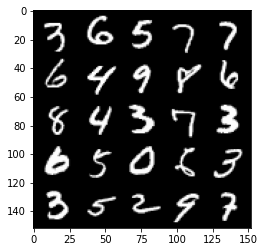

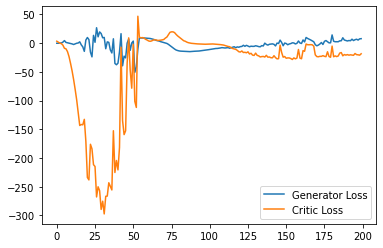

Step 4050: Generator loss: 5.498014279901981, critic loss: -21.526730936050413


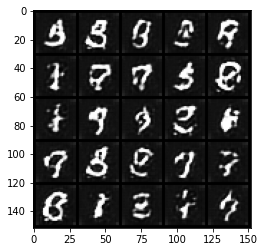

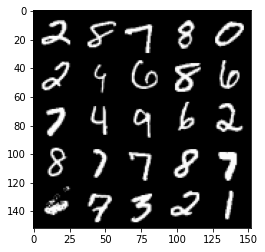

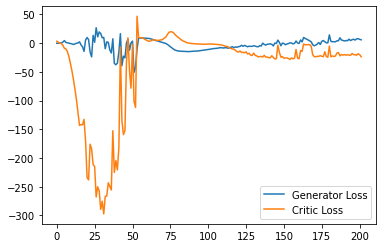

Step 4100: Generator loss: 9.186936692595483, critic loss: -14.250587748527527


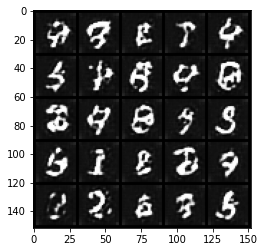

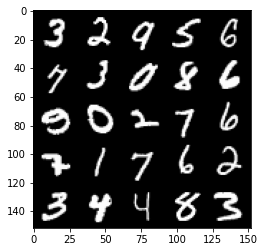

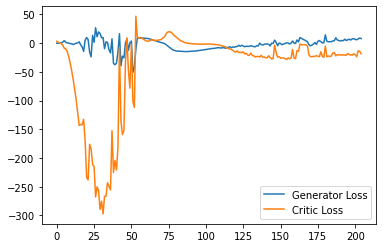

Step 4150: Generator loss: 8.125784861594438, critic loss: -18.13364277172089


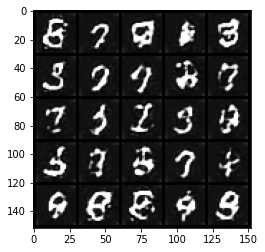

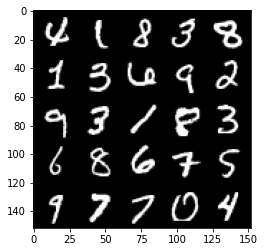

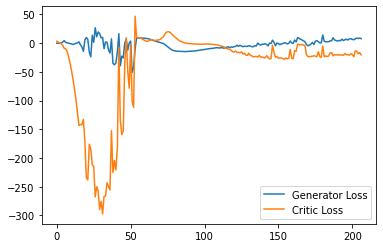

Step 4200: Generator loss: 12.191577141284943, critic loss: -11.58161420917511


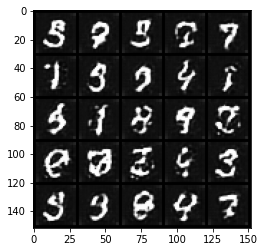

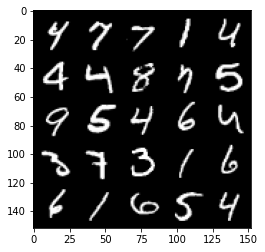

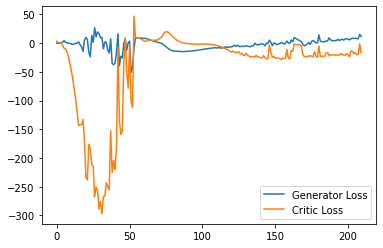

Step 4250: Generator loss: 11.267606992721557, critic loss: -8.680375186920166


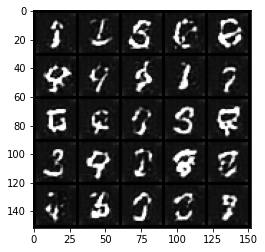

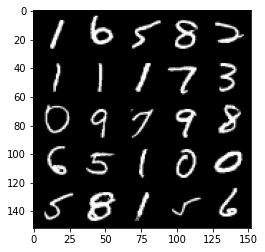

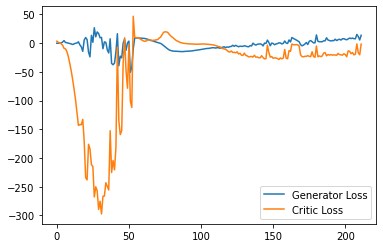

Step 4300: Generator loss: 12.127966537475587, critic loss: -2.2135852417945863


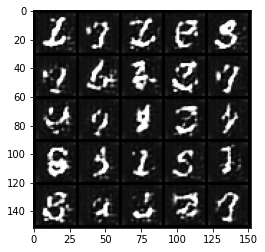

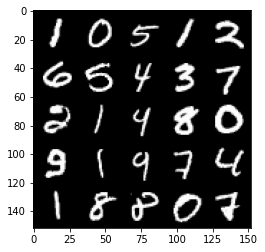

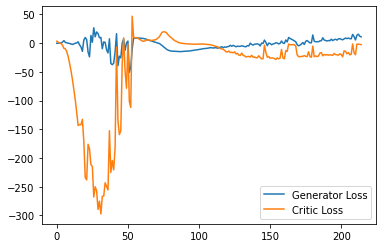

Step 4350: Generator loss: 10.145170469284057, critic loss: -3.9279769258499146


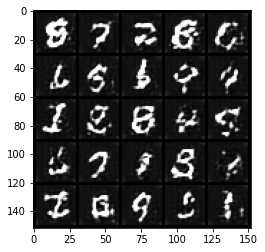

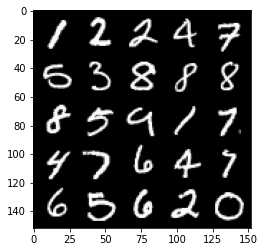

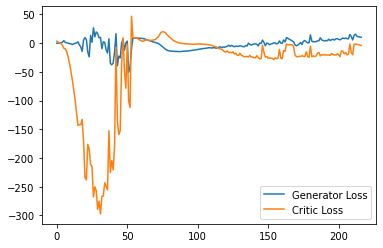

Step 4400: Generator loss: 3.95960992783308, critic loss: -18.98489700889587


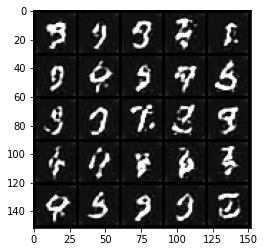

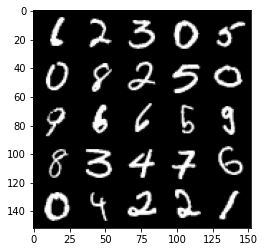

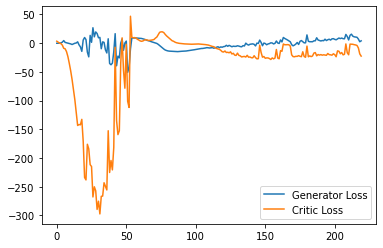

Step 4450: Generator loss: 3.6285995346307756, critic loss: -18.665737855911257


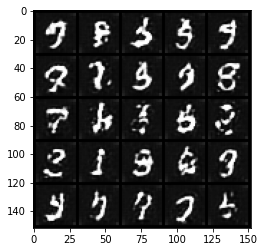

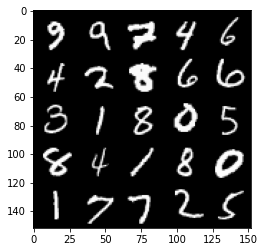

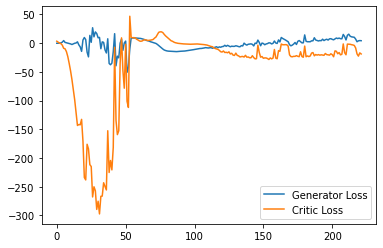

Step 4500: Generator loss: 6.826059105992317, critic loss: -17.63191863393784


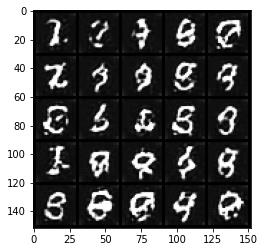

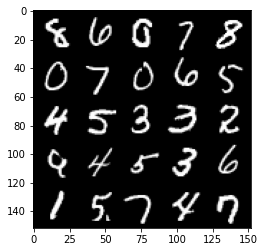

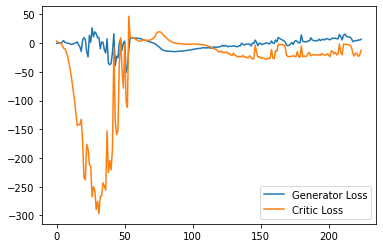

Step 4550: Generator loss: 16.488702507019042, critic loss: -4.171331512451172


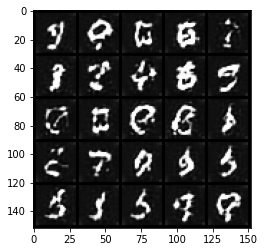

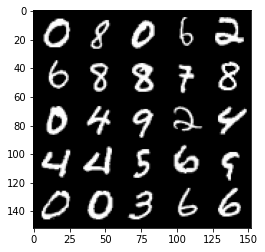

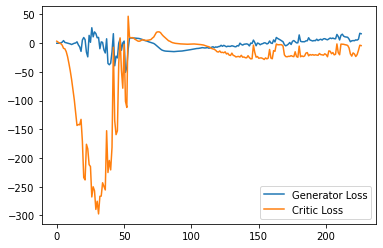

Step 4600: Generator loss: 7.344635917544365, critic loss: -16.040112407684322


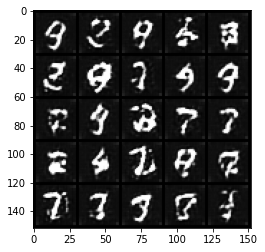

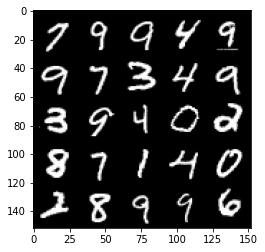

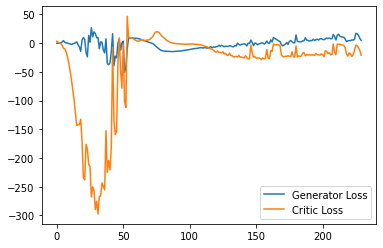

Step 4650: Generator loss: 10.106414959430694, critic loss: -8.969875452041624


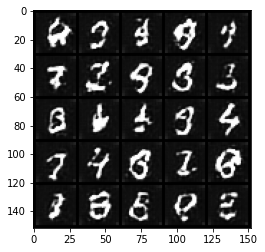

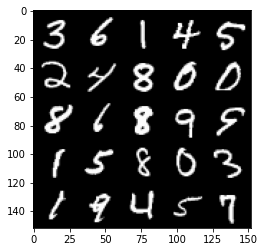

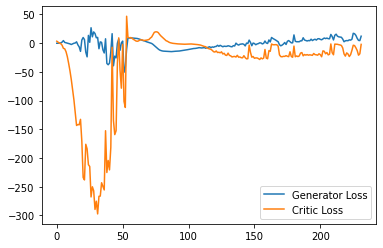

Step 4700: Generator loss: 8.985969289541245, critic loss: -10.383694666862489


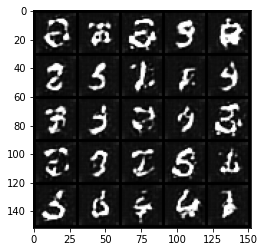

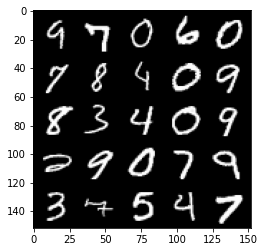

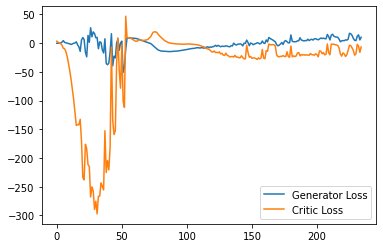

Step 4750: Generator loss: 4.926347317993641, critic loss: -19.650322320938116


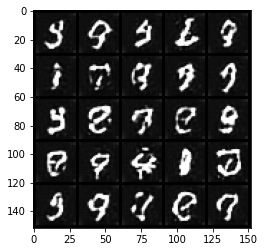

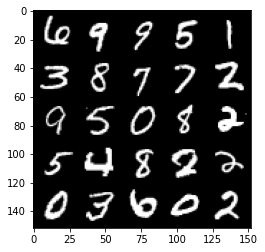

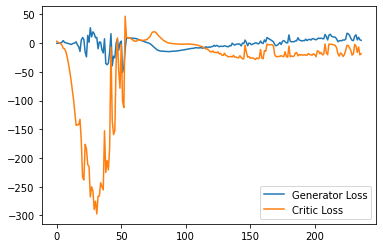

Step 4800: Generator loss: 5.82524021834135, critic loss: -19.90660315132141


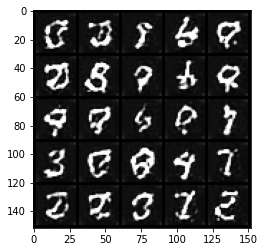

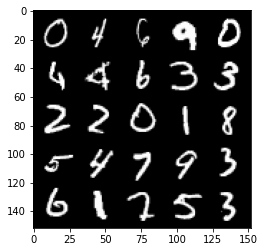

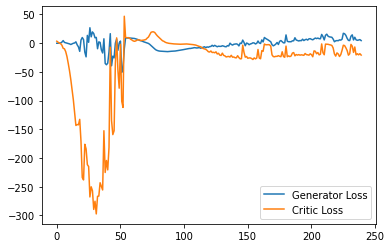

Step 4850: Generator loss: 9.68399276971817, critic loss: -10.072954141139986


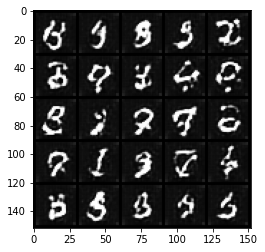

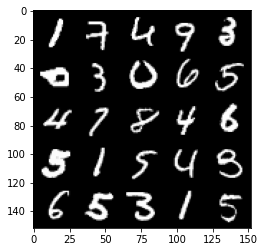

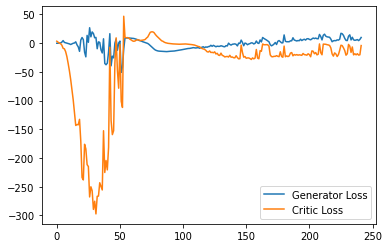

Step 4900: Generator loss: 13.520548074543477, critic loss: -8.027702809333801


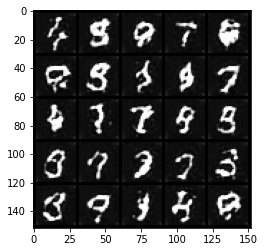

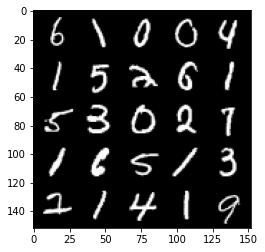

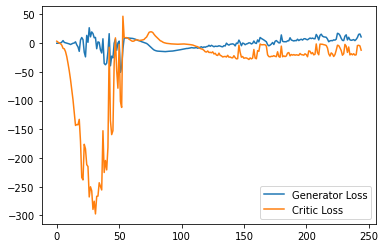

Step 4950: Generator loss: 4.492205764949322, critic loss: -22.503393977642062


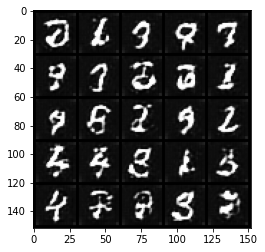

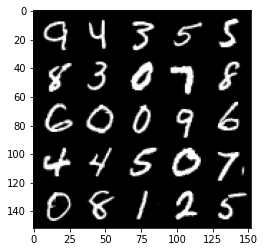

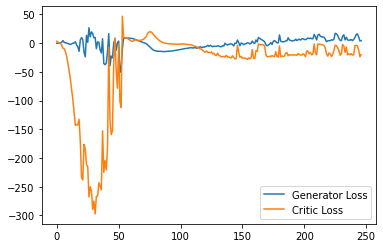

Step 5000: Generator loss: 9.475348671972752, critic loss: -7.119632497310638


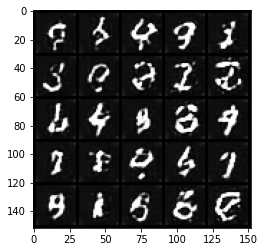

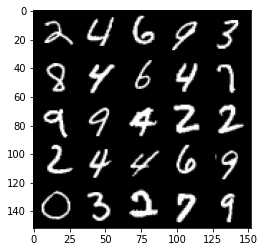

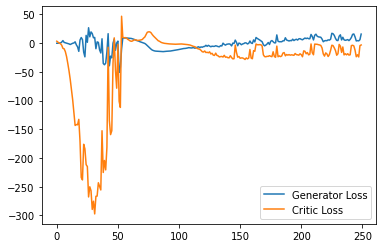

Step 5050: Generator loss: 14.156835708618164, critic loss: -3.567032161712646


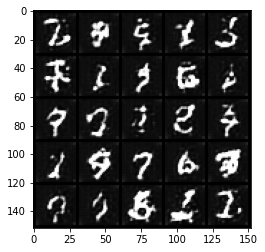

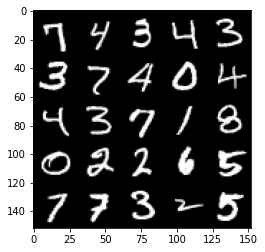

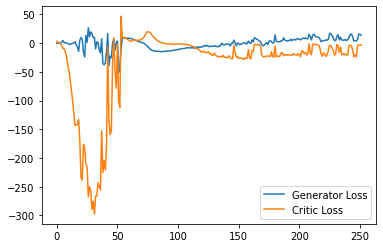

Step 5100: Generator loss: 6.543519031852484, critic loss: -9.159358783721924


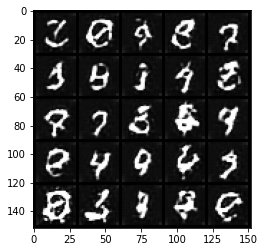

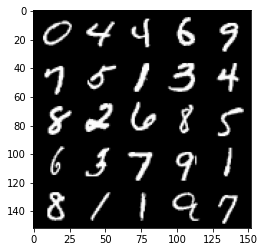

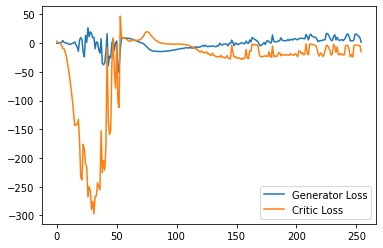

Step 5150: Generator loss: 4.70829528093338, critic loss: -15.29927116179466


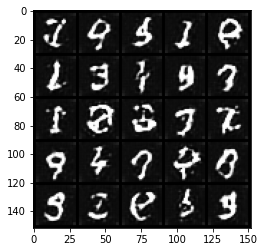

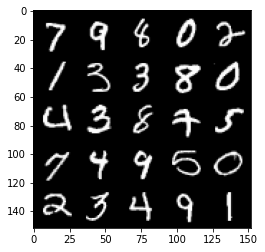

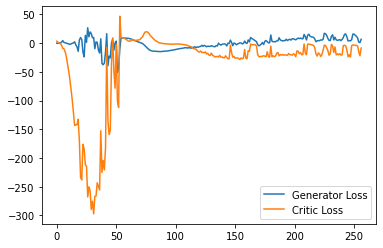

Step 5200: Generator loss: 6.889128128290176, critic loss: -12.270007444381715


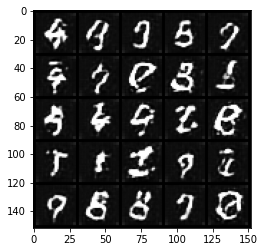

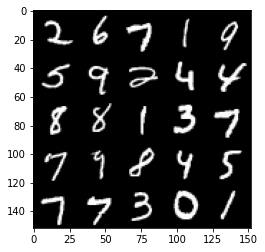

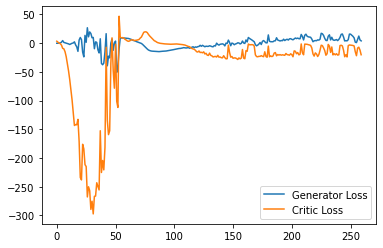

Step 5250: Generator loss: 4.0651513785123825, critic loss: -18.287689839363097


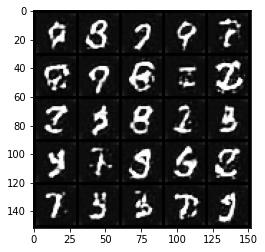

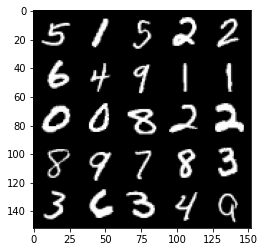

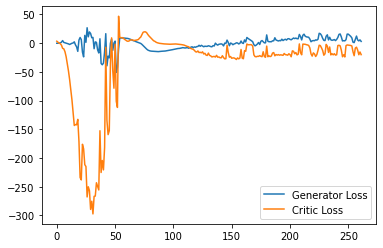

Step 5300: Generator loss: 3.254811525642872, critic loss: -17.177174630641943


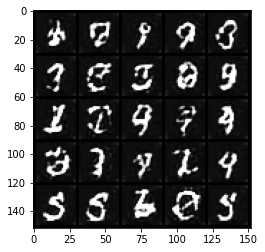

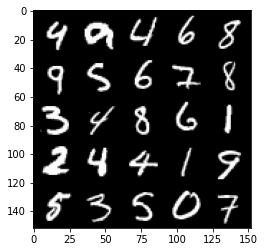

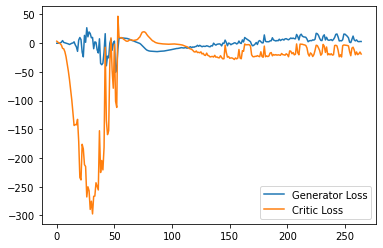

Step 5350: Generator loss: 4.826172875761986, critic loss: -20.65504045295716


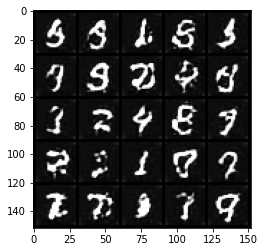

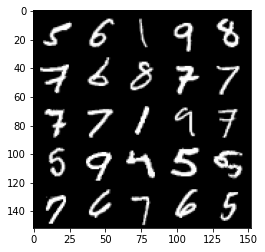

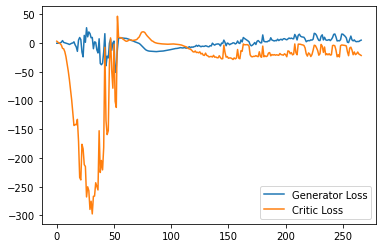

Step 5400: Generator loss: 5.31829629778862, critic loss: -18.20855724048615


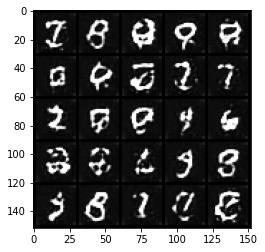

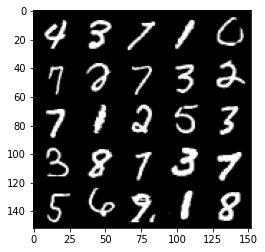

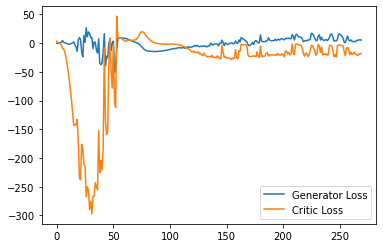

Step 5450: Generator loss: 7.701399122476578, critic loss: -10.20823231029511


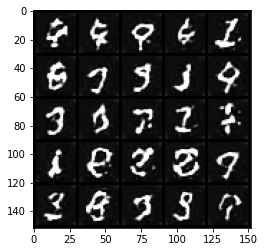

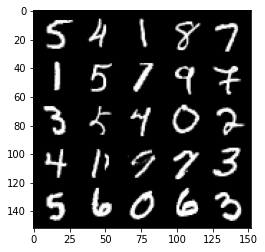

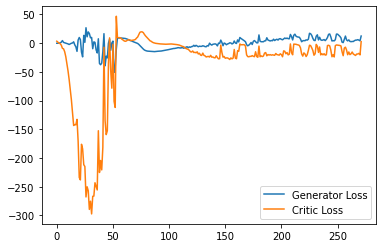

Step 5500: Generator loss: 4.992514954060316, critic loss: -19.62640280532837


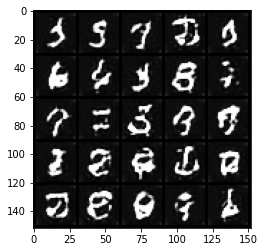

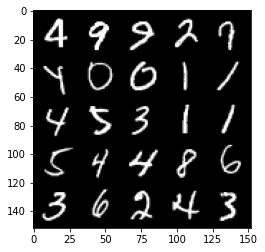

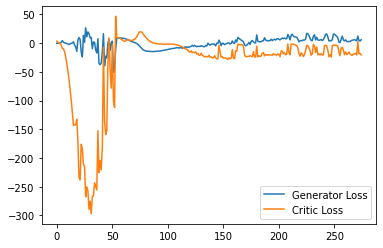

Step 5550: Generator loss: 4.098559414297342, critic loss: -19.586649995326994


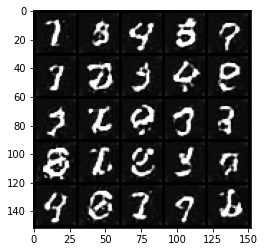

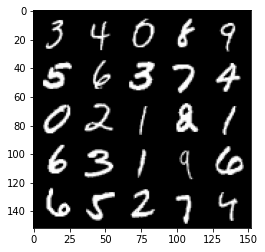

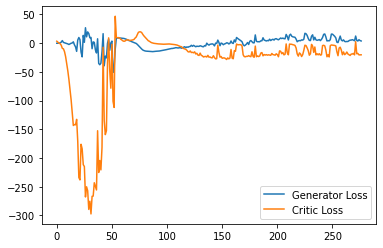

Step 5600: Generator loss: 4.334503972828388, critic loss: -20.86898565816879


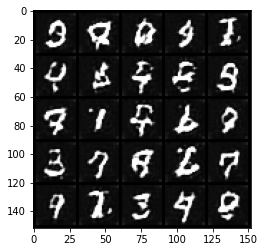

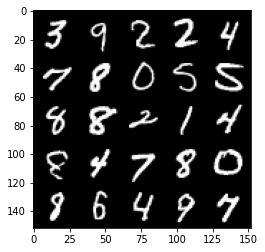

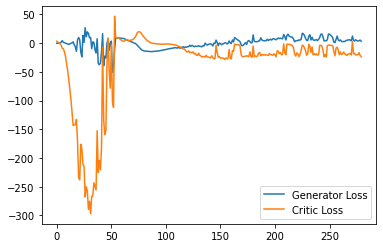

Step 5650: Generator loss: 5.745175314545631, critic loss: -15.079895799636835


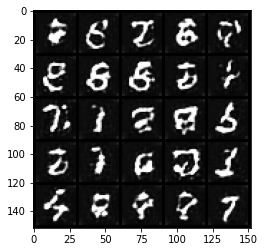

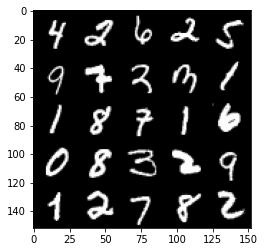

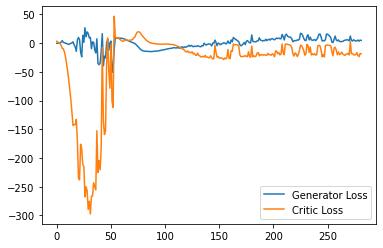

Step 5700: Generator loss: 10.26562491685152, critic loss: -11.439065727233885


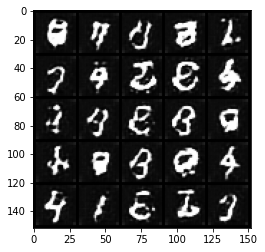

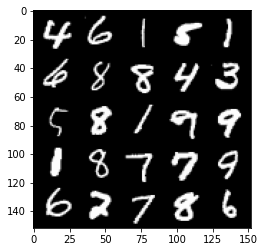

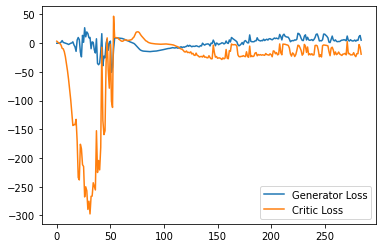

Step 5750: Generator loss: 3.591832781434059, critic loss: -21.42282008743286


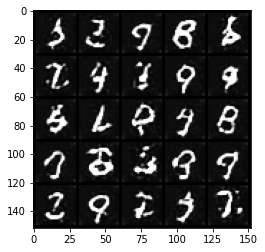

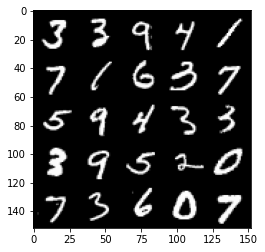

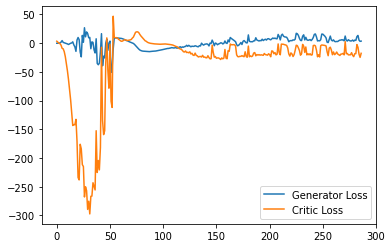

Step 5800: Generator loss: 6.1331272700428965, critic loss: -19.15213077735901


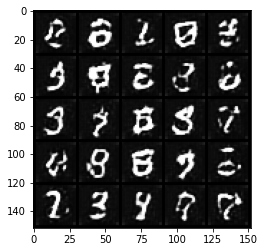

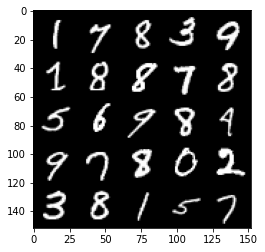

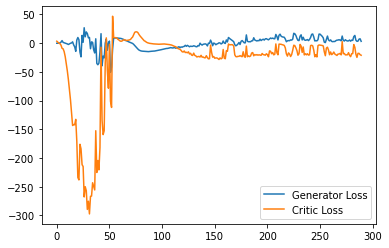

Step 5850: Generator loss: 3.615687138736248, critic loss: -19.339523248672485


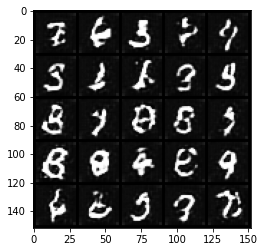

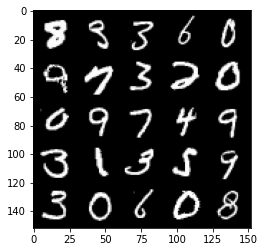

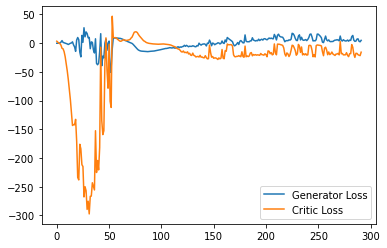

Step 5900: Generator loss: 5.478976148366928, critic loss: -20.311049560546877


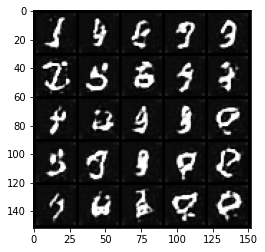

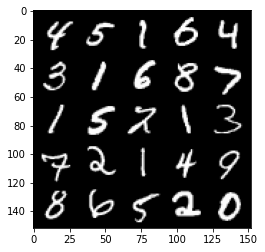

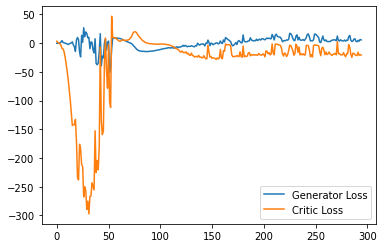

Step 5950: Generator loss: 14.096323020458222, critic loss: -2.481341886997223


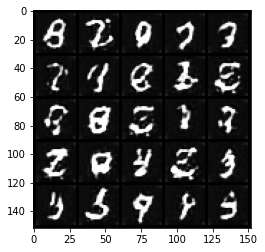

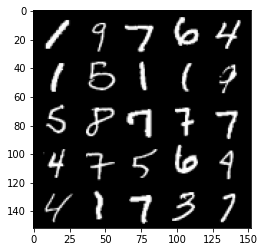

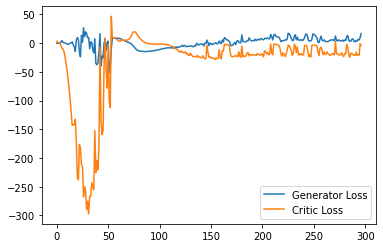

Step 6000: Generator loss: 10.038116466999053, critic loss: -9.793798603057864


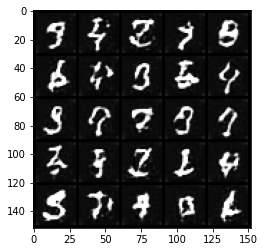

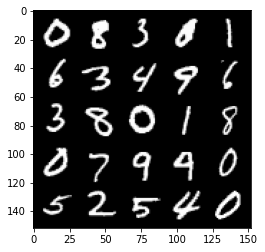

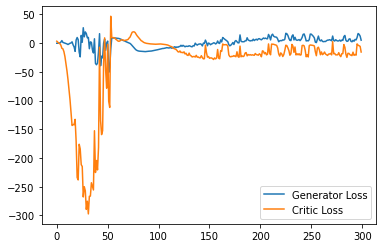

Step 6050: Generator loss: 7.858644553124905, critic loss: -12.148239176750183


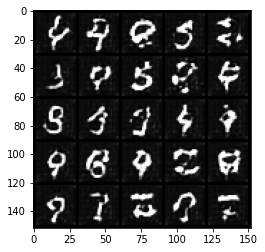

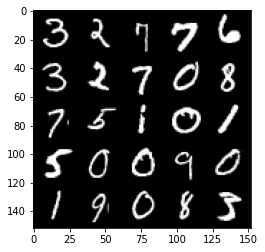

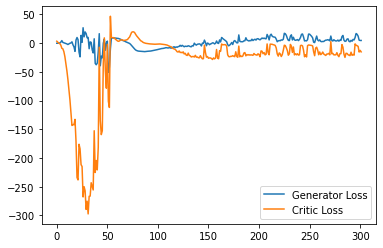

Step 6100: Generator loss: 4.850446809530258, critic loss: -2.0424911756515503


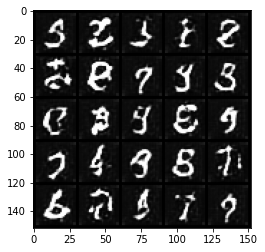

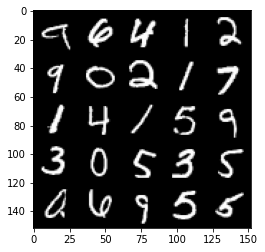

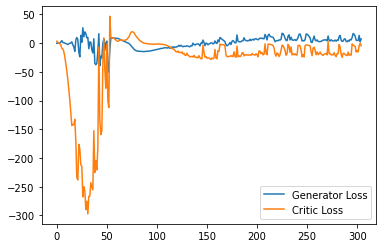

Step 6150: Generator loss: 3.07940391048789, critic loss: -14.686124328613284


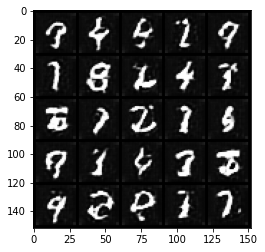

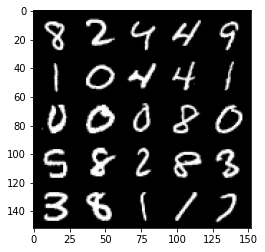

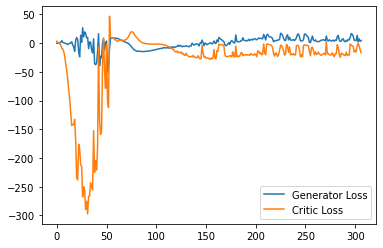

Step 6200: Generator loss: 4.894043262302875, critic loss: -14.866012234687805


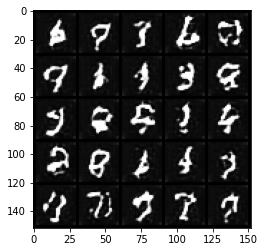

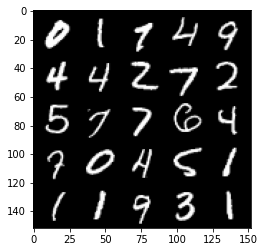

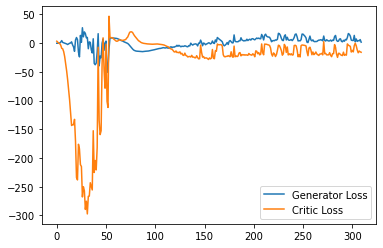

Step 6250: Generator loss: 2.931378736495972, critic loss: -15.500343710899356


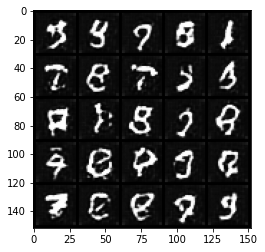

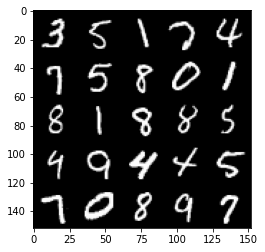

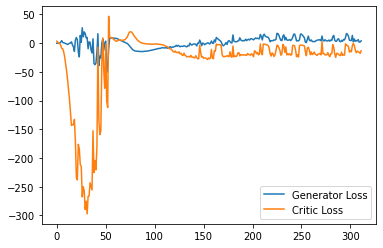

Step 6300: Generator loss: 4.246480350196362, critic loss: -16.413787064552313


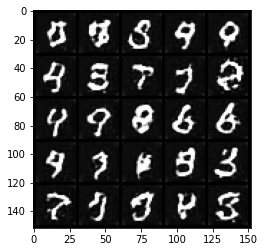

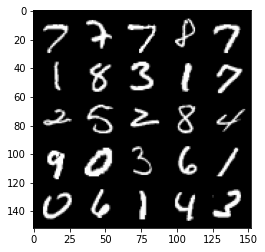

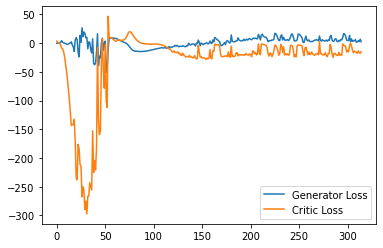

Step 6350: Generator loss: 2.734477996826172, critic loss: -17.863468258857726


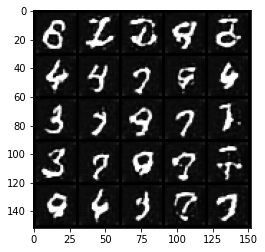

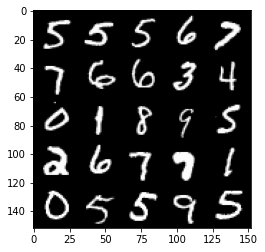

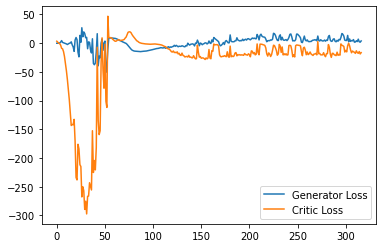

Step 6400: Generator loss: 11.318817114830017, critic loss: 4.289084286689757


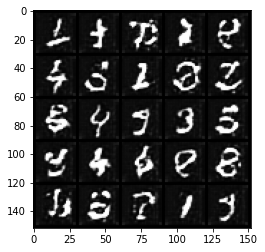

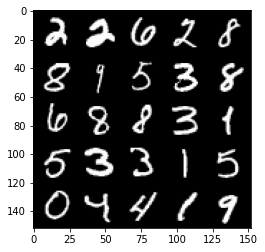

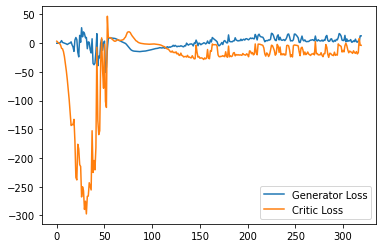

Step 6450: Generator loss: 10.550238304138183, critic loss: -5.920036900520323


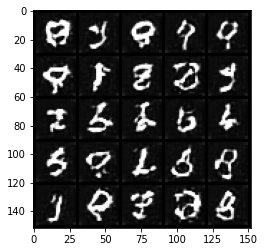

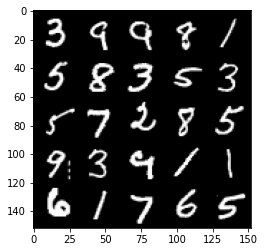

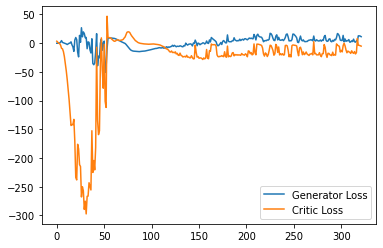

Step 6500: Generator loss: 1.1311228041350843, critic loss: -15.48578280067443


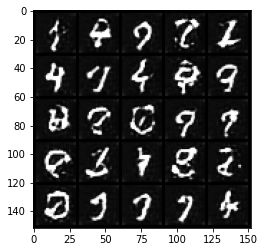

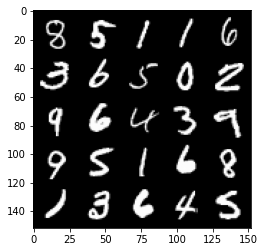

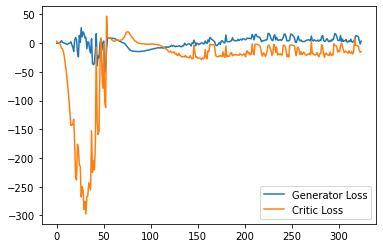

Step 6550: Generator loss: 6.998206918239593, critic loss: -13.173650958538058


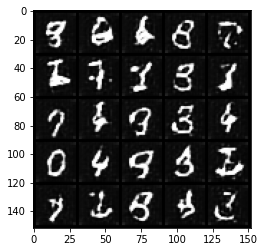

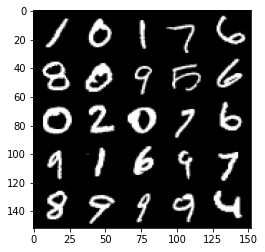

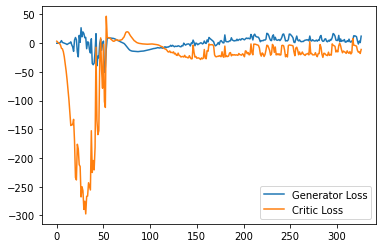

Step 6600: Generator loss: 4.851485203206539, critic loss: -16.044211118698122


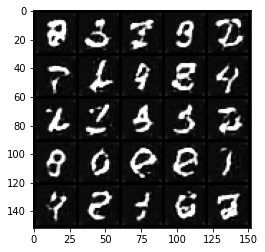

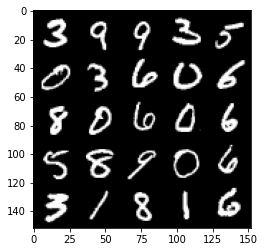

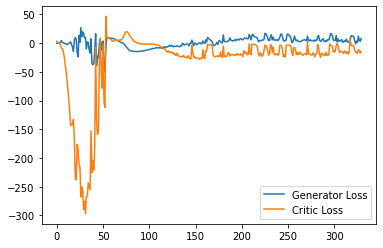

Step 6650: Generator loss: 2.0811072631180285, critic loss: -16.453761231422426


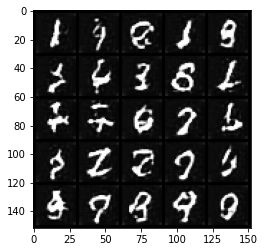

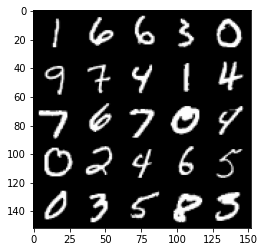

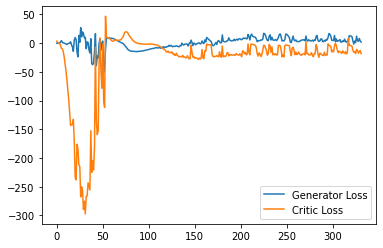

Step 6700: Generator loss: 3.8148472839593888, critic loss: -17.341713969230653


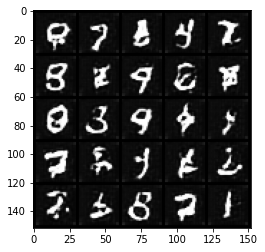

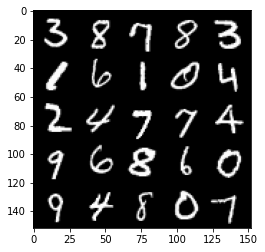

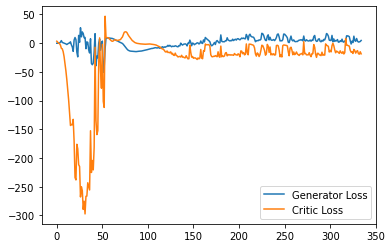

Step 6750: Generator loss: 7.6591293224692345, critic loss: -9.354450930118558


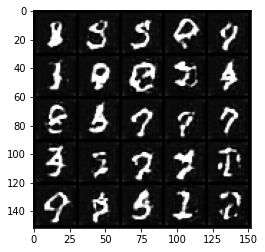

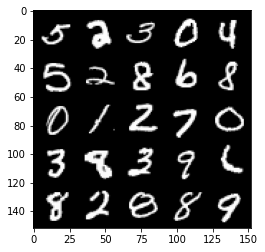

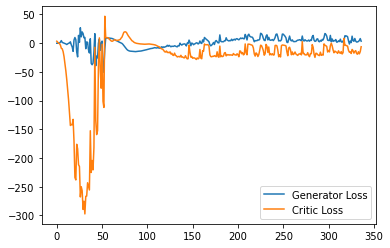

Step 6800: Generator loss: 5.780597898662091, critic loss: -14.039773406028747


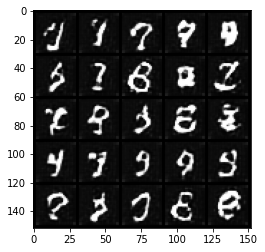

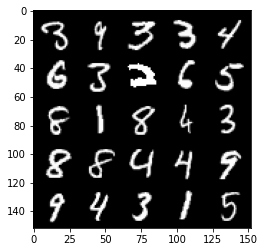

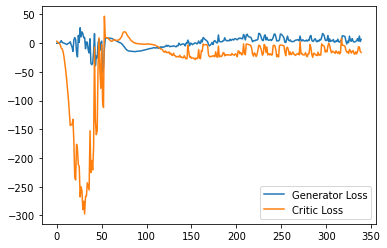

Step 6850: Generator loss: 4.160740211606026, critic loss: -18.694164623260495


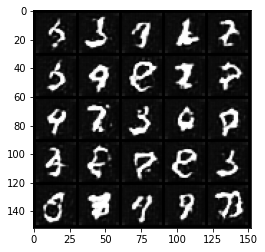

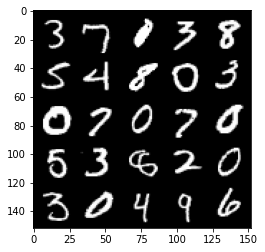

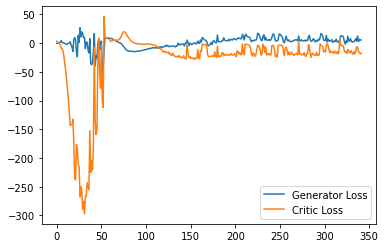

Step 6900: Generator loss: 4.43582572221756, critic loss: -13.929061628341676


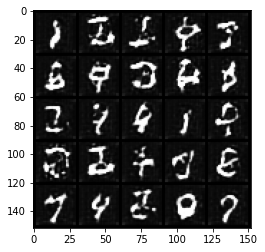

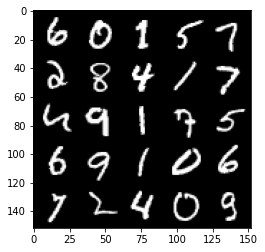

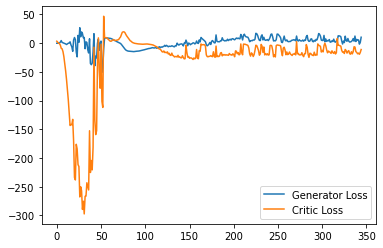

Step 6950: Generator loss: 0.2199767242372036, critic loss: -18.449042478561402


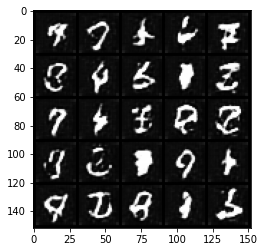

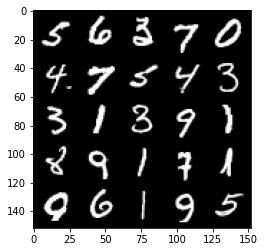

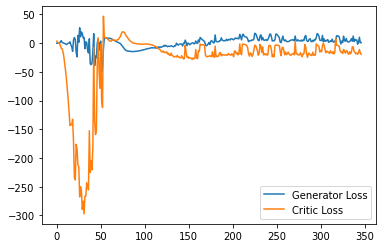

Step 7000: Generator loss: 0.9568573389947415, critic loss: -17.187224218368534


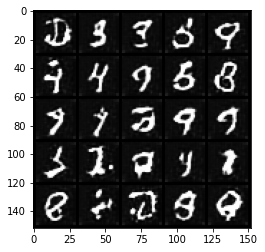

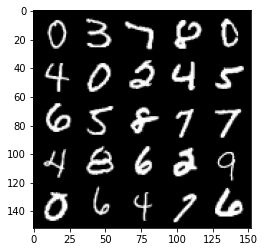

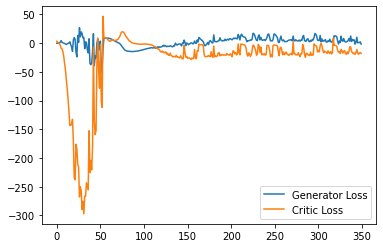

Step 7050: Generator loss: 0.9437495274841785, critic loss: -12.659843844413759


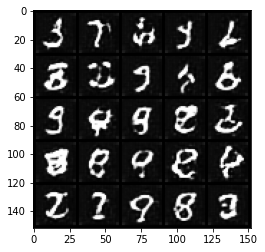

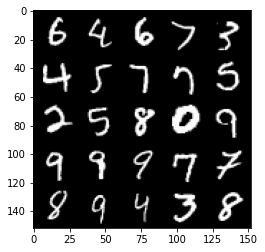

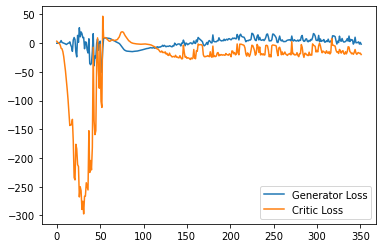

Step 7100: Generator loss: 2.659232541024685, critic loss: -15.189873674392702


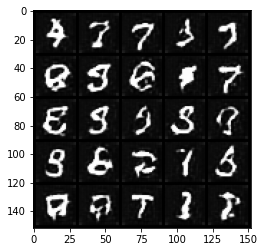

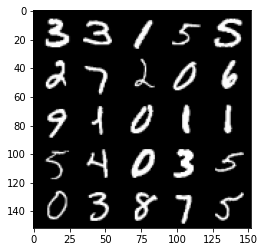

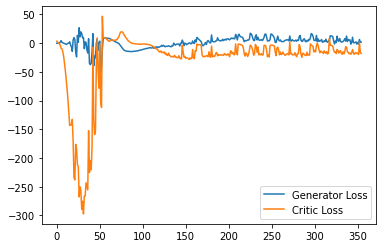

Step 7150: Generator loss: 1.1984551994502544, critic loss: -17.920830019950866


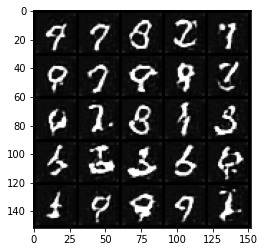

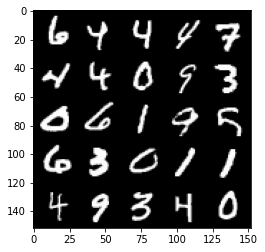

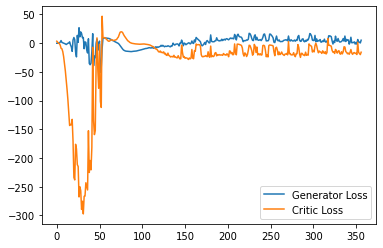

Step 7200: Generator loss: 2.473174685835838, critic loss: -16.784656936168673


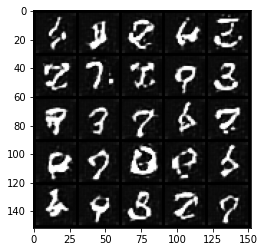

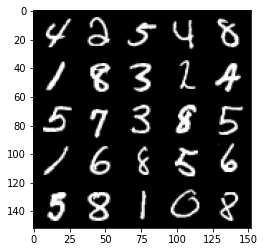

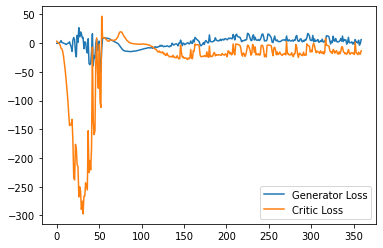

Step 7250: Generator loss: -0.9813243502378464, critic loss: -17.72916936779022


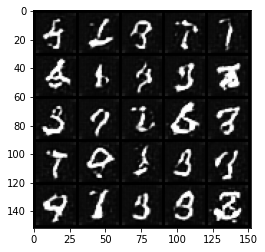

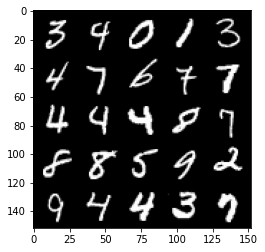

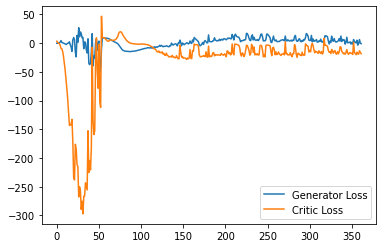

Step 7300: Generator loss: 0.5439865159988403, critic loss: -17.912066162109376


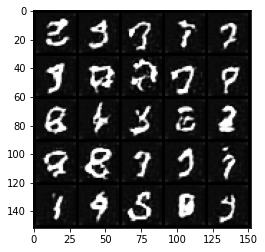

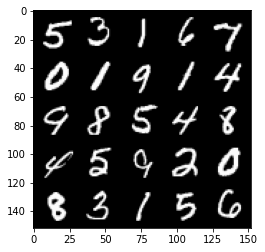

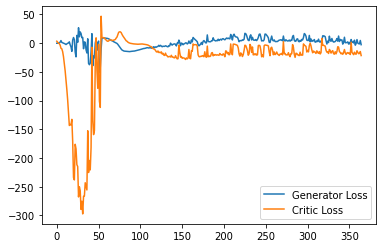

Step 7350: Generator loss: -0.6392438101768494, critic loss: -18.762816782474523


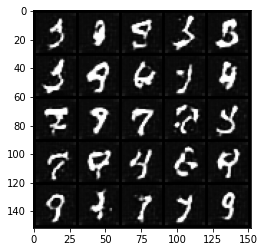

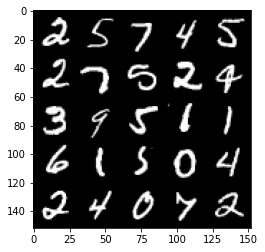

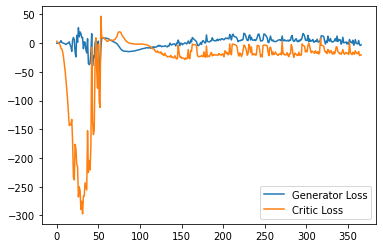

Step 7400: Generator loss: 4.195265707969665, critic loss: -8.698239944934846


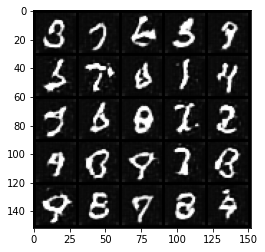

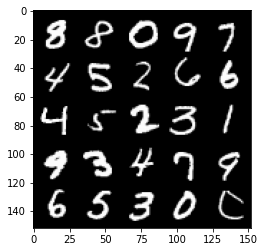

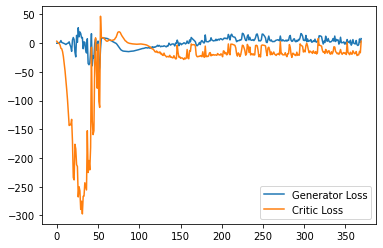

Step 7450: Generator loss: 0.6435492037236691, critic loss: -13.491531852245327


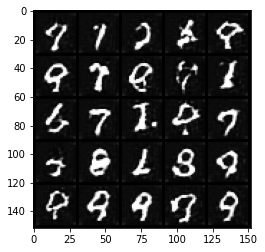

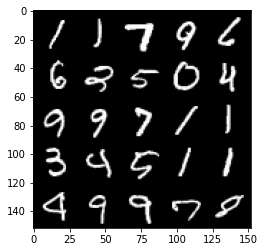

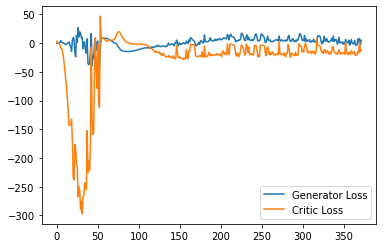

Step 7500: Generator loss: -0.6047724461555481, critic loss: -19.42770928287506


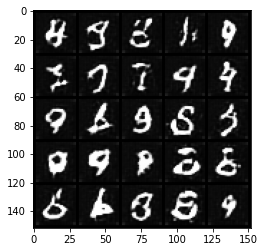

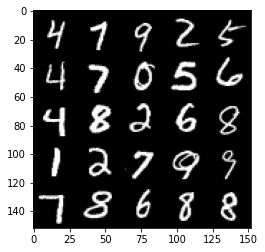

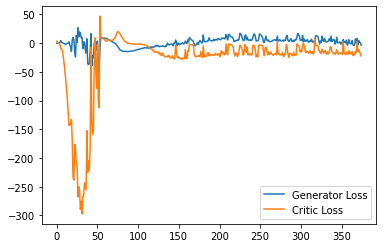

Step 7550: Generator loss: 0.5461351144313812, critic loss: -17.256970738887784


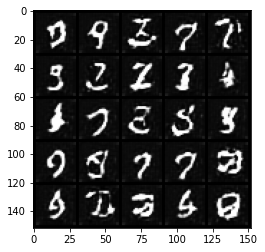

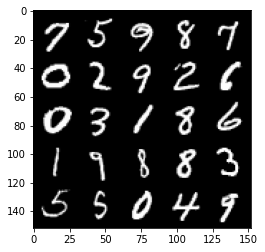

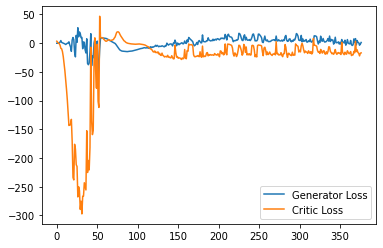

Step 7600: Generator loss: -2.2245897126197813, critic loss: -18.682029284000397


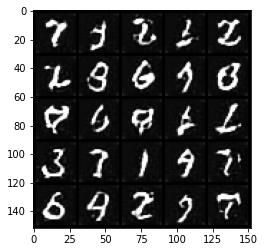

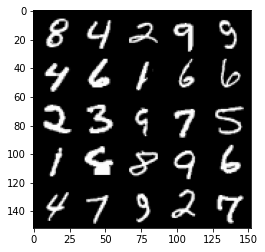

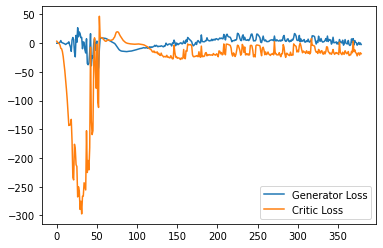

Step 7650: Generator loss: -3.4245166897773744, critic loss: -17.903274143695835


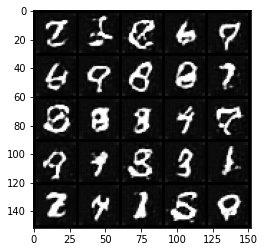

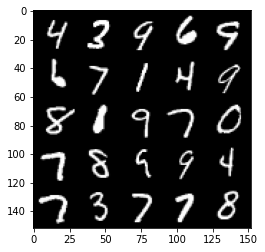

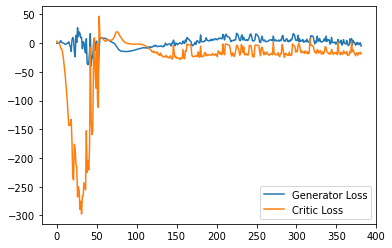

Step 7700: Generator loss: 1.1174923644959927, critic loss: -16.677782681465146


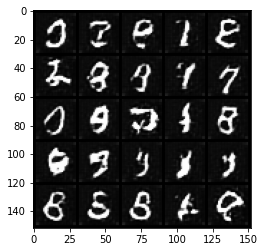

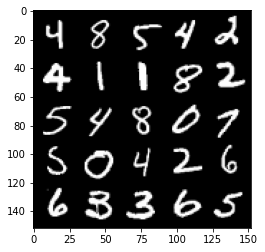

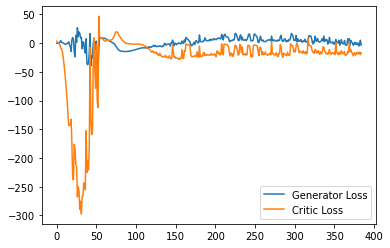

Step 7750: Generator loss: 6.297419502735138, critic loss: -12.47389403867722


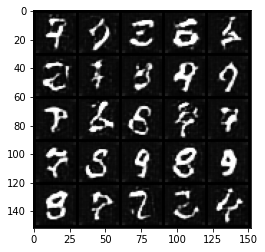

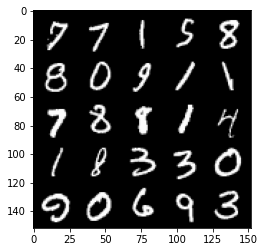

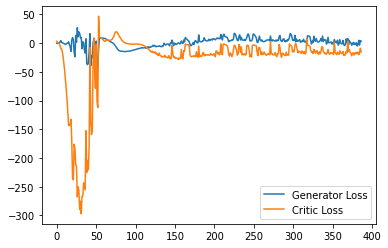

Step 7800: Generator loss: -0.8729213845729827, critic loss: -16.15376000547409


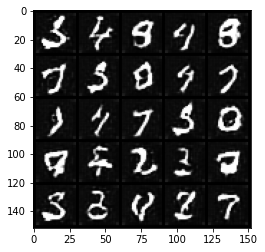

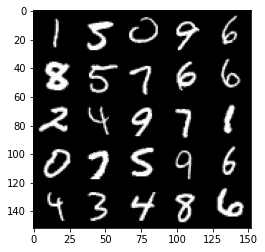

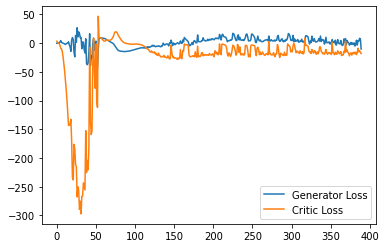

Step 7850: Generator loss: -6.353398983478546, critic loss: -18.735267078399655


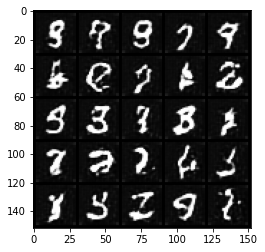

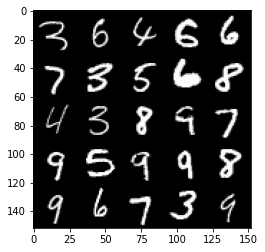

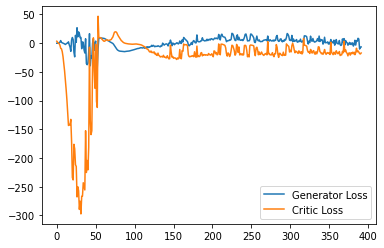

Step 7900: Generator loss: 5.260025534927845, critic loss: -12.567650914669034


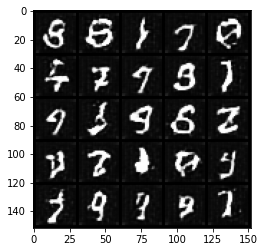

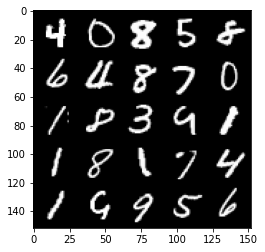

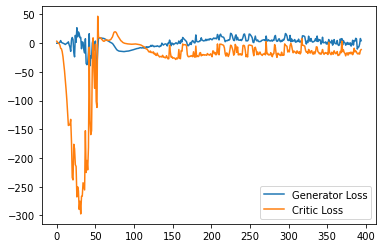

Step 7950: Generator loss: 2.4919518315792084, critic loss: -15.92352230596542


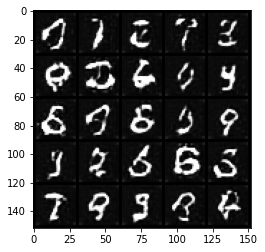

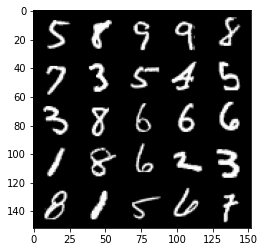

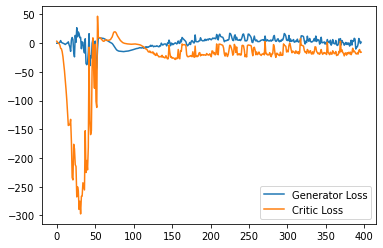

Step 8000: Generator loss: -1.620666562318802, critic loss: -17.065730707168584


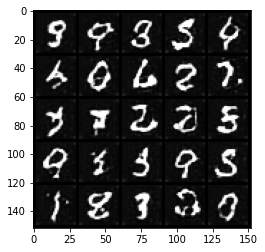

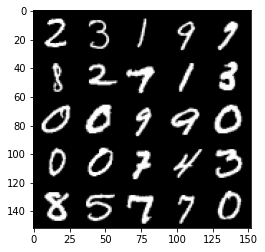

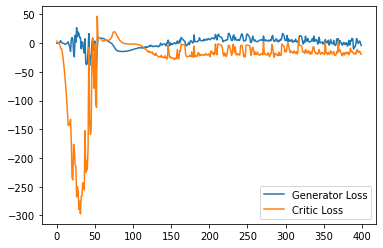

Step 8050: Generator loss: -1.3532805025577546, critic loss: -14.255256203651424


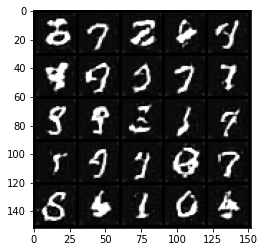

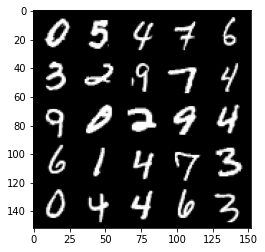

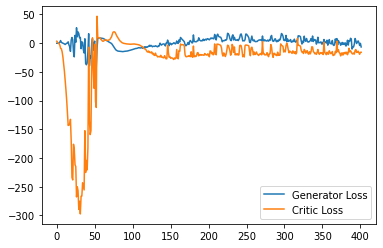

Step 8100: Generator loss: 0.9872544345259666, critic loss: -13.306782710075376


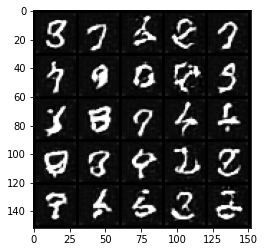

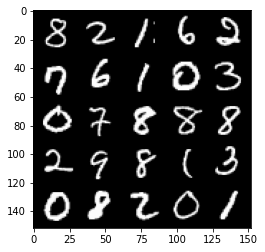

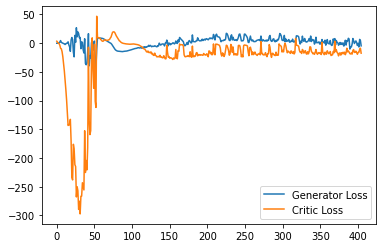

Step 8150: Generator loss: 0.8733373737335205, critic loss: -17.387348589420313


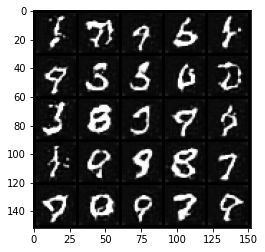

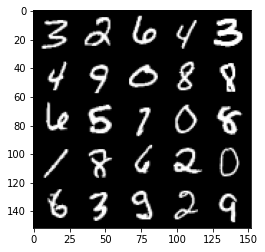

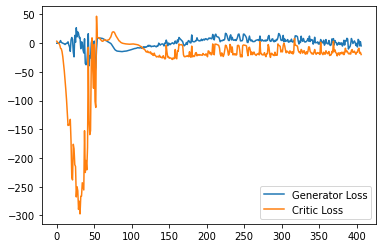

Step 8200: Generator loss: -4.728069425821304, critic loss: -18.02852759695053


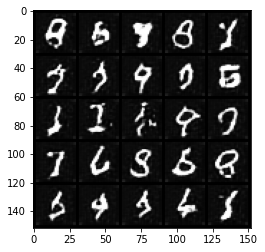

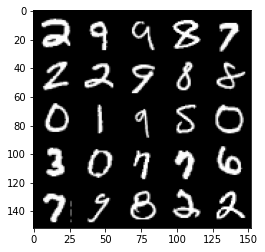

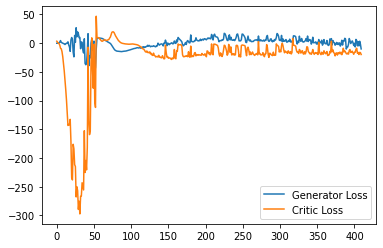

Step 8250: Generator loss: -1.1390770630538463, critic loss: -6.456597099065781


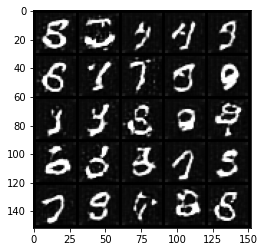

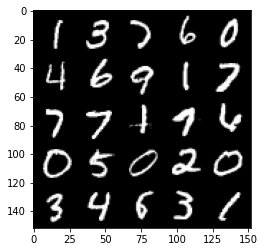

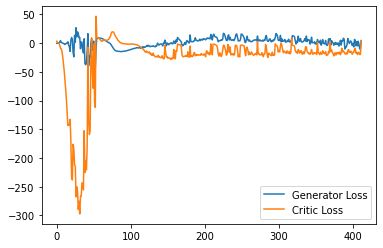

Step 8300: Generator loss: -3.194767550826073, critic loss: -15.679362212657933


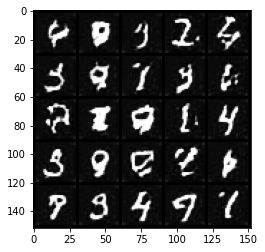

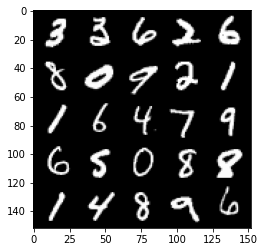

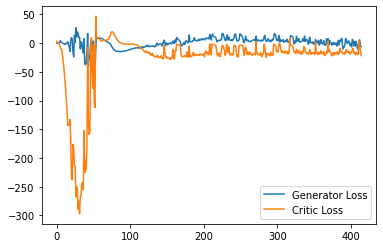

Step 8350: Generator loss: -0.399173196554184, critic loss: -12.473157708644868


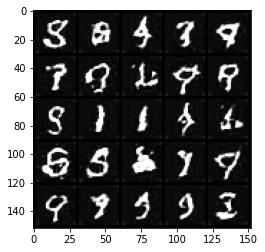

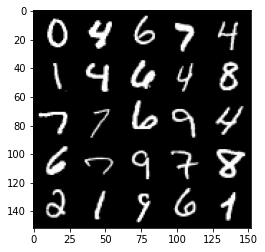

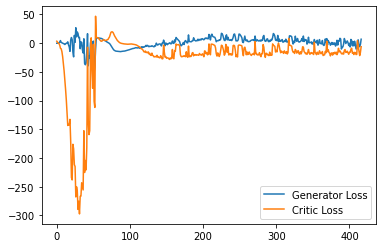

Step 8400: Generator loss: 0.2178465884923935, critic loss: -15.670698401451112


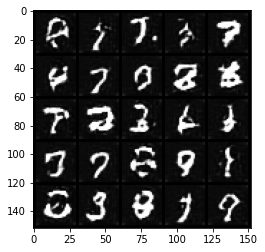

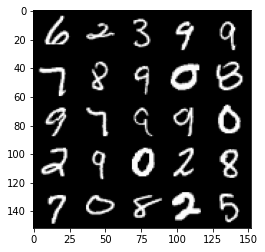

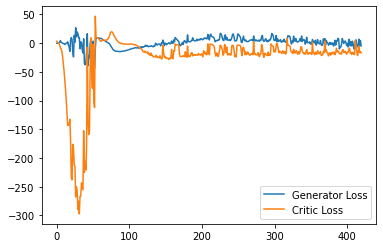

Step 8450: Generator loss: -7.427442903518677, critic loss: -18.741921298503872


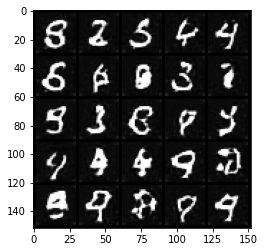

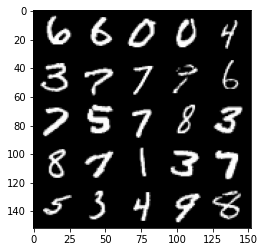

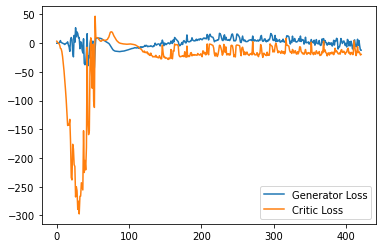

Step 8500: Generator loss: -2.2063505589962005, critic loss: -12.565185759305947


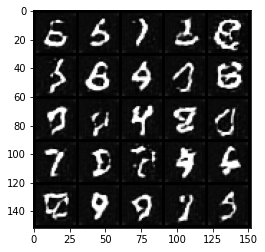

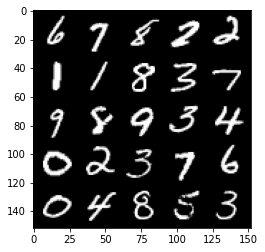

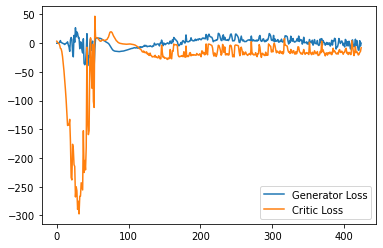

Step 8550: Generator loss: -3.8942290699481963, critic loss: -17.546254821777335


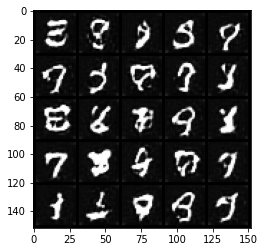

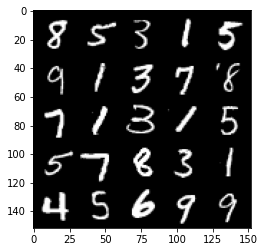

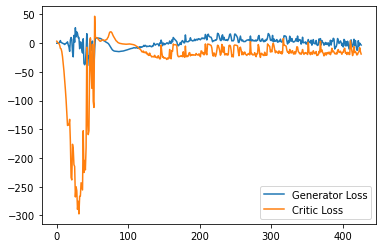

Step 8600: Generator loss: 2.360922492146492, critic loss: -14.489629175186156


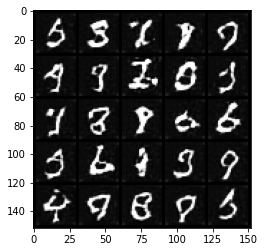

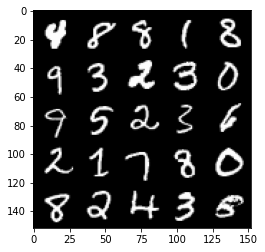

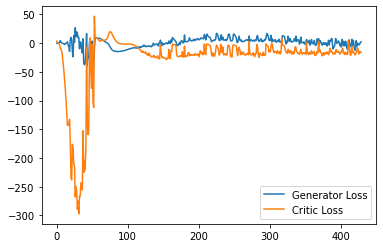

Step 8650: Generator loss: -3.177430226802826, critic loss: -17.280205996036532


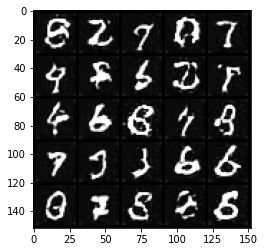

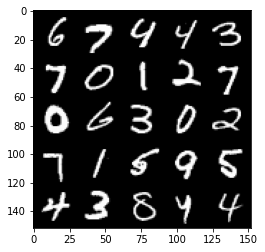

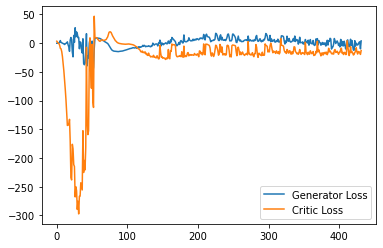

Step 8700: Generator loss: -2.6464328837394713, critic loss: -18.03463216829299


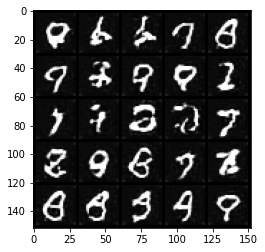

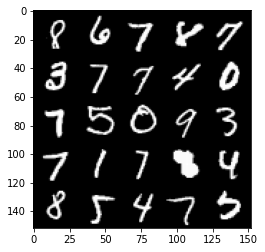

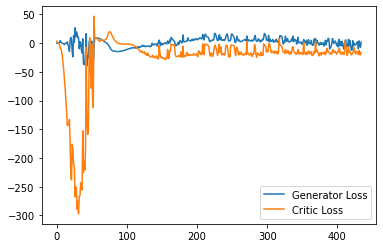

Step 8750: Generator loss: -3.0294210851192473, critic loss: -15.538366217613216


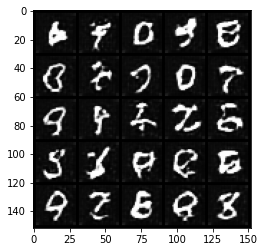

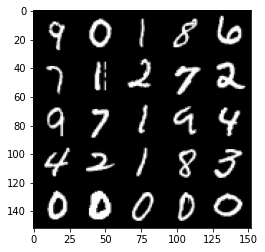

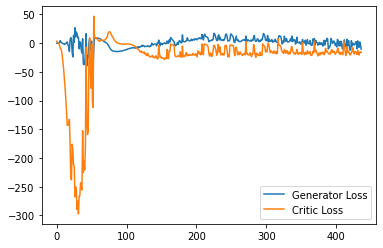

Step 8800: Generator loss: -7.8031125921010975, critic loss: -15.067581488609314


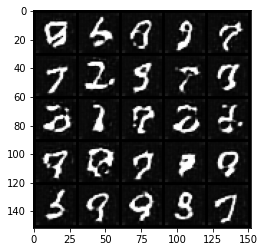

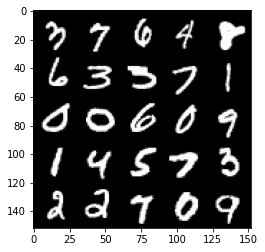

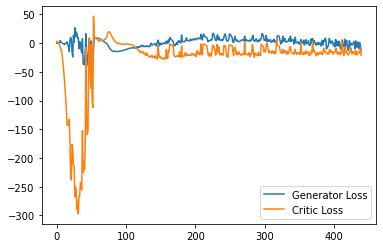

Step 8850: Generator loss: -3.8637297716736794, critic loss: -18.884810567378995


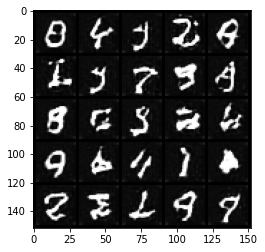

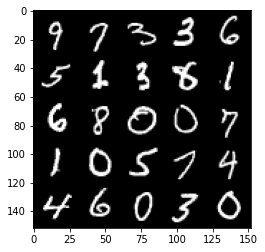

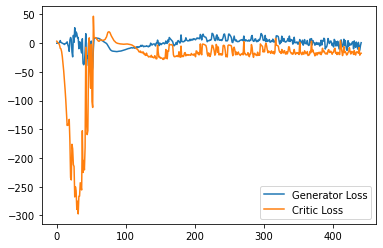

Step 8900: Generator loss: -0.4920073699951172, critic loss: -14.46463819217682


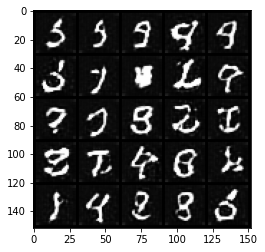

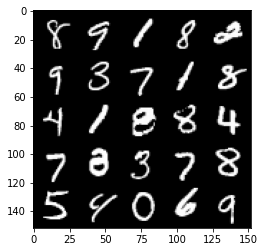

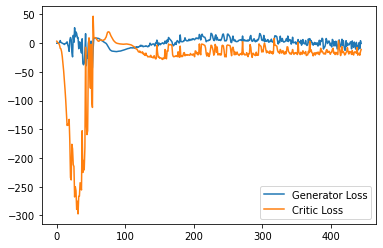

Step 8950: Generator loss: -8.263728499412537, critic loss: -19.951876469135282


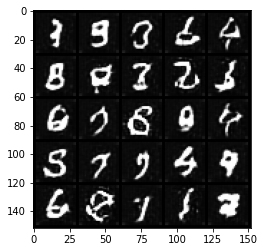

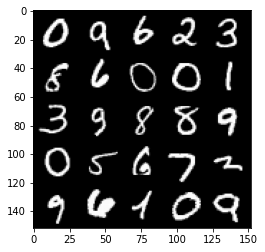

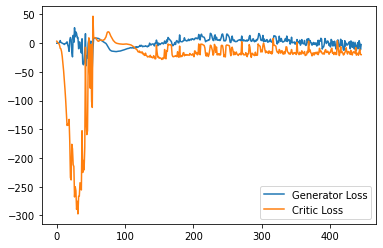

Step 9000: Generator loss: -11.209188535213471, critic loss: -20.54952452421188


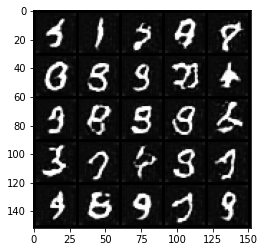

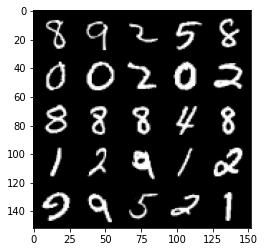

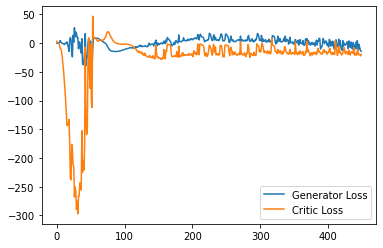

Step 9050: Generator loss: -10.199140634536743, critic loss: -19.574152195453642


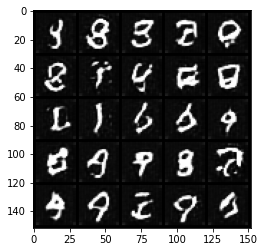

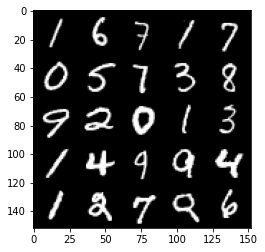

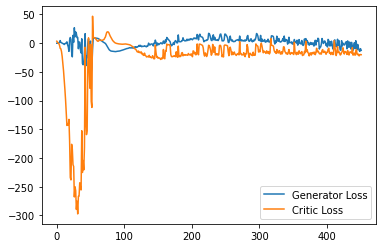

Step 9100: Generator loss: 0.7571355584263801, critic loss: -6.001611149787903


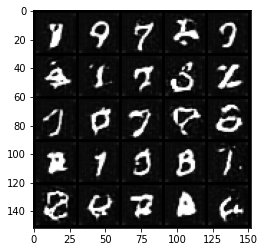

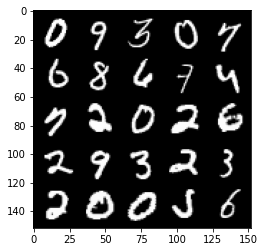

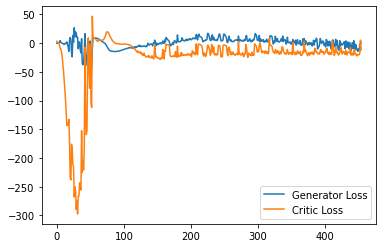

Step 9150: Generator loss: -4.169534385204315, critic loss: -15.453854134559627


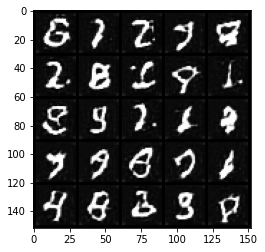

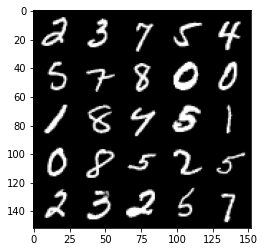

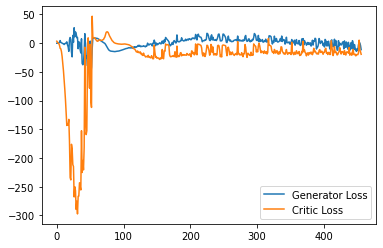

Step 9200: Generator loss: 0.9172335329651833, critic loss: -16.865765076637267


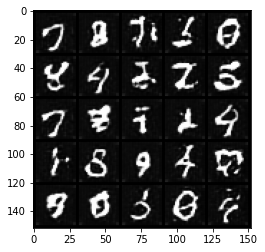

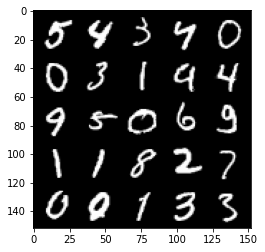

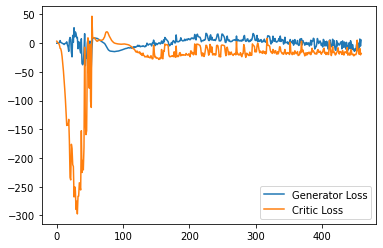

Step 9250: Generator loss: -6.175100434720516, critic loss: -16.727137173652647


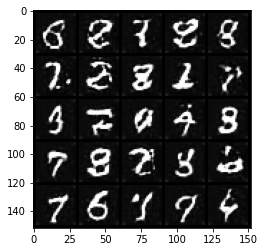

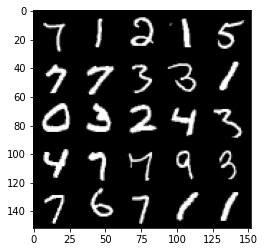

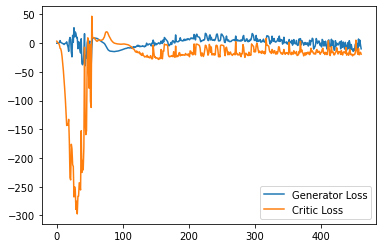

Step 9300: Generator loss: -3.8593953067064284, critic loss: -16.91886907577515


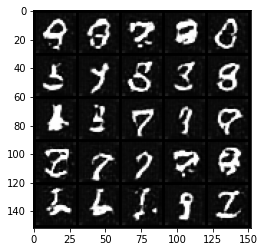

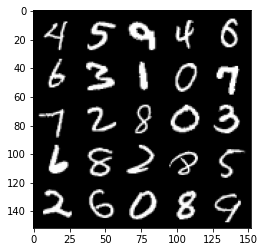

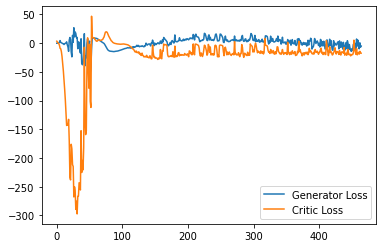

Step 9350: Generator loss: -9.105847786068916, critic loss: -14.05246016311645


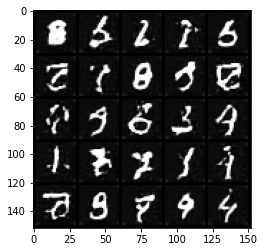

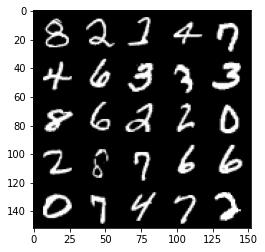

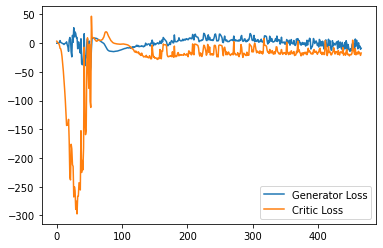

Step 9400: Generator loss: 2.105538917183876, critic loss: -14.32416541290283


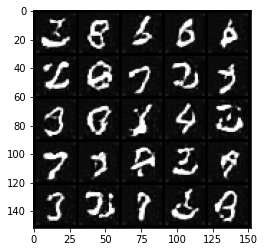

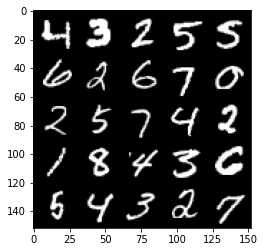

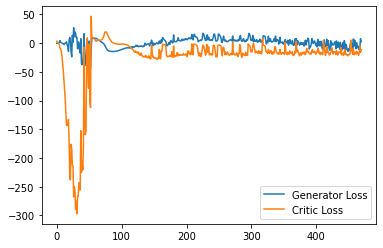

Step 9450: Generator loss: -7.807244998216629, critic loss: -18.521355929851527


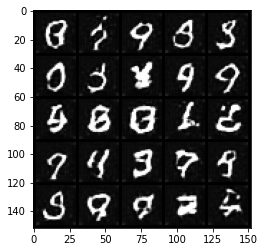

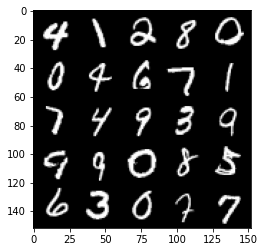

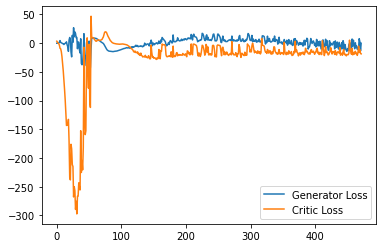

Step 9500: Generator loss: -0.5145329523086548, critic loss: -15.304651332855224


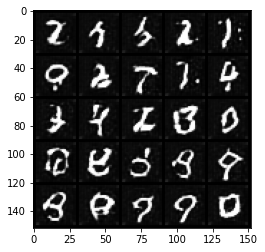

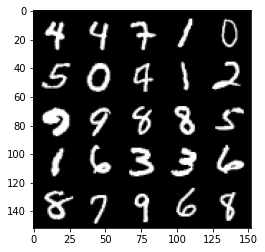

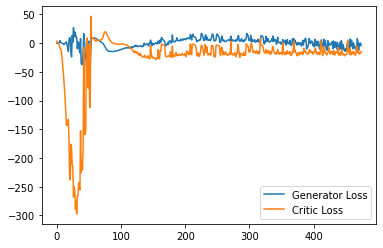

Step 9550: Generator loss: -5.131870011091232, critic loss: -17.54475642347336


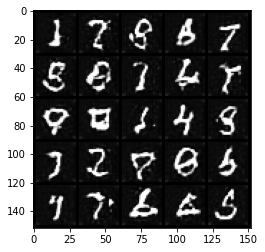

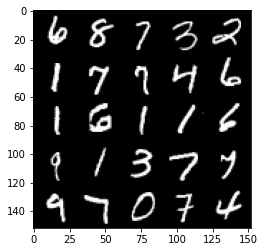

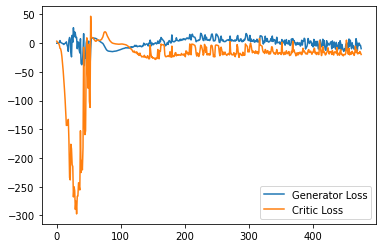

Step 9600: Generator loss: -3.9310203236341477, critic loss: -17.660619130611416


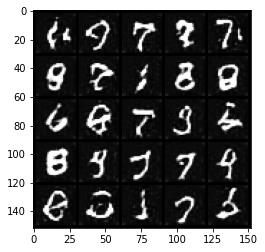

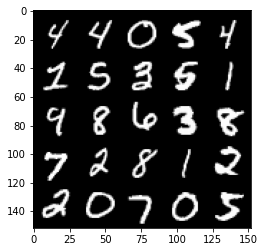

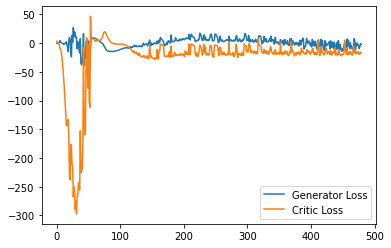

Step 9650: Generator loss: -3.88378368973732, critic loss: -18.68929657125473


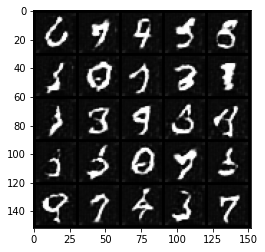

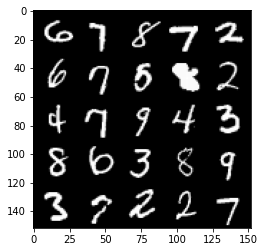

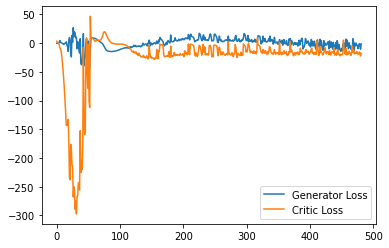

Step 9700: Generator loss: -6.22524172604084, critic loss: -18.743793359756474


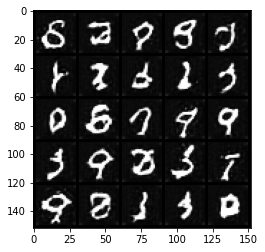

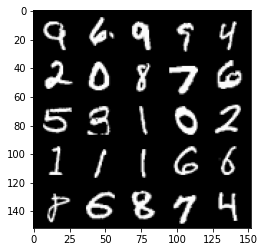

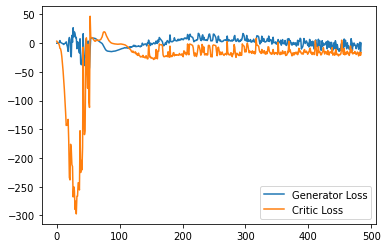

Step 9750: Generator loss: -9.208100220561027, critic loss: -18.647729691028598


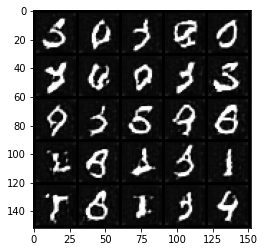

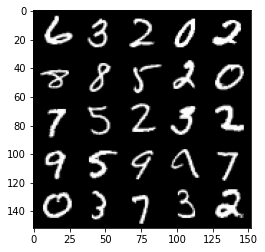

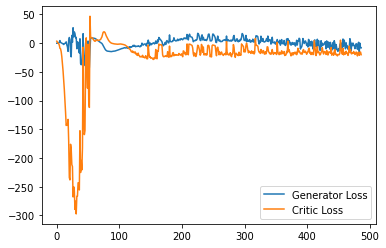

Step 9800: Generator loss: -2.367567286491394, critic loss: -5.253101808547974


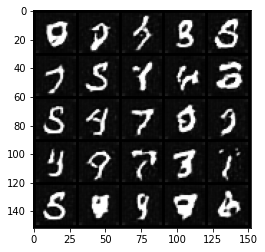

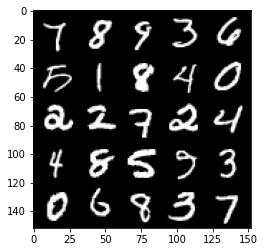

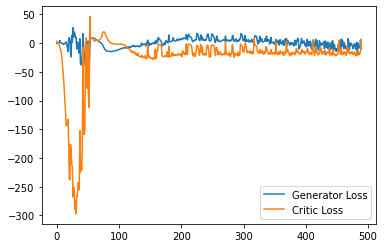

Step 9850: Generator loss: -4.73271053314209, critic loss: -13.759966739892963


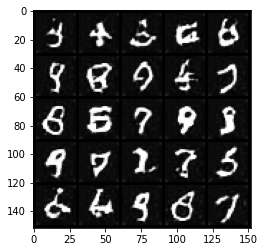

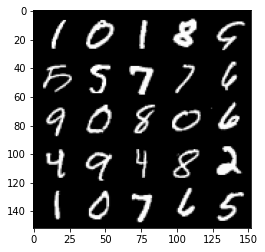

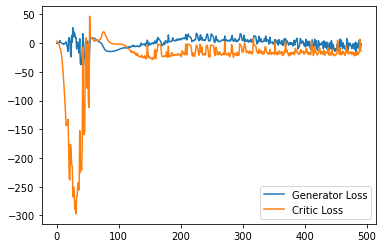

Step 9900: Generator loss: -2.03691548705101, critic loss: -15.948712927818297


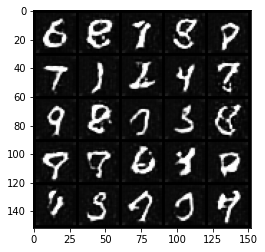

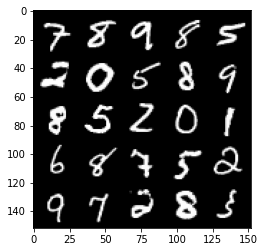

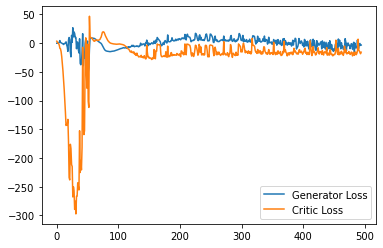

Step 9950: Generator loss: -1.2344217103719712, critic loss: -13.545317461490626


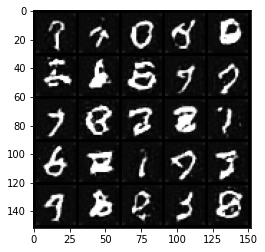

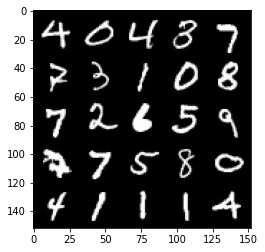

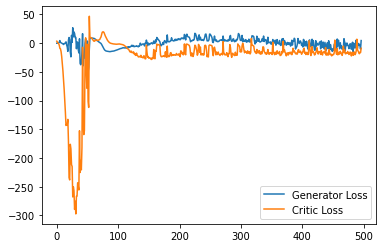

Step 10000: Generator loss: -9.15170762360096, critic loss: -16.49266151237488


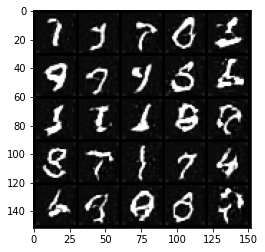

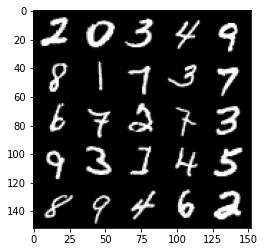

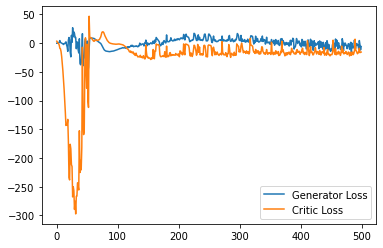

Step 10050: Generator loss: -5.089666827917099, critic loss: -17.1021819396019


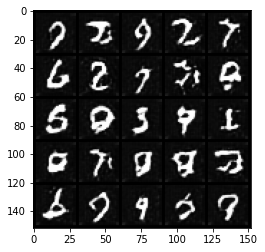

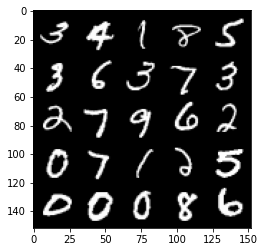

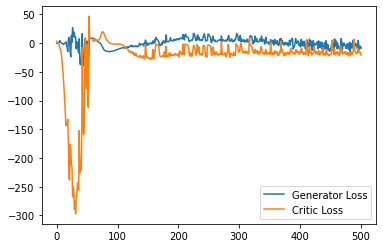

Step 10100: Generator loss: -4.151523625254631, critic loss: -18.257252491950993


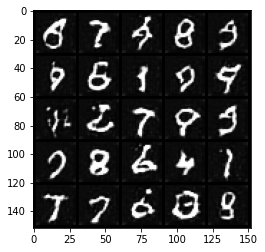

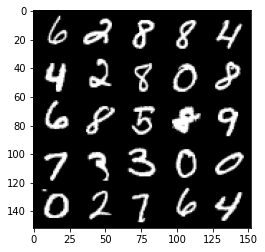

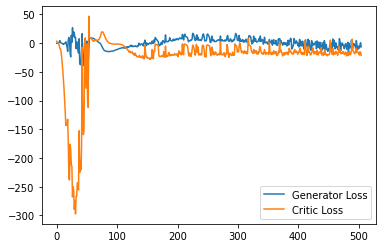

Step 10150: Generator loss: -4.936752885878086, critic loss: -15.133741691112519


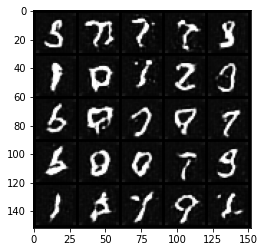

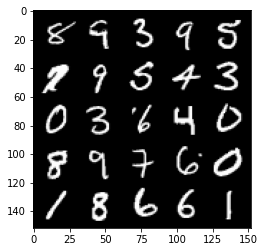

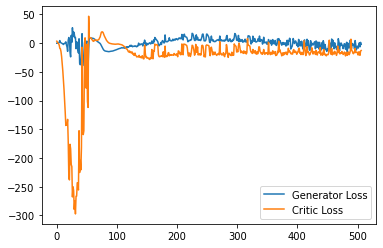

Step 10200: Generator loss: -7.2143014857172965, critic loss: -17.161740718364715


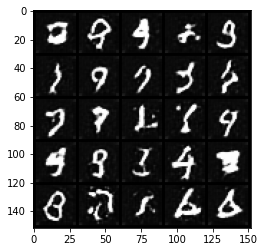

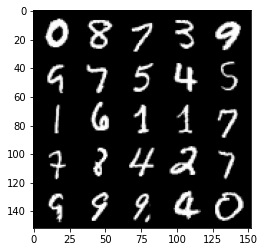

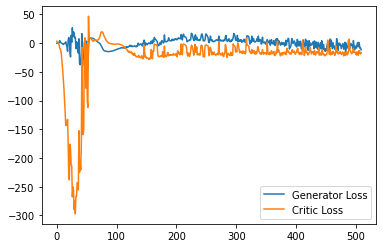

Step 10250: Generator loss: -6.670855870246887, critic loss: -12.436246597766871


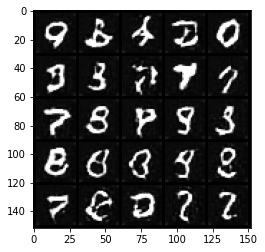

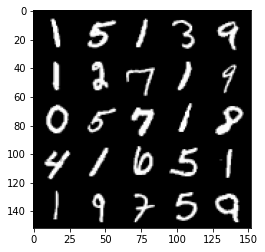

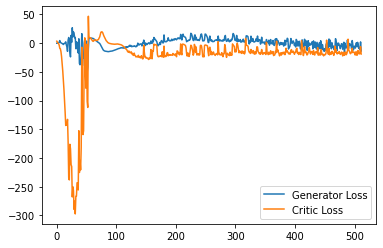

Step 10300: Generator loss: -0.47040011405944826, critic loss: -8.257684463500977


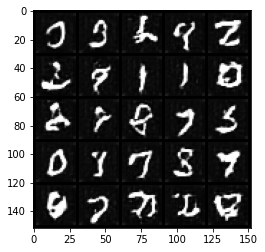

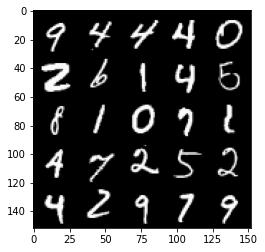

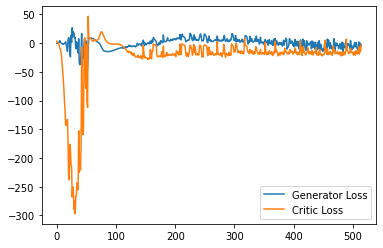

Step 10350: Generator loss: -8.91643590092659, critic loss: -9.895200535297395


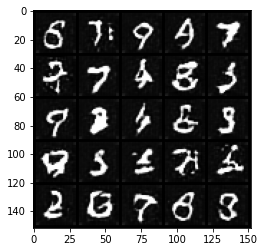

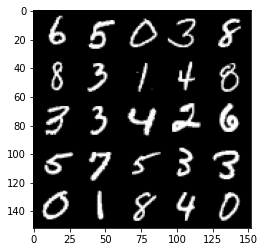

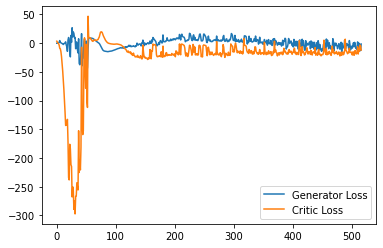

Step 10400: Generator loss: -3.5852937078475953, critic loss: 1.2078609137535106


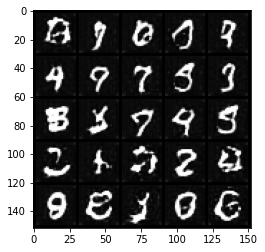

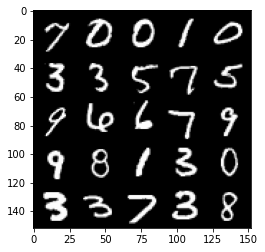

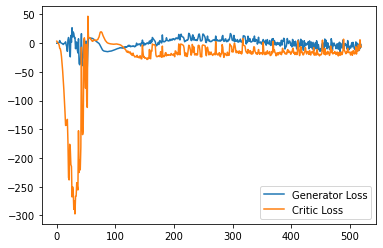

Step 10450: Generator loss: -14.608958339691162, critic loss: -14.856751360416416


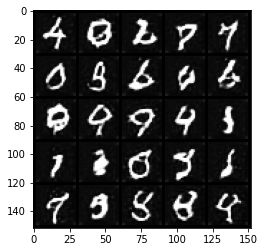

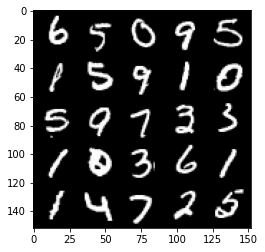

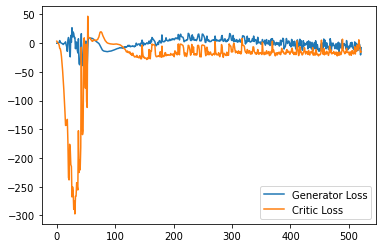

Step 10500: Generator loss: -7.737332132160663, critic loss: -15.739446278333665


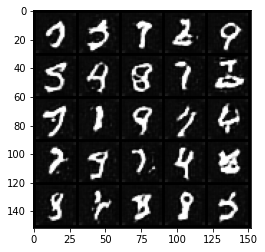

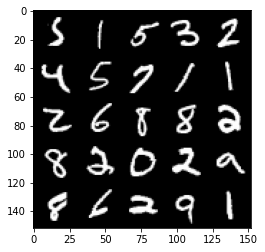

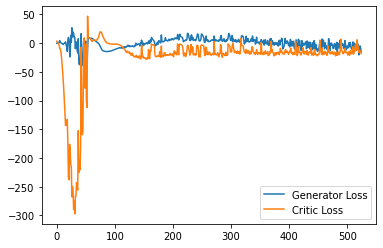

Step 10550: Generator loss: -6.373559576272965, critic loss: -13.174898606300353


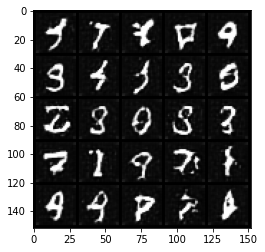

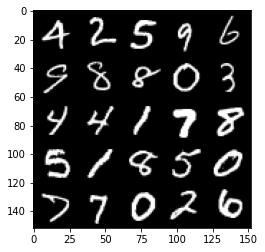

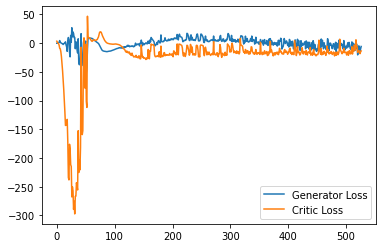

Step 10600: Generator loss: -9.432145991325378, critic loss: -15.814545684814457


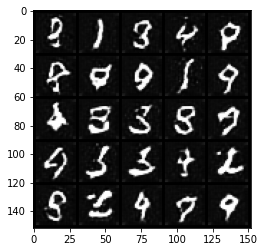

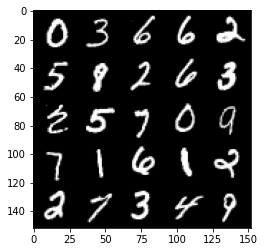

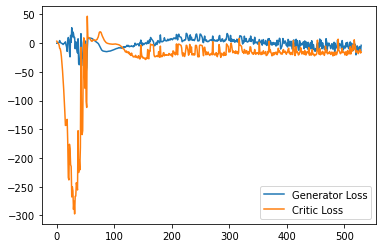

Step 10650: Generator loss: -10.379692136645318, critic loss: -20.94313166785241


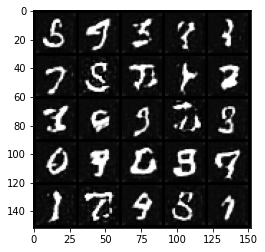

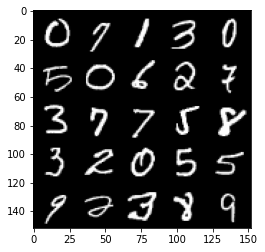

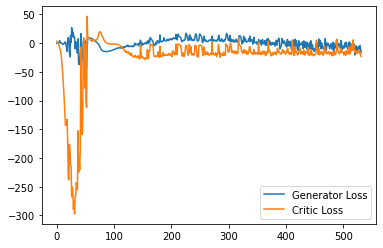

Step 10700: Generator loss: -4.594394125714898, critic loss: -10.99636583518982


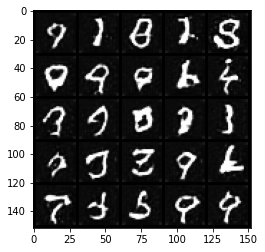

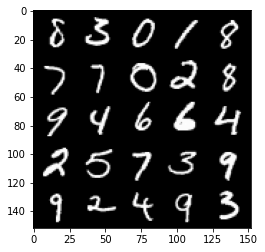

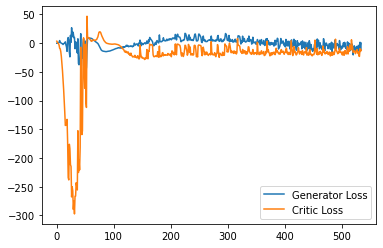

Step 10750: Generator loss: -8.727155281305313, critic loss: -17.300441982507706


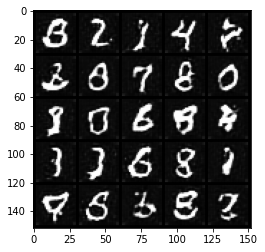

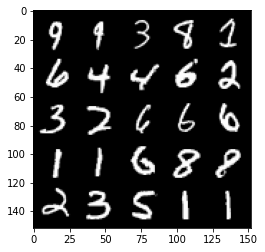

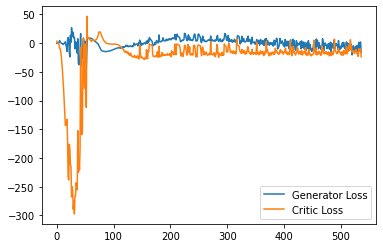

Step 10800: Generator loss: -14.811396164298058, critic loss: -18.323609029769894


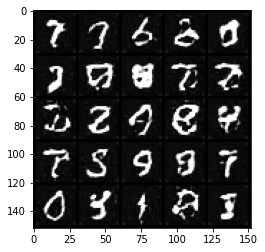

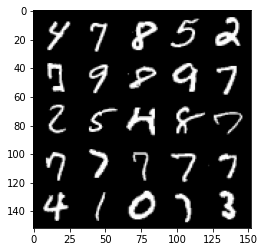

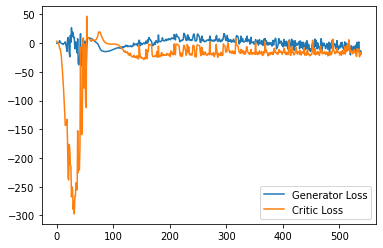

Step 10850: Generator loss: -3.18926216006279, critic loss: -16.887573525190355


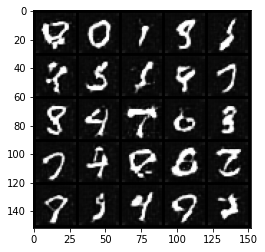

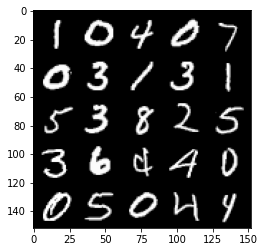

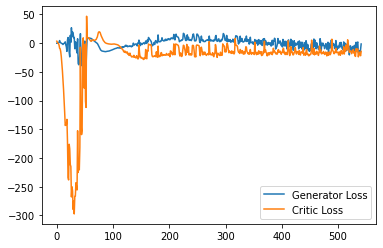

Step 10900: Generator loss: -11.93986308991909, critic loss: -19.120667047977445


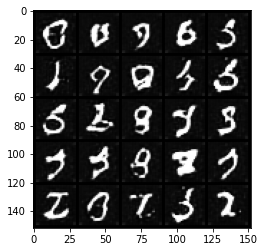

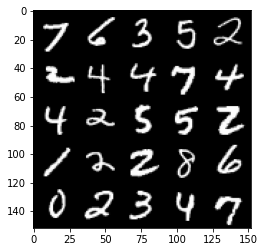

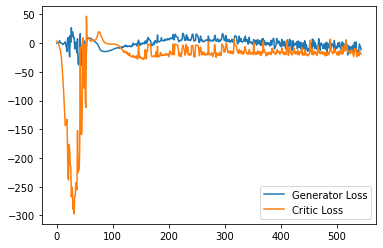

Step 10950: Generator loss: -7.481783480644226, critic loss: -17.928130330085754


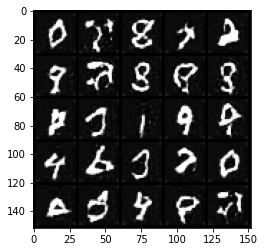

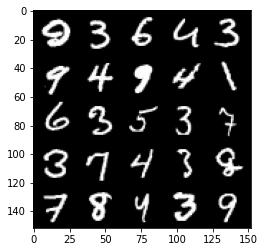

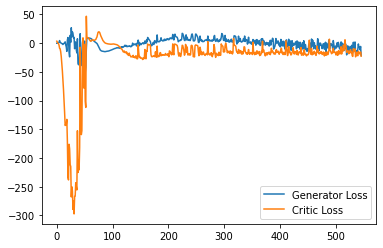

Step 11000: Generator loss: -3.1697393745183944, critic loss: -13.797660602569584


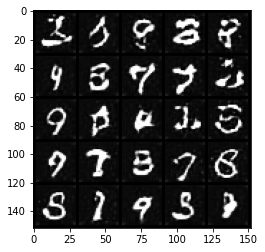

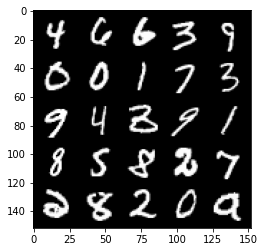

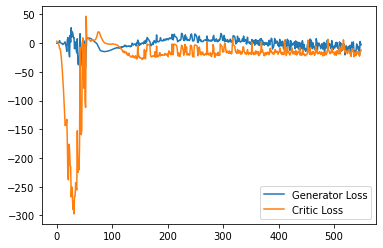

Step 11050: Generator loss: -13.290213804841041, critic loss: -18.34703351306915


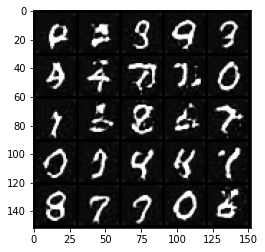

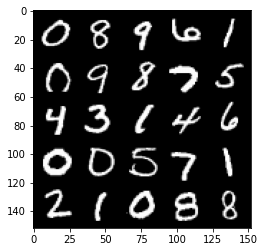

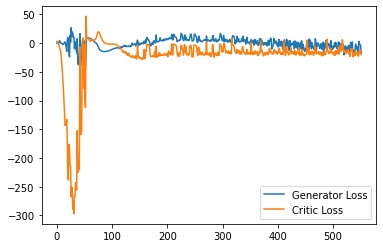

Step 11100: Generator loss: -4.907692900896072, critic loss: -4.879409399271011


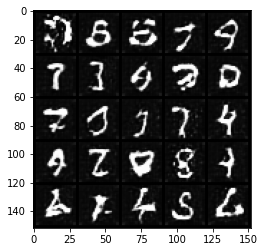

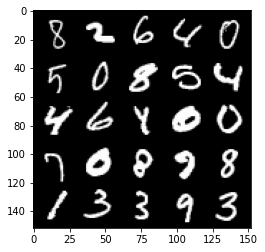

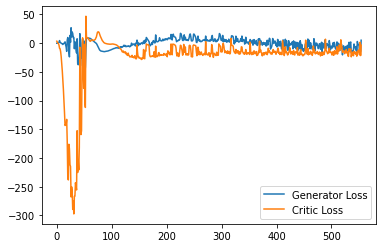

Step 11150: Generator loss: -13.667960524857044, critic loss: -16.647736181259155


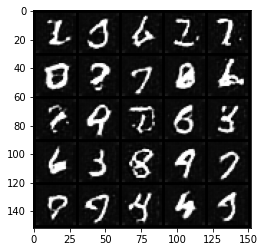

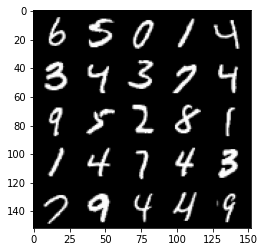

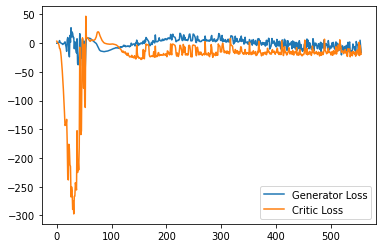

Step 11200: Generator loss: -15.535189458429814, critic loss: -18.992500293731688


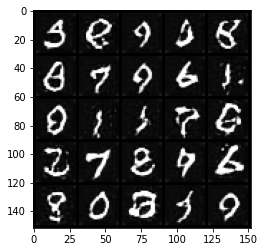

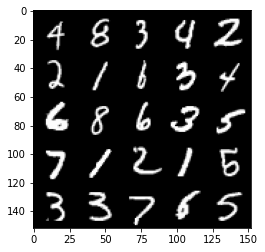

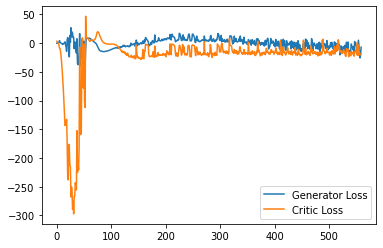

Step 11250: Generator loss: -6.854933345317841, critic loss: -11.953234015941621


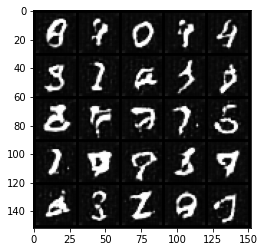

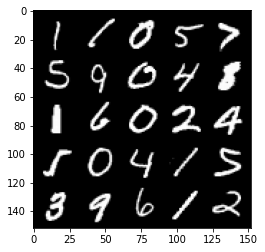

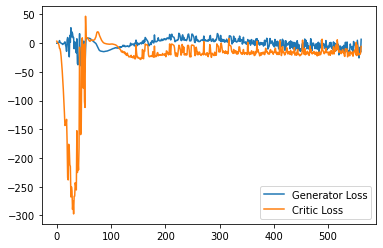

Step 11300: Generator loss: -6.501660360097885, critic loss: -15.07074411821365


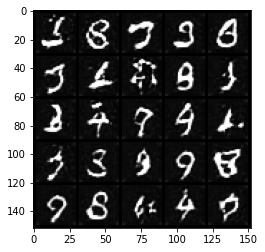

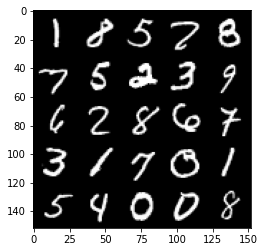

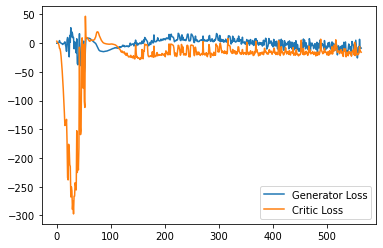

Step 11350: Generator loss: -10.13217221289873, critic loss: -17.976586934089656


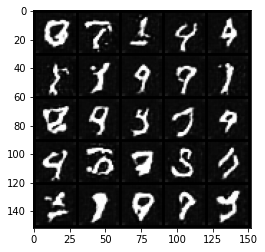

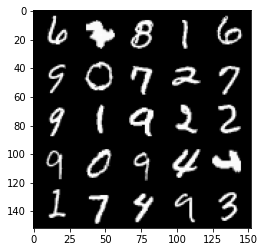

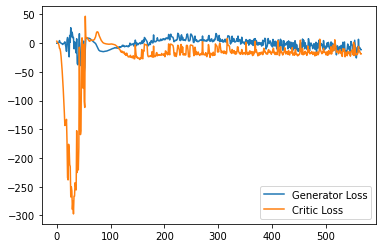

Step 11400: Generator loss: -0.8538701078295707, critic loss: -8.712609600543974


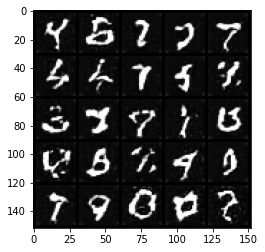

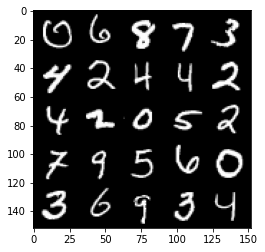

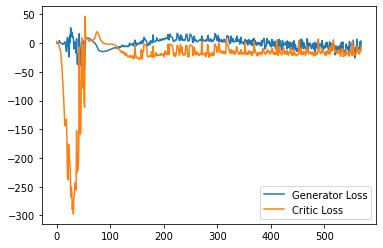

Step 11450: Generator loss: -11.120699173212051, critic loss: -12.365442620515818


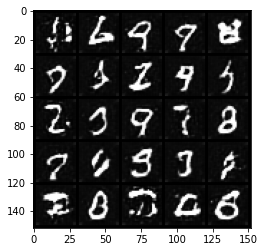

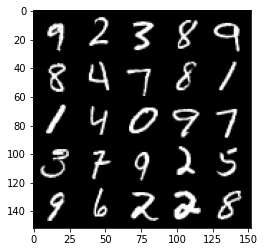

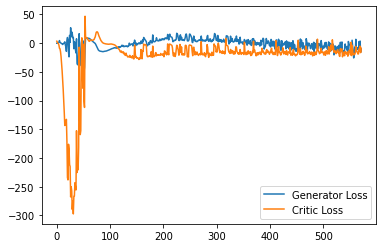

Step 11500: Generator loss: -8.805936803221703, critic loss: -11.17702966308594


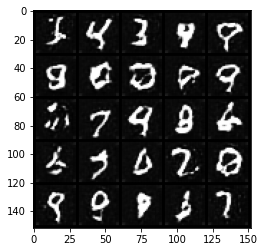

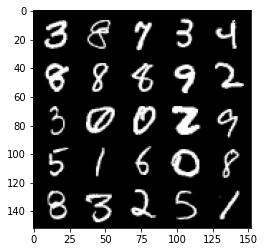

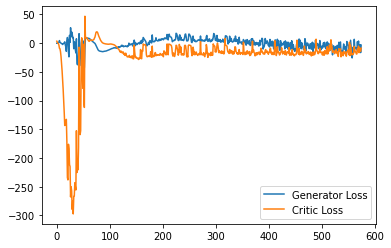

Step 11550: Generator loss: -5.097107548713684, critic loss: -10.483639635086059


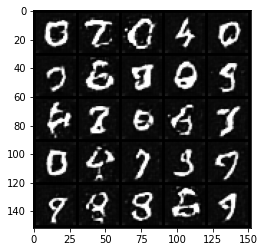

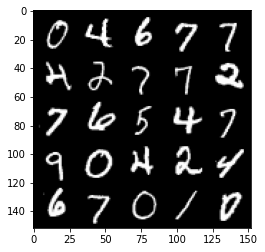

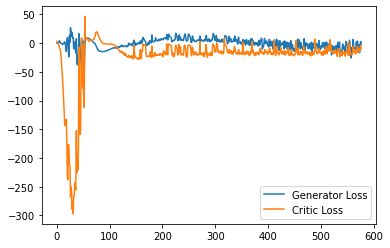

Step 11600: Generator loss: -11.973867543935775, critic loss: -16.83809970402718


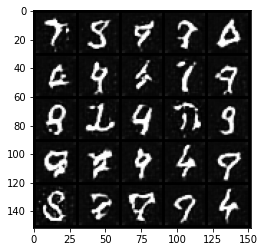

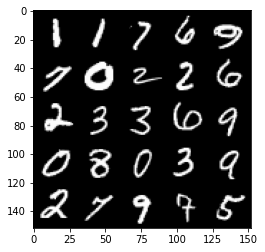

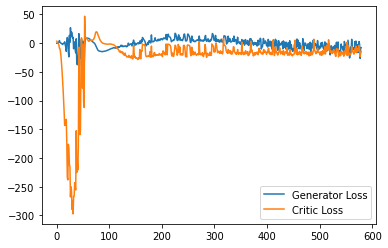

Step 11650: Generator loss: -14.261259370148181, critic loss: -19.55699458503723


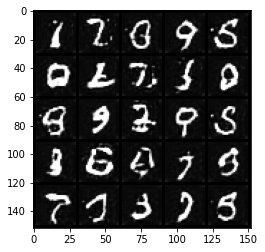

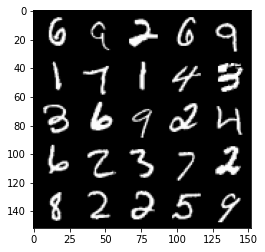

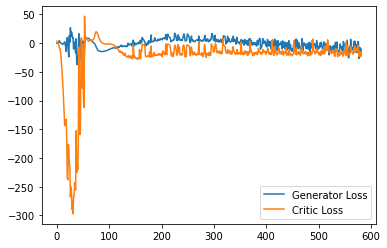

Step 11700: Generator loss: -13.073322615474462, critic loss: -14.711692512989046


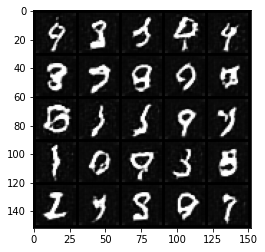

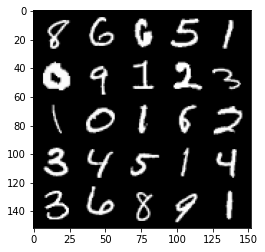

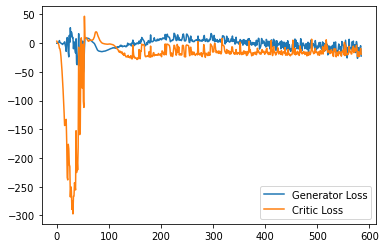

Step 11750: Generator loss: -8.257831499576568, critic loss: -15.049195397615433


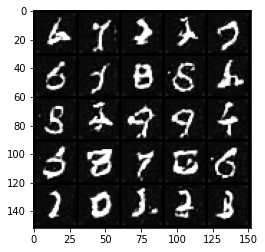

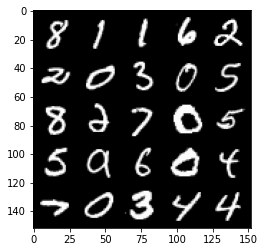

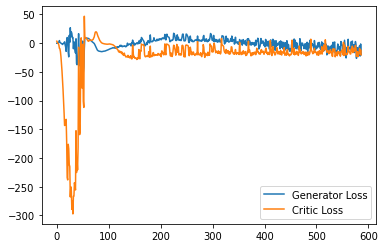

Step 11800: Generator loss: -9.293216252326966, critic loss: -10.577347569465635


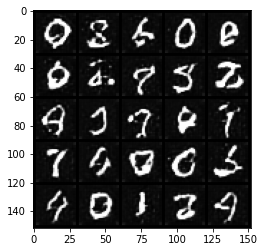

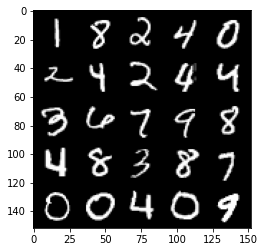

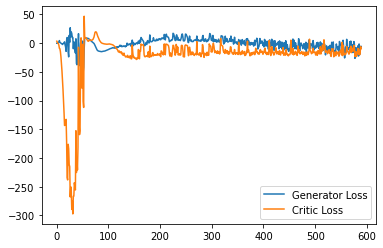

Step 11850: Generator loss: -15.021389653086663, critic loss: -17.50001858901977


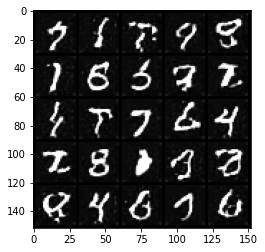

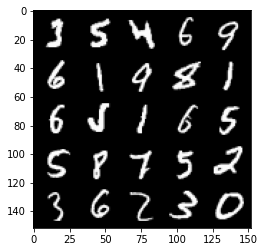

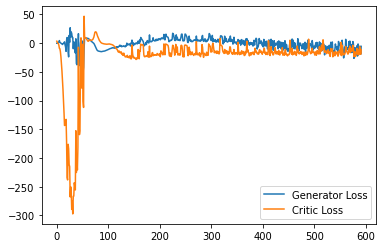

Step 11900: Generator loss: -12.75355393409729, critic loss: -14.848910299301146


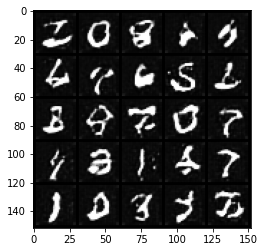

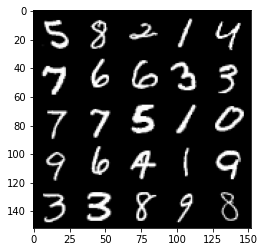

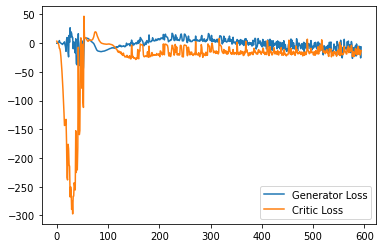

Step 11950: Generator loss: -12.985049089193344, critic loss: -14.595220294475553


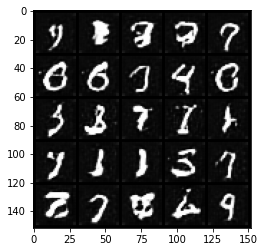

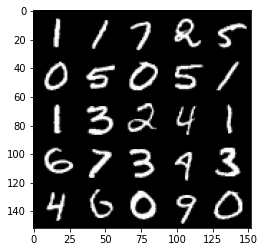

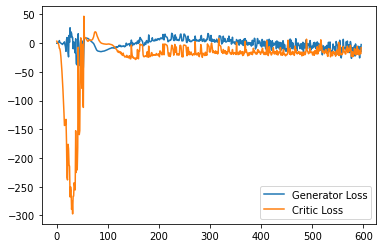

Step 12000: Generator loss: -9.935276145935058, critic loss: -12.657951743841172


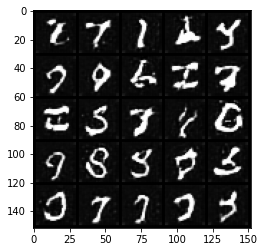

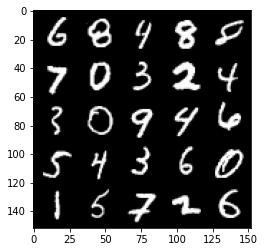

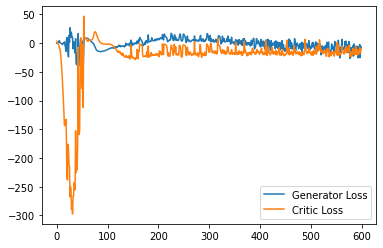

Step 12050: Generator loss: -12.023771032094956, critic loss: -14.474935876369477


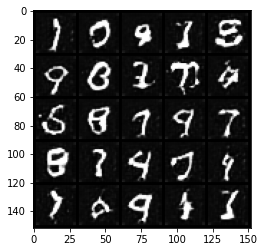

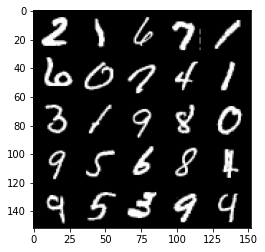

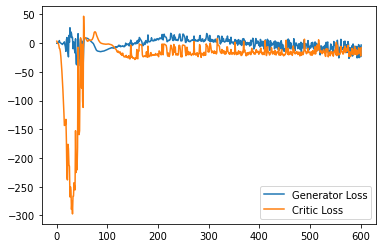

Step 12100: Generator loss: -18.919303463101386, critic loss: -18.75322608184814


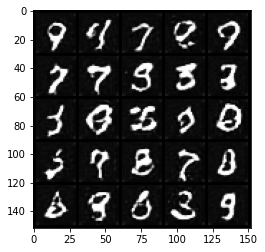

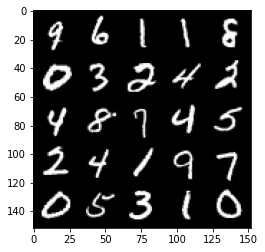

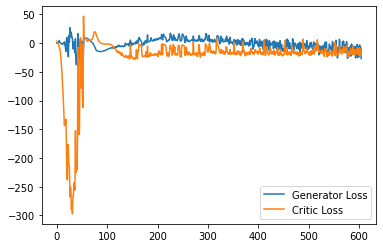

Step 12150: Generator loss: -15.581462728381156, critic loss: -14.026323868751529


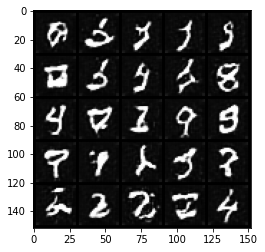

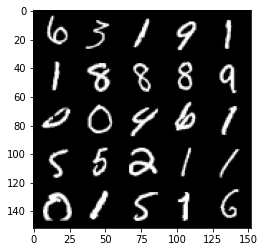

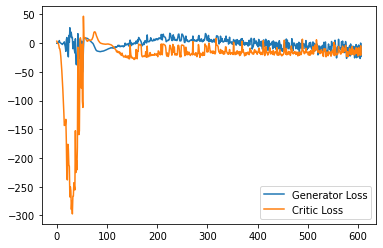

Step 12200: Generator loss: -13.883768880963325, critic loss: -15.210703604221349


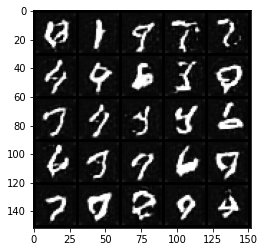

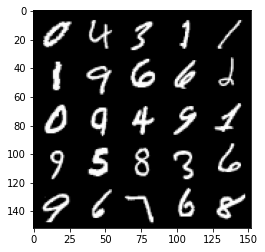

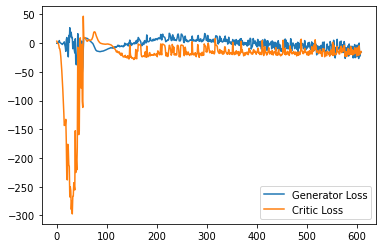

Step 12250: Generator loss: -9.135606248378753, critic loss: -12.576829693794243


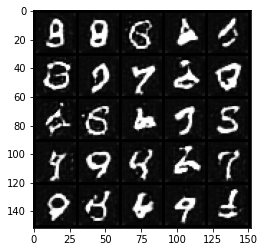

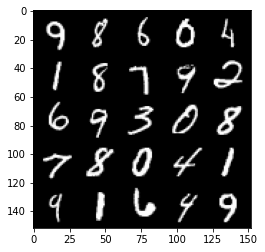

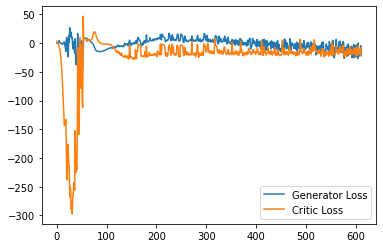

Step 12300: Generator loss: -16.039760979413987, critic loss: -11.771736917972564


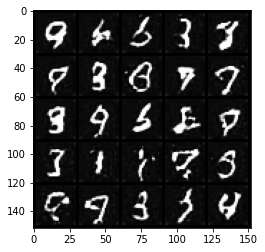

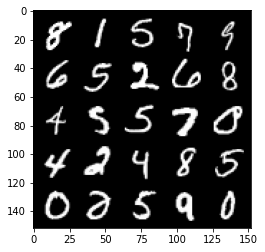

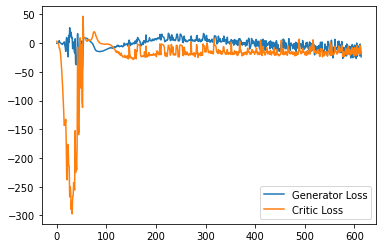

Step 12350: Generator loss: -12.613768327832222, critic loss: -15.494330494403835


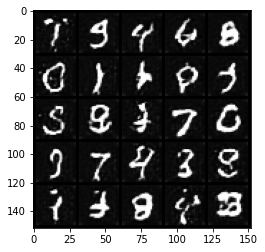

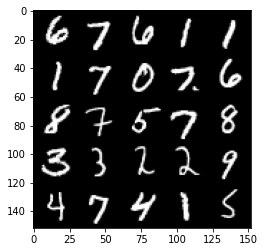

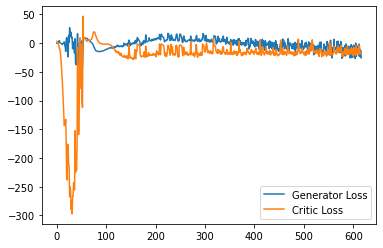

Step 12400: Generator loss: -12.011523766517639, critic loss: -9.742306141853332


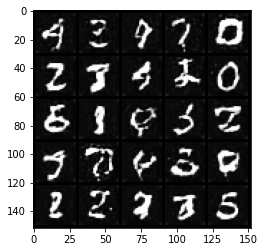

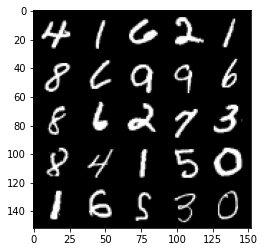

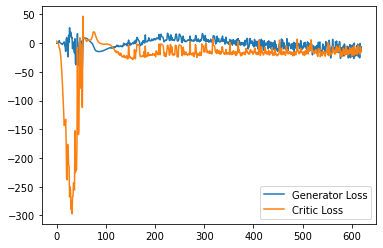

Step 12450: Generator loss: -21.24820669174194, critic loss: -19.672257771492006


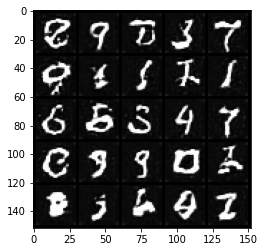

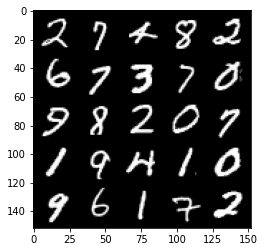

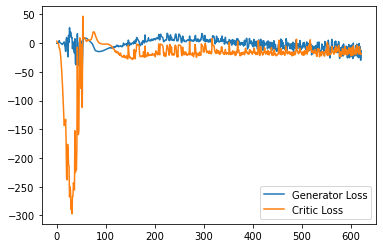

Step 12500: Generator loss: -14.604598710536957, critic loss: -14.414556212425232


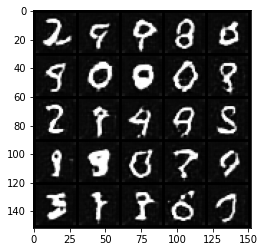

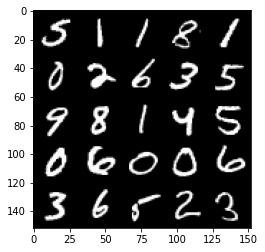

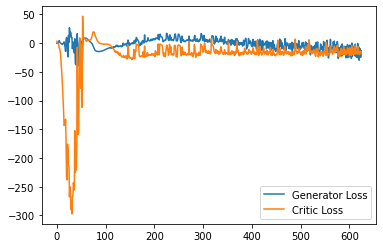

Step 12550: Generator loss: -19.42431332707405, critic loss: -17.057778024673464


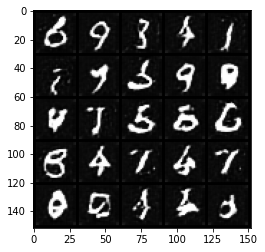

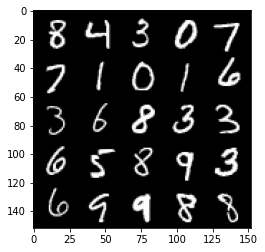

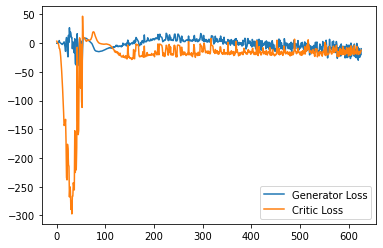

Step 12600: Generator loss: -25.927271037995816, critic loss: -22.994341512203214


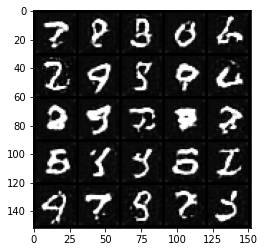

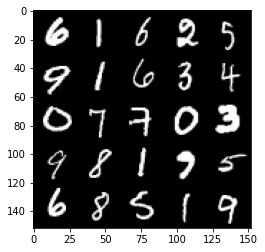

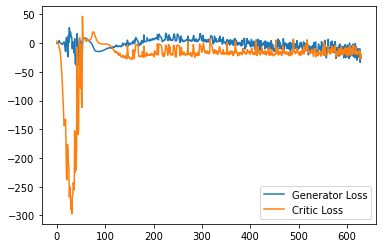

Step 12650: Generator loss: -16.38853186249733, critic loss: -17.983148735523226


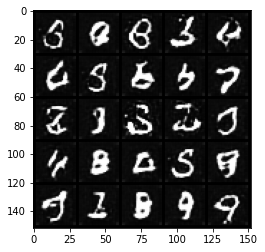

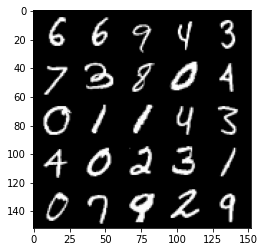

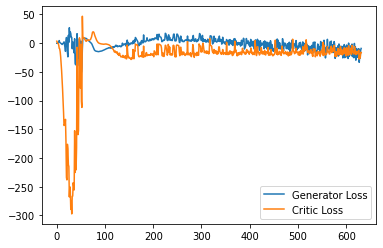

Step 12700: Generator loss: -17.740121616721154, critic loss: -16.514470932006834


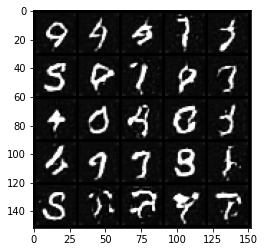

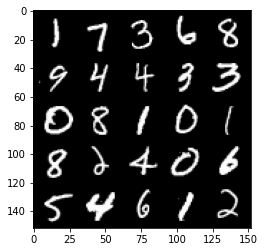

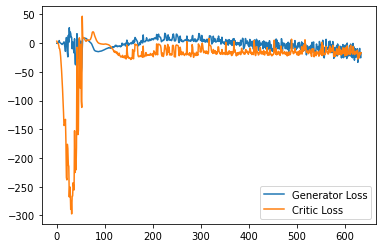

Step 12750: Generator loss: -16.09226147711277, critic loss: -9.37279469394684


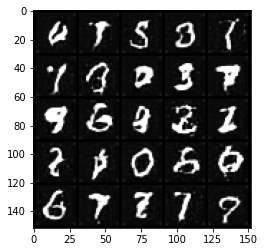

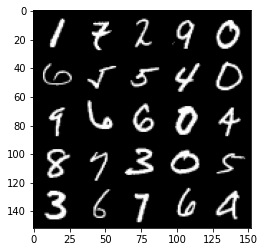

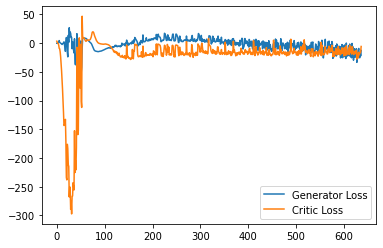

Step 12800: Generator loss: -26.78579538822174, critic loss: -19.885926795482636


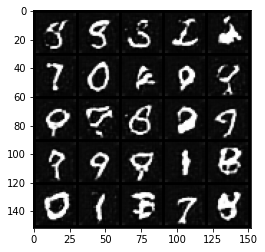

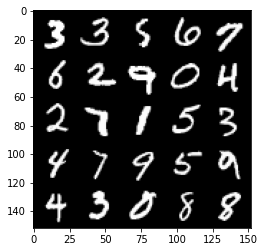

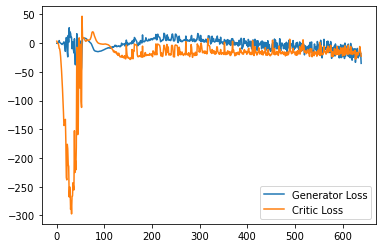

Step 12850: Generator loss: -18.09135601401329, critic loss: -18.332916087150576


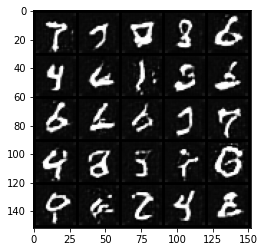

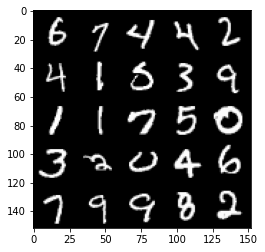

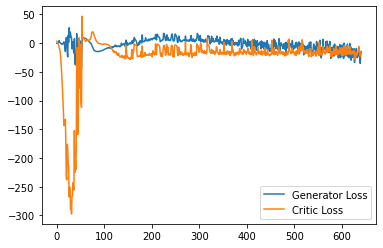

Step 12900: Generator loss: -20.506790290474893, critic loss: -16.172664999485022


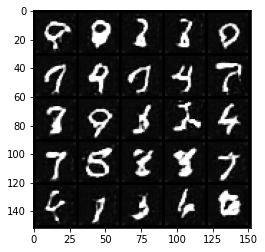

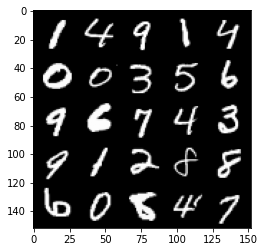

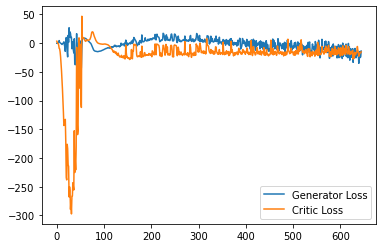

Step 12950: Generator loss: -14.543427459001542, critic loss: -13.683330500602723


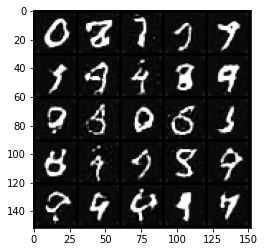

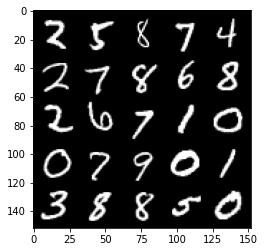

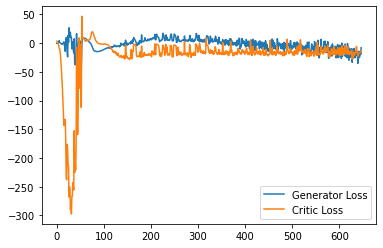

Step 13000: Generator loss: -16.250244534015657, critic loss: -13.213565468788145


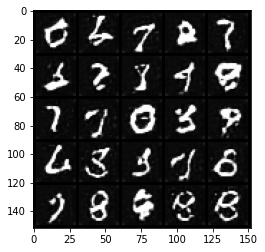

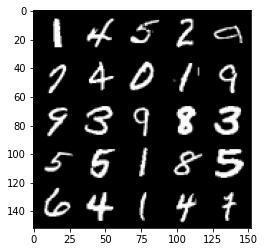

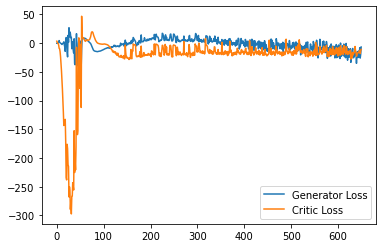

Step 13050: Generator loss: -20.207562266588212, critic loss: -16.15755254936219


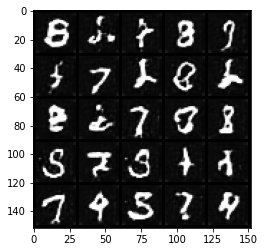

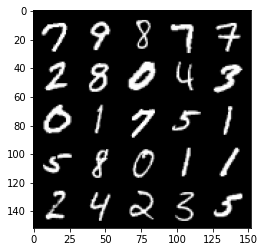

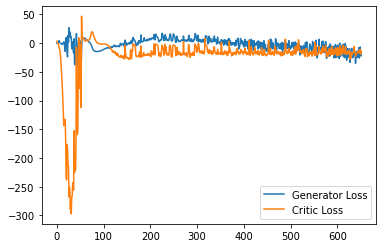

Step 13100: Generator loss: -25.096374893188475, critic loss: -19.10519448280335


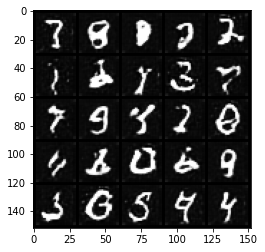

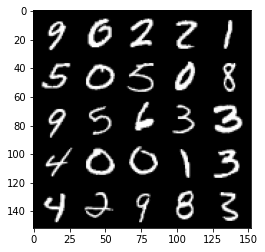

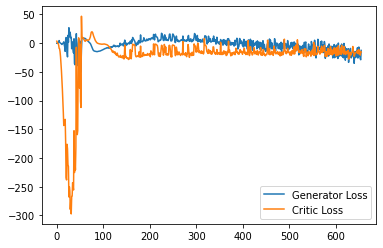

Step 13150: Generator loss: -30.03976208090782, critic loss: -19.194399541378022


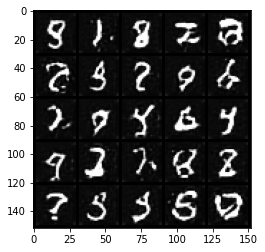

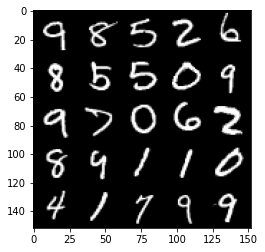

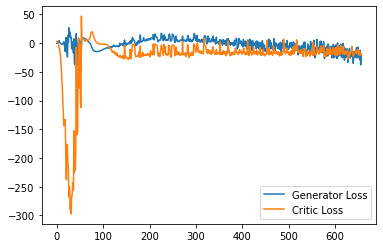

Step 13200: Generator loss: -17.752059841156004, critic loss: -18.968137938261027


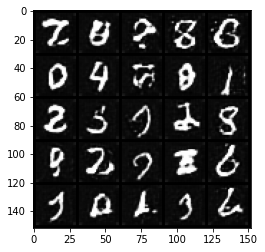

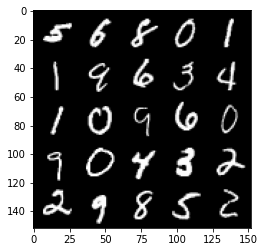

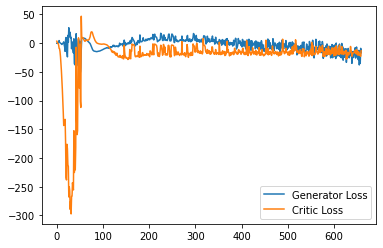

Step 13250: Generator loss: -23.179793695211412, critic loss: -17.91290394449234


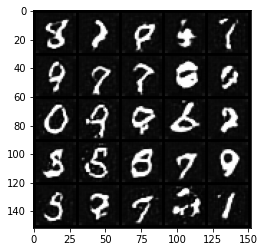

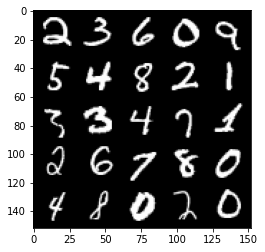

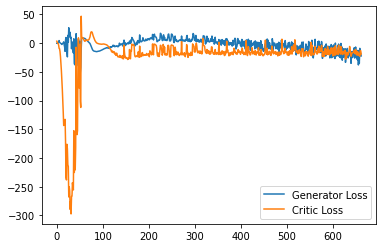

Step 13300: Generator loss: -17.24920787677169, critic loss: -13.89460815954208


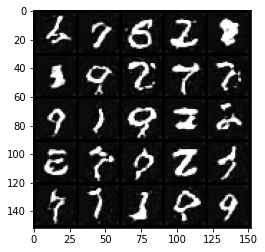

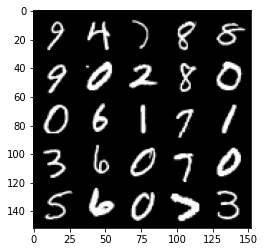

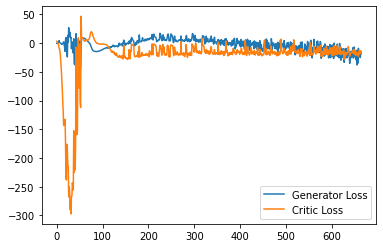

Step 13350: Generator loss: -23.56257537007332, critic loss: -17.45286805009842


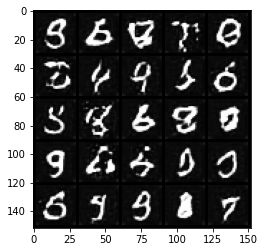

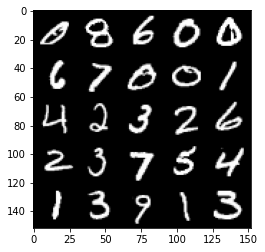

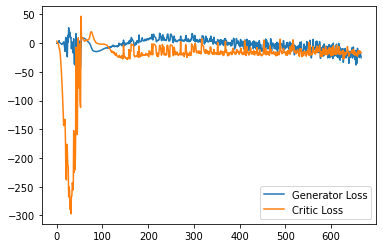

Step 13400: Generator loss: -18.25626757144928, critic loss: -18.565419689655307


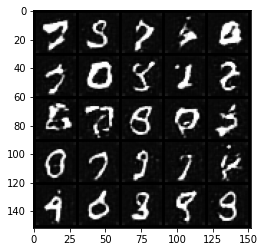

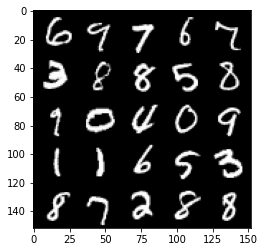

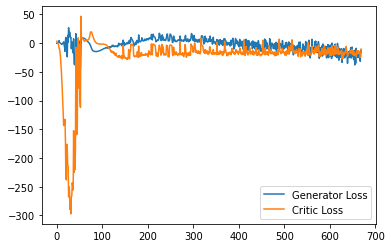

Step 13450: Generator loss: -25.301405048370363, critic loss: -13.937972989559173


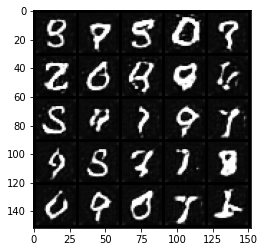

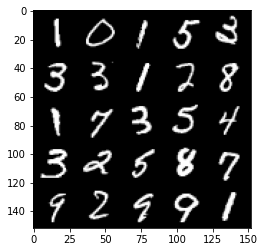

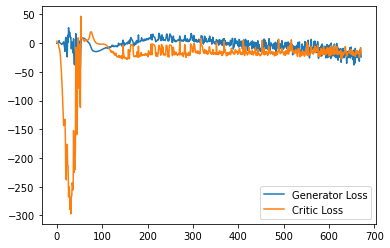

Step 13500: Generator loss: -20.487715665102005, critic loss: -13.954494122028354


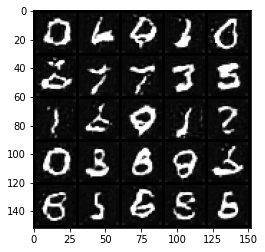

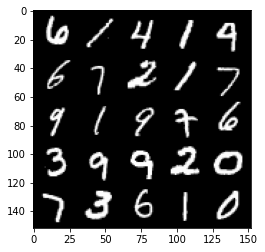

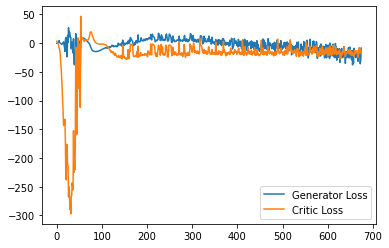

Step 13550: Generator loss: -16.318866033554077, critic loss: -11.170818703651433


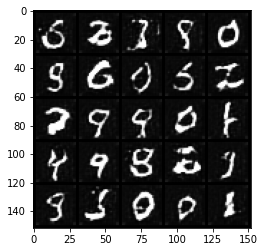

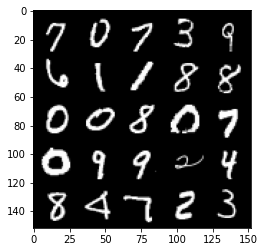

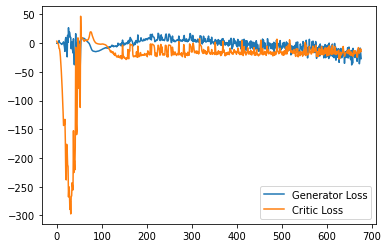

Step 13600: Generator loss: -27.511583187580108, critic loss: -15.104531199693684


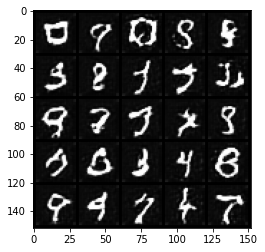

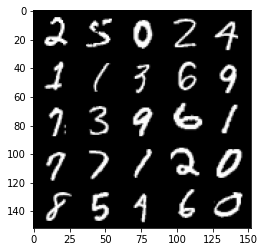

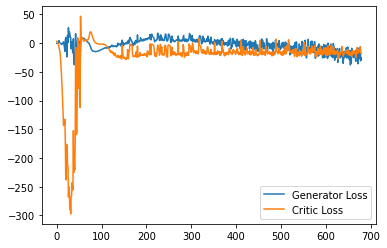

Step 13650: Generator loss: -18.251858983039856, critic loss: -16.376625055789948


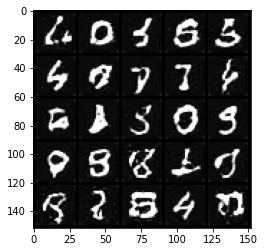

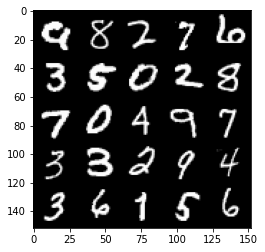

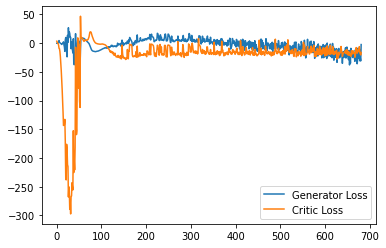

Step 13700: Generator loss: -30.379412640333175, critic loss: -19.50312676715851


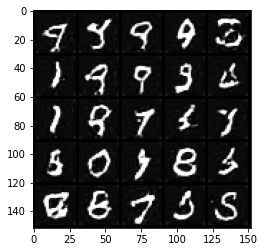

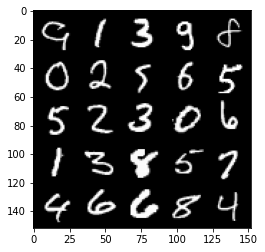

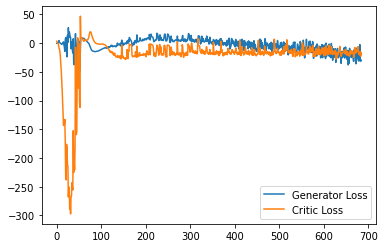

Step 13750: Generator loss: -20.180963310599328, critic loss: -18.322582865715034


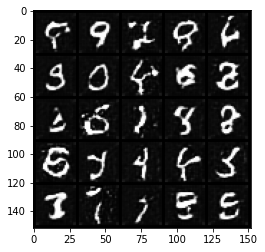

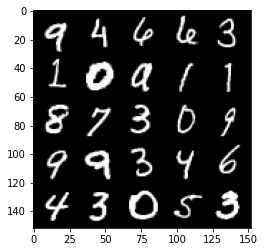

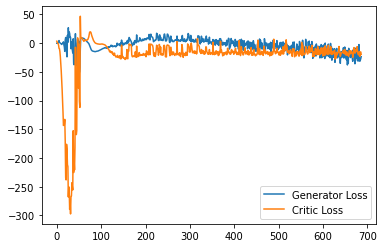

Step 13800: Generator loss: -22.6010486972332, critic loss: -13.315200796604161


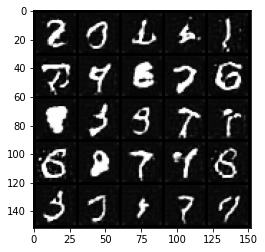

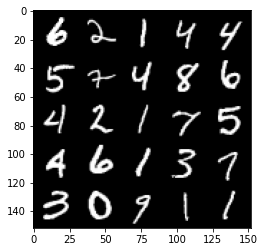

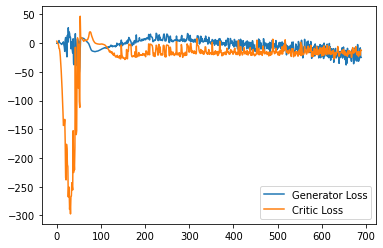

Step 13850: Generator loss: -22.86946928501129, critic loss: -13.738248989105225


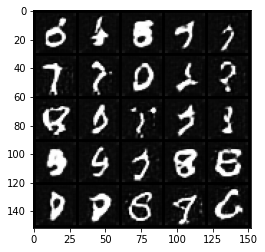

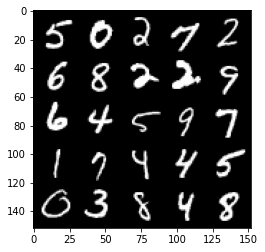

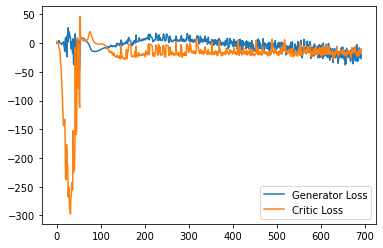

Step 13900: Generator loss: -20.40800500869751, critic loss: -4.512677310466766


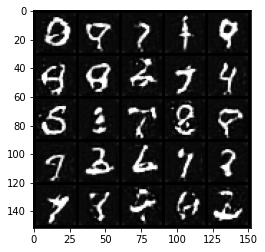

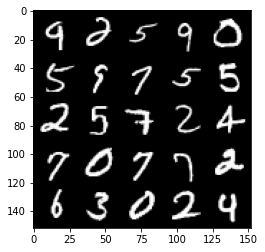

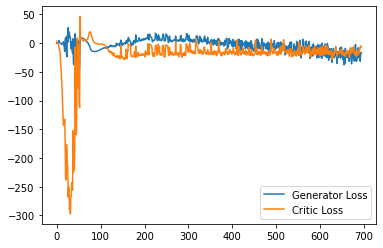

Step 13950: Generator loss: -23.223746256828306, critic loss: -17.2259879527092


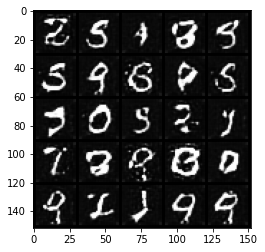

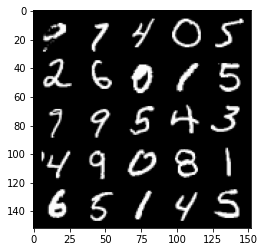

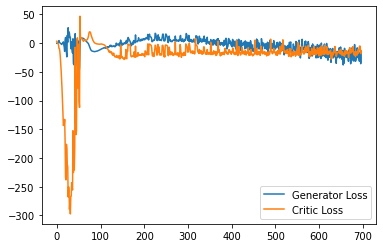

Step 14000: Generator loss: -23.20478700995445, critic loss: -16.10663709688187


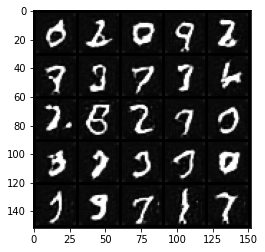

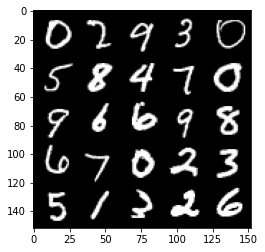

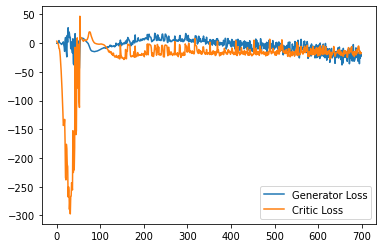

Step 14050: Generator loss: -29.257480885982513, critic loss: -17.613634908318524


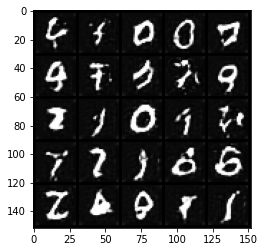

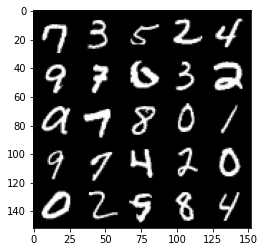

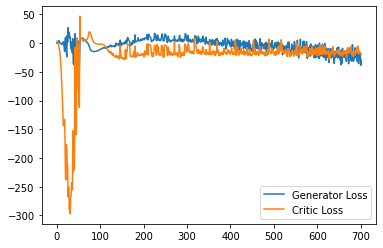

Step 14100: Generator loss: -33.81596311569214, critic loss: -23.477783208370212


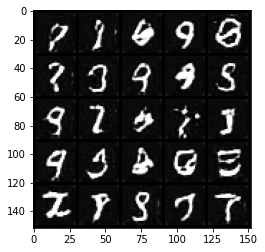

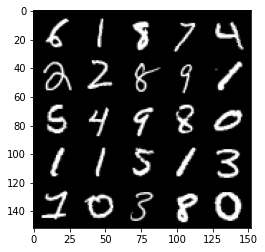

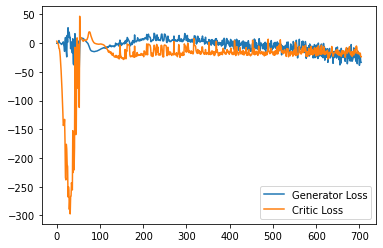

Step 14150: Generator loss: -24.406380093097688, critic loss: -7.697869264125825


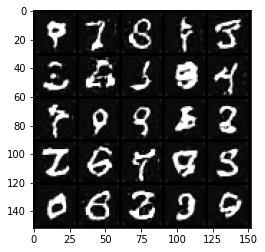

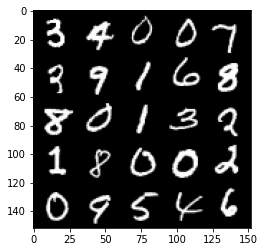

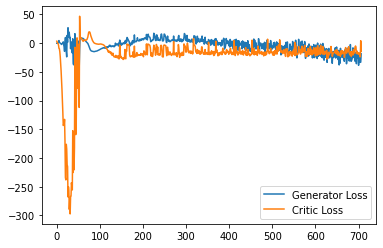

Step 14200: Generator loss: -25.99714708685875, critic loss: -20.426464589834218


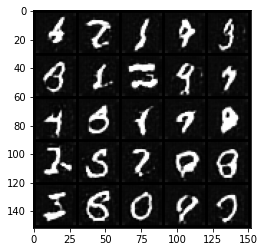

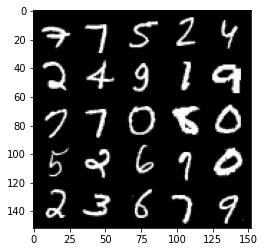

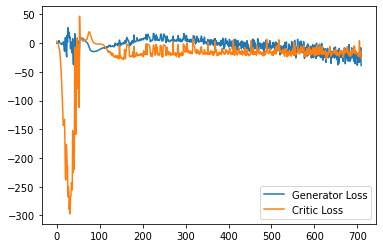

Step 14250: Generator loss: -20.46086652994156, critic loss: -14.667740210056303


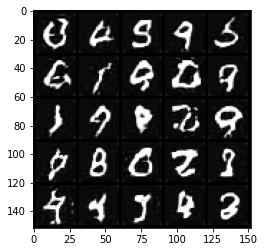

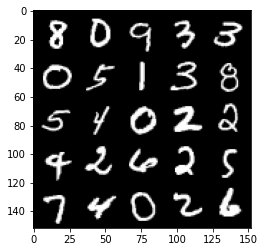

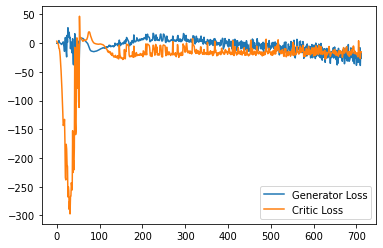

Step 14300: Generator loss: -26.494505236148836, critic loss: -17.944475150585173


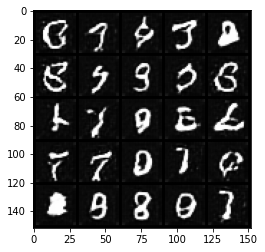

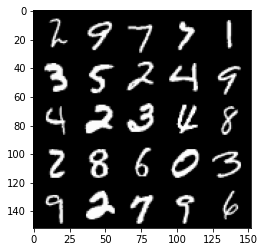

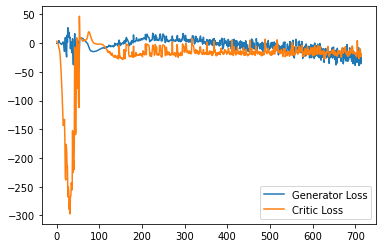

Step 14350: Generator loss: -30.853636698722838, critic loss: -18.143680592060086


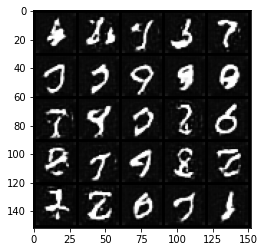

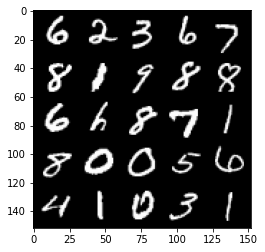

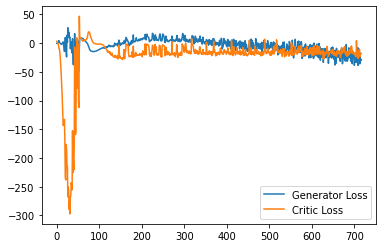

Step 14400: Generator loss: -21.32186680033803, critic loss: -17.16595317649841


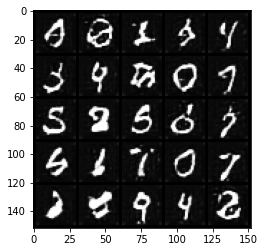

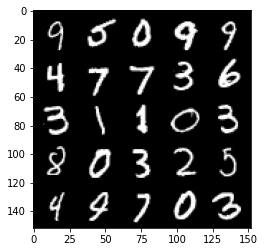

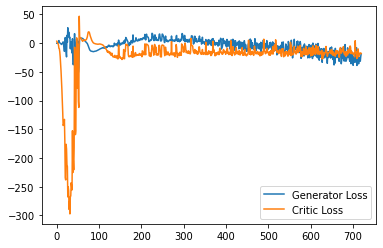

Step 14450: Generator loss: -26.591379232406616, critic loss: -14.869465669870381


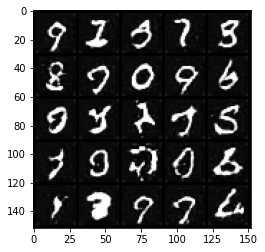

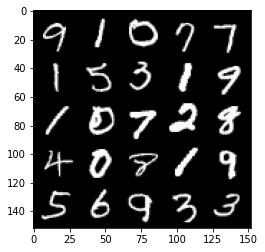

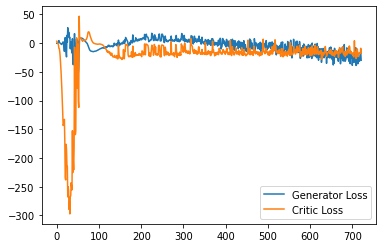

Step 14500: Generator loss: -20.75141305208206, critic loss: -17.054190130710598


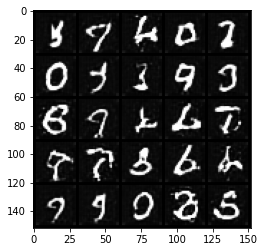

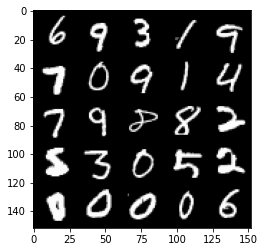

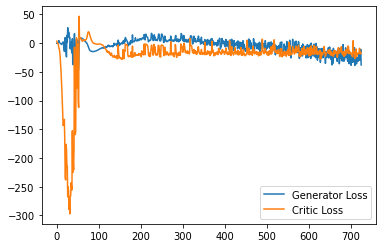

Step 14550: Generator loss: -24.53140182852745, critic loss: -19.40450773239136


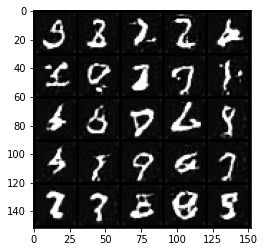

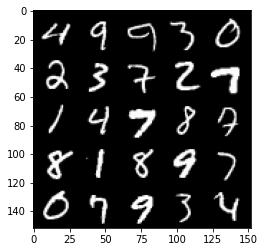

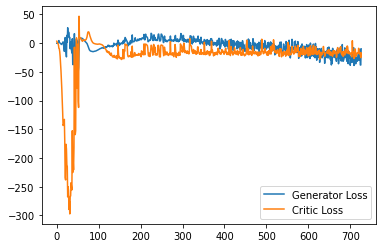

Step 14600: Generator loss: -21.825314936637877, critic loss: -16.89785360240936


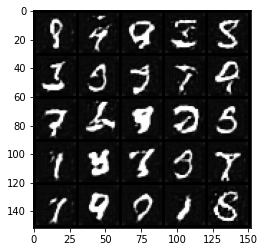

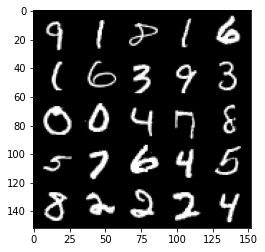

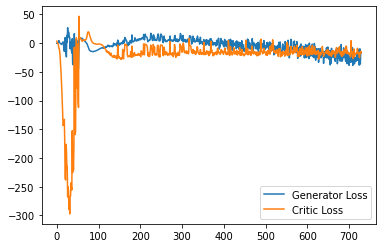

Step 14650: Generator loss: -22.22625060245395, critic loss: -11.679465635299685


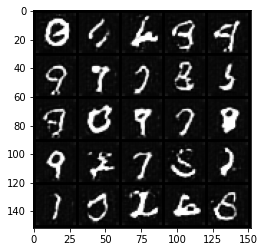

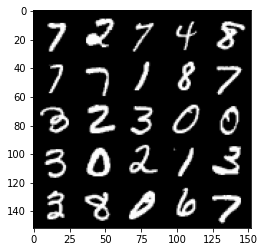

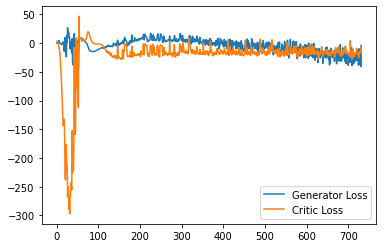

Step 14700: Generator loss: -21.106981506347655, critic loss: -14.230544446945192


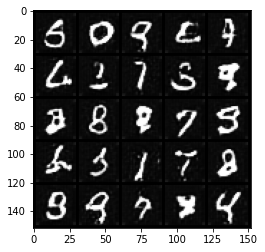

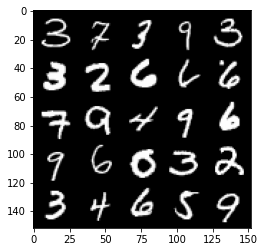

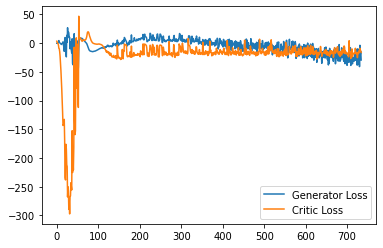

Step 14750: Generator loss: -20.69627786755562, critic loss: -15.603471517562866


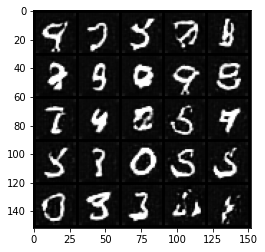

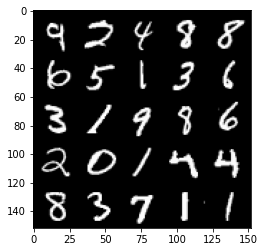

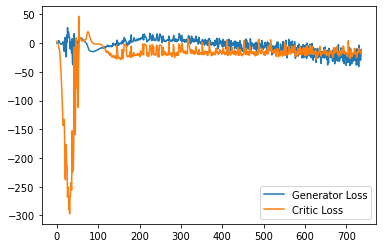

Step 14800: Generator loss: -21.00489354133606, critic loss: -16.40512039613724


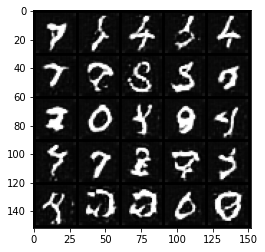

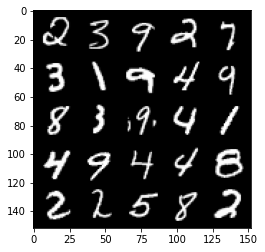

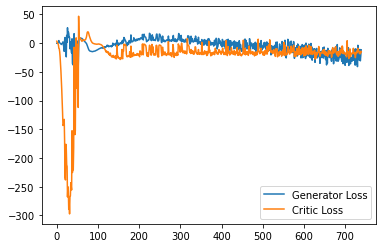

Step 14850: Generator loss: -38.17369262695313, critic loss: -25.676759678840632


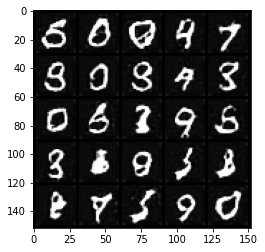

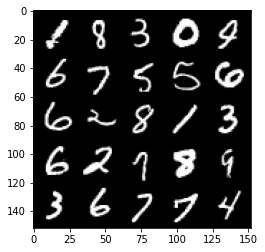

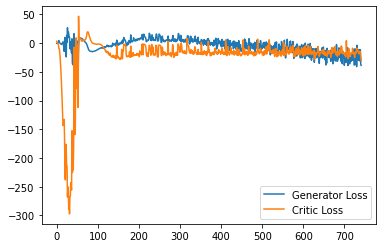

Step 14900: Generator loss: -29.93787467956543, critic loss: -19.86564028906822


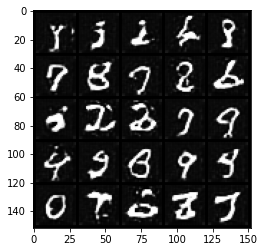

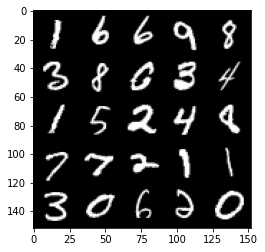

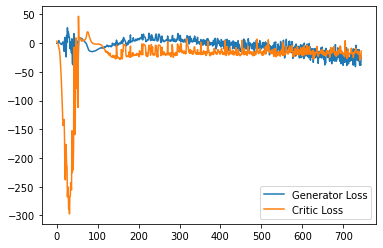

Step 14950: Generator loss: -28.851387519836425, critic loss: -20.32310086393356


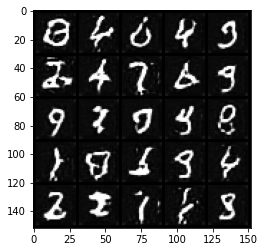

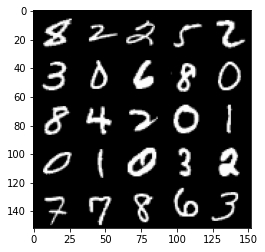

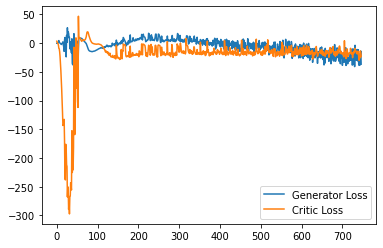

Step 15000: Generator loss: -10.863815434277058, critic loss: -12.583816843509675


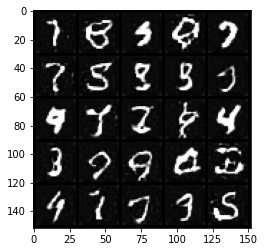

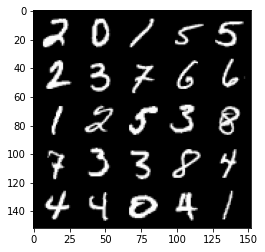

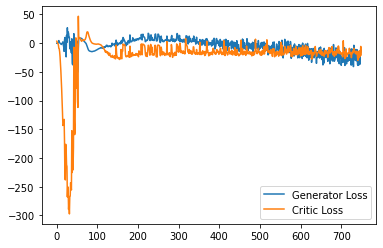

Step 15050: Generator loss: -25.2344452047348, critic loss: -16.077897421836852


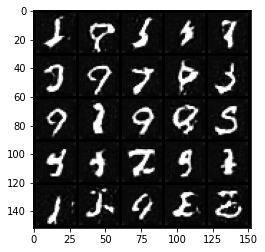

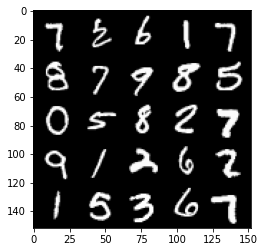

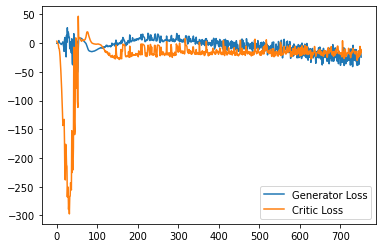

Step 15100: Generator loss: -26.53714386701584, critic loss: -19.947882585048674


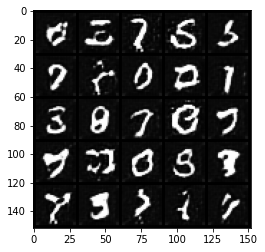

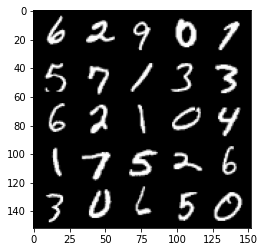

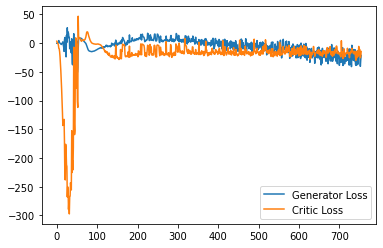

Step 15150: Generator loss: -15.878257018327712, critic loss: -12.273630111694338


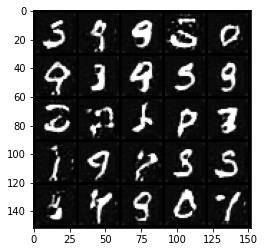

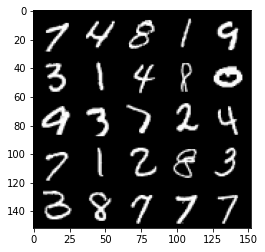

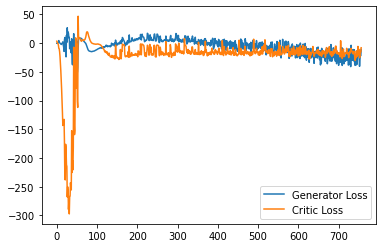

Step 15200: Generator loss: -24.92484206914902, critic loss: -12.3408608276844


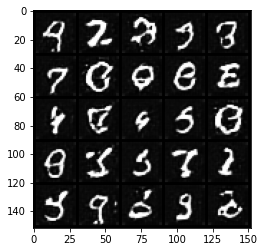

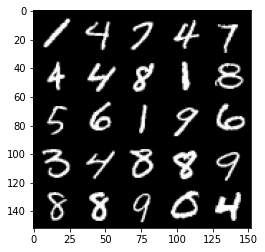

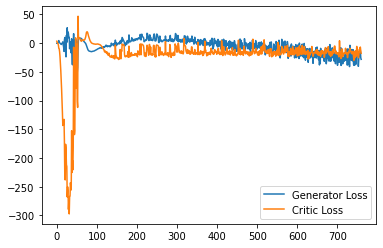

Step 15250: Generator loss: -22.104393850564957, critic loss: -16.878295915603637


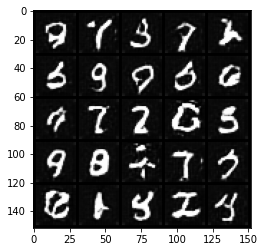

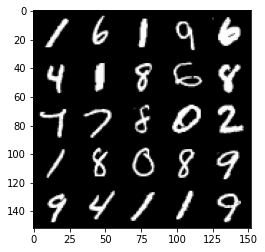

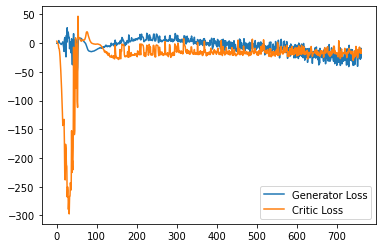

Step 15300: Generator loss: -23.002432765960695, critic loss: -16.708099042892457


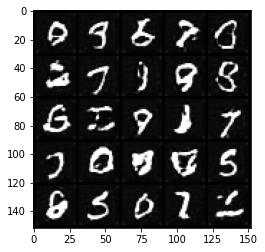

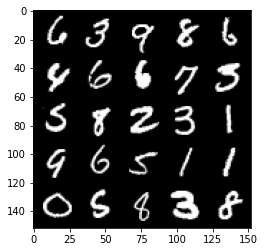

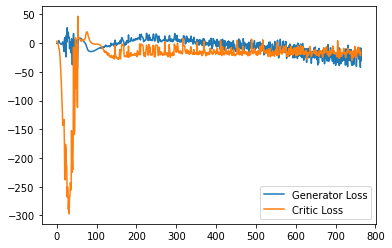

Step 15350: Generator loss: -33.9913736975193, critic loss: -19.685724380493166


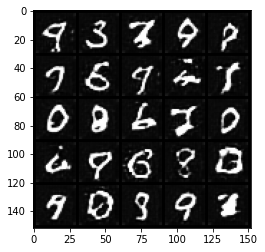

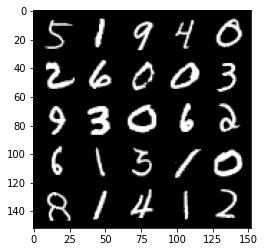

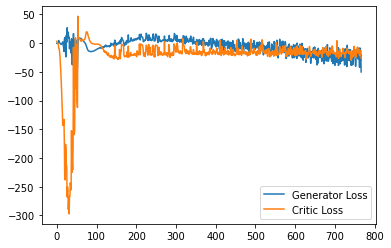

Step 15400: Generator loss: -34.68975787639618, critic loss: -24.533699751377114


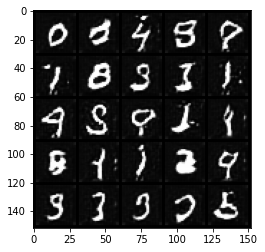

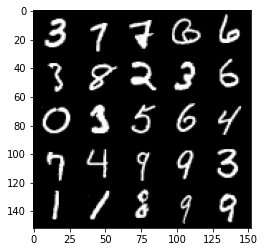

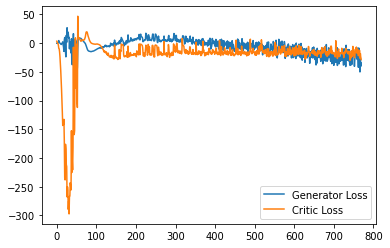

Step 15450: Generator loss: -15.881718891263008, critic loss: -16.92799828124047


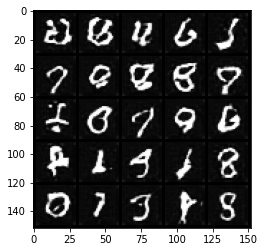

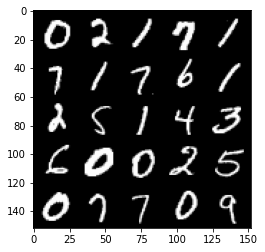

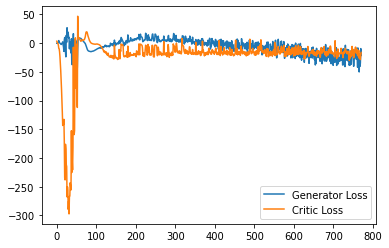

Step 15500: Generator loss: -29.833495087623596, critic loss: -19.701525623321533


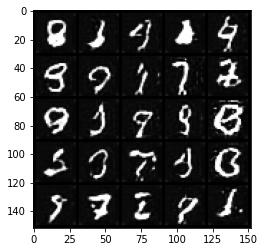

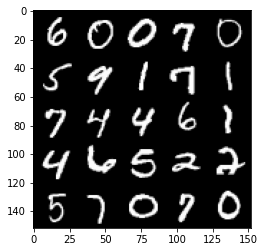

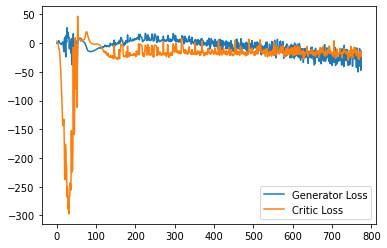

Step 15550: Generator loss: -30.468188667297362, critic loss: -18.673994665145873


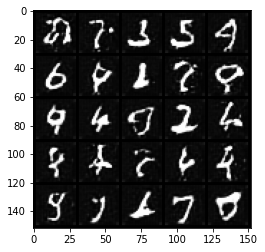

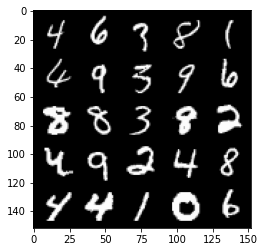

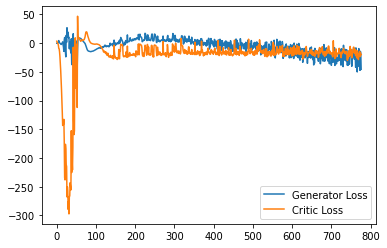

Step 15600: Generator loss: -37.04663487911225, critic loss: -13.79723238992691


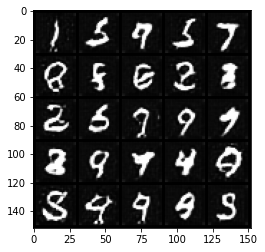

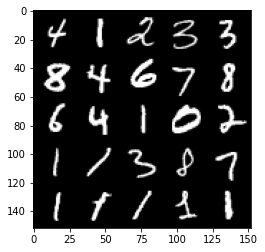

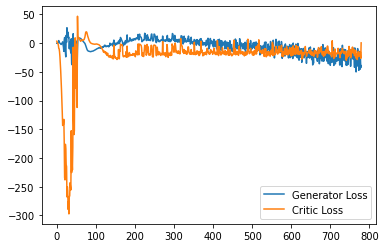

Step 15650: Generator loss: -30.241917238235473, critic loss: -25.95311484622955


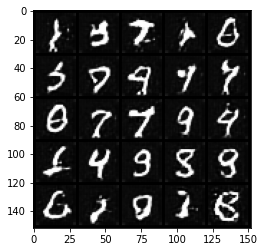

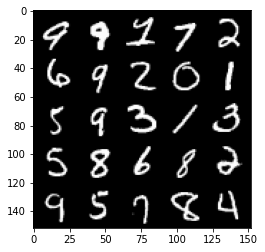

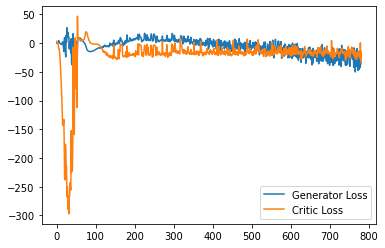

In [ ]:
import matplotlib.pyplot as plt

cur_step = 0
generator_losses = []
critic_losses = []
for epoch in range(n_epochs):
    # Dataloader returns the batches
    for real, _ in tqdm(dataloader):
        cur_batch_size = len(real)
        real = real.to(device)

        mean_iteration_critic_loss = 0
        for _ in range(crit_repeats):
            ### Update critic ###
            crit_opt.zero_grad()
            fake_noise = get_noise(cur_batch_size, z_dim, device=device)
            fake = gen(fake_noise)
            crit_fake_pred = crit(fake.detach())
            crit_real_pred = crit(real)

            epsilon = torch.rand(len(real), 1, 1, 1, device=device, requires_grad=True)
            gradient = get_gradient(crit, real, fake.detach(), epsilon)
            gp = gradient_penalty(gradient)
            crit_loss = get_crit_loss(crit_fake_pred, crit_real_pred, gp, c_lambda)

            # Keep track of the average critic loss in this batch
            mean_iteration_critic_loss += crit_loss.item() / crit_repeats
            # Update gradients
            crit_loss.backward(retain_graph=True)
            # Update optimizer
            crit_opt.step()
        critic_losses += [mean_iteration_critic_loss]

        ### Update generator ###
        gen_opt.zero_grad()
        fake_noise_2 = get_noise(cur_batch_size, z_dim, device=device)
        fake_2 = gen(fake_noise_2)
        crit_fake_pred = crit(fake_2)
        
        gen_loss = get_gen_loss(crit_fake_pred)
        gen_loss.backward()

        # Update the weights
        gen_opt.step()

        # Keep track of the average generator loss
        generator_losses += [gen_loss.item()]

        ### Visualization code ###
        if cur_step % display_step == 0 and cur_step > 0:
            gen_mean = sum(generator_losses[-display_step:]) / display_step
            crit_mean = sum(critic_losses[-display_step:]) / display_step
            print(f"Step {cur_step}: Generator loss: {gen_mean}, critic loss: {crit_mean}")
            show_tensor_images(fake)
            show_tensor_images(real)
            step_bins = 20
            num_examples = (len(generator_losses) // step_bins) * step_bins
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(generator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Generator Loss"
            )
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(critic_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Critic Loss"
            )
            plt.legend()
            plt.show()

        cur_step += 1
